The data for the following section consists of a single section from a tumor microarray block with several lung bronchi that were profiled using both 10X Xenium and the Akoya phenocycler. We will be looking at region 1 and 7 based on the xenium outputs for the following analysis.

In [4]:
# setup
library(Giotto)

# data paths
data_path <- '/hive/hubmap/data/public/spatial-data-workshop/TMA2'
xen_dir <- file.path(data_path, "xenium")
pheno_dir <- file.path(data_path, "phenocycler")

# xenium region paths
xen1_path <- list.files(xen_dir, full.names = T, pattern = "Region_1_")
xen7_path <- list.files(xen_dir, full.names = T, pattern = "Region_7_")

# output paths
output_dir <- "session3_outputs"
output_plot_dir <- file.path(output_dir, "plots")

In [5]:
# link a python path
python_path <- "/root/.local/share/r-miniconda/envs/giotto_env/bin/python"
set_giotto_python_path(python_path)

# setup instructions for outputs
instrs <- createGiottoInstructions(
    save_dir = output_plot_dir,
    save_plot = TRUE,
    return_plot = FALSE,
    show_plot = TRUE
)

a python path has been provided

Using python path:
 "/root/.local/share/r-miniconda/envs/giotto_env/bin/python"



[1] "/root/.local/share/r-miniconda/envs/giotto_env/bin/python"

python already initialized in this session
 active environment : 'giotto_env'
 python version : 3.10



# Xenium Data
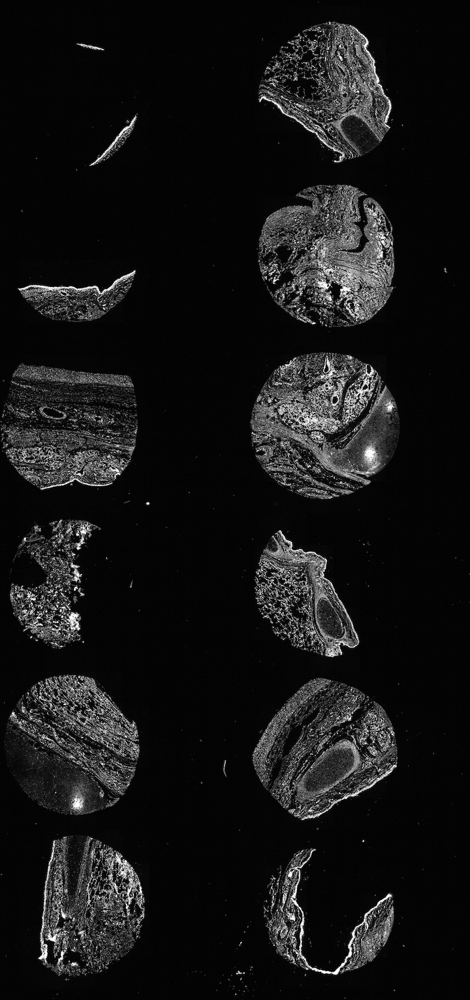

Xenium captures individual transcript detections with a spatial resolution of 100s of nanometers, providing an extremely highly resolved subcellular spatial dataset.
This dataset contains 14,168 cells profiled across a panel of 312 probes.

## Xenium-specific packages
When working with this data and trying to open the parquet files, you will need arrow built with ZTSD compression support.
For this workshop, these are all already installed.

Can be checked and installed with:
### arrow + zstd
```
has_arrow <- requireNamespace("arrow", quietly = TRUE)
zstd <- TRUE
if (has_arrow) {
    # check arrow_info() to see that zstd support should be TRUE
    # See https://arrow.apache.org/docs/r/articles/install.html for details
    zstd <- arrow::arrow_info()$capabilities[["zstd"]]
}
if (!has_arrow || !zstd) {
    # install with compression library needed for 10x parquet files
    # this may take a while
    Sys.setenv(ARROW_WITH_ZSTD = "ON")
    install.packages("arrow", repos = c("https://apache.r-universe.dev"), type = "source")
}
```
### tifffile and imagecodecs
Python packages needed for Xenium that are not standard installed into the Giotto python environment are {tifffile} and {imagecodecs}
```
# install packages if not already installed in environment
need_py_inst <- try(GiottoUtils::package_check(
    pkg_name = c("tifffile", "imagecodecs"), repository = c("pip:tifffile", "pip:imagecodecs")
), silent = TRUE)
if (!isTRUE(need_py_inst)) {
    active_env <- GiottoUtils::py_active_env()
    reticulate::conda_install(
        envname = active_env, packages = c("tifffile", "imagecodecs"), pip = TRUE
    )
    # may need a session restart after installation
}
```

## Loading Xenium Dataset

```
    ├── analysis.tar.gz
    ├── analysis.zarr.zip
    ├── analysis_summary.html
    ├── aux_outputs.tar.gz
    ├── transcripts.csv.gz
    ├── transcripts.parquet
    ├── transcripts.zarr.zip
    ├── cell_boundaries.csv.gz
    ├── cell_boundaries.parquet
    ├── nucleus_boundaries.csv.gz
    ├── nucleus_boundaries.parquet
    ├── cell_feature_matrix.tar.gz
    ├── cell_feature_matrix
    │   ├── barcodes.tsv.gz
    │   ├── features.tsv.gz
    │   └── matrix.mtx.gz
    ├── cell_feature_matrix.h5
    ├── cell_feature_matrix.zarr.zip
    ├── cells.csv.gz
    ├── cells.parquet
    ├── cells.zarr.zip
    ├── experiment.xenium
    ├── gene_panel.json
    ├── metrics_summary.csv
    ├── morphology.ome.tif
    ├── morphology_focus
    └── morphology_focus.ome.tif
```

_Normally a simple call to `xen1 <- createGiottoXeniumObject(xen1_path, instructions = instrs)` is enough, but this generates a cached .tif image into a subidrectory of the data.
We do not have permissions to do this, so instead we can use a mix of the basic convenience fun + the importer_.

The main things that we need for Xenium analysis are the polygons, points, and image.

The transcript points contain several types of detections, which we can split into feature types via `feat_type` and `split_keyword`.

This include:

- 'rna': The transcripts contained within the gene panel for the assay
- 'UnassignedCodeword': Barcodes that couldn't be assigned confidently to a gene in the panel
- 'NegControlCodeword': Barcode that is associated with a negative control probe
- 'NegControlProbe': Non-binding probe used to distinguish true signal from noise
- 'DeprecatedCodeword': Barcode that was previously used but no longer in use

All the transcript detections in the dataset have an associated `qv` value that is similar to a phred score.

These are calculated using some of the control probes shown above.

The default cutoff for `qv` is 20, based on 10X genomics, and transcripts lower than that will be removed during load.

Note that if a different `qv` threshold is selected, then loaded transcripts will be different from the pre-made expression matrices that 10x provides.

In [6]:
# load data needed other than the image (transcript detections, polgyons)
xen1 <- createGiottoXeniumObject(xen1_path,
    feat_type = c(
        "rna",
        "NegControlProbe",
        "UnassignedCodeword",
        "NegControlCodeword",
        "DeprecatedCodeword" # new
    ),
    split_keyword = list(
        "NegControlProbe",
        "UnassignedCodeword",
        "NegControlCodeword",
        "DeprecatedCodeword" # new
    ),
    load_images = NULL,
    instructions = instrs
)

Loading transcript level info...

QV cutoff: 20.000000
 Feature points removed: 141742, out of 1044541

Loading boundary info 'cell'

Warning message in `[.data.table`(spatial_info, , `:=`((part_col), NULL)):
“Tried to assign NULL to column 'label_id', but this column does not exist to remove”
Loading boundary info 'nucleus'

Warning message in `[.data.table`(spatial_info, , `:=`((part_col), NULL)):
“Tried to assign NULL to column 'label_id', but this column does not exist to remove”
Loading feature metadata...

calculating centroids

done



In [7]:
# we still need to load in the morphology_focus image (dapi created during the Xenium run)
# create a Xenium Reader instance for lower level access to import process
x <- importXenium(xen1_path)

In [8]:
x

Giotto <XeniumReader>
dir       : /hive/hubmap/da[...]_0021229__Region_1__20240319__210701 
qv_cutoff : 20 
filetype  : transcripts -- parquet
            boundaries  -- parquet
            expression  -- h5
            cell_meta   -- parquet
funs      : load_transcripts()
            load_polys()
            load_cellmeta()
            load_featmeta()
            load_expression()
            load_image()
            load_aligned_image()
            create_gobject()

loading image as 'image'



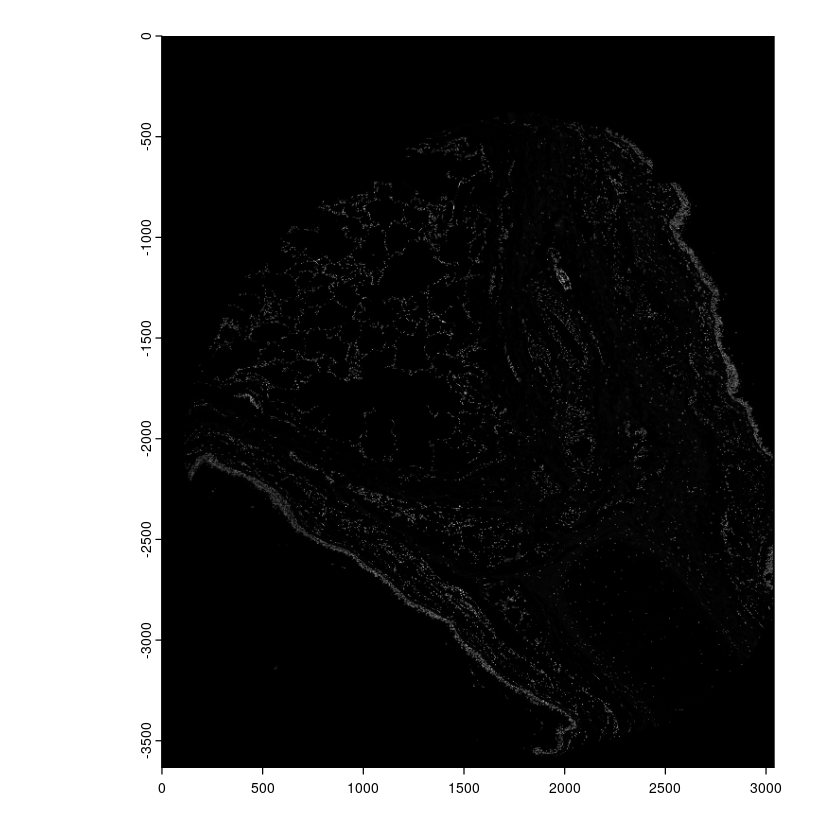

In [9]:
# load in image
dapi1 <- x$load_image(output_dir = file.path(output_dir, "tif_exports", "region1"))
plot(dapi1[[1]])

In [10]:
# append image to gobject
xen1 <- setGiotto(xen1, dapi1)

There are many other items that you can try loading in here.
The functions in the importer are low level functions that let you pull only that piece of data from the Xenium experiment.

The other items accessible with `$` operator are for applying settings that affect how the importer functions work.

In [11]:
# try loading cell metadata
x$load_cellmeta()

Loading 10X cell metadata...



An object of class cellMetaObj 
spat_unit : "cell"
feat_type : "rna"
provenance: cell 
dimensions: 14168 9 

      cell_ID transcript_counts control_probe_counts control_codeword_counts
       <char>             <int>                <int>                   <int>
1: aaaaicnd-1               109                    0                       0
2: aaaiciie-1                51                    0                       0
3: aaaodfkf-1                53                    0                       0
   unassigned_codeword_counts deprecated_codeword_counts total_counts cell_area
                        <int>                      <int>        <int>     <num>
1:                          0                          0          109  327.1119
2:                          0                          0           51  360.7081
3:                          0                          0           53  158.5436
   nucleus_area
          <num>
1:      9.03125
2:     32.73828
3:     31.56422

In [12]:
# or the pre-made expressionn information
x$filetype$expression <- "mtx" # switch to reading matrix market formats (HDF5 is throwing accessibility error)
x$load_expression()

Loading 10x pre-aggregated expression...



[[1]]
An object of class exprObj : "raw"
spat_unit : "cell"
feat_type : "rna"
provenance: cell 

contains:
289 x 14168 sparse Matrix of class "dgTMatrix"
                                      
ACE   . . . . . . . . . . . . . ......
ACE2  . . . . . . . . . . . . . ......
ACKR1 . . . . . . . . . . . 1 3 ......

 ........suppressing 14155 columns and 283 rows 
                                     
WFS1 . . 1 . . . . 1 . . . . . ......
WNT2 . . . . . . . . . . . . . ......
WT1  . . . . . . . . . . . . . ......

 First four colnames:
 aaaaicnd-1 aaaiciie-1 aaaodfkf-1
 aaapljnn-1 

[[2]]
An object of class exprObj : "raw"
spat_unit : "cell"
feat_type : "NegControlProbe"
provenance: cell 

contains:
12 x 14168 sparse Matrix of class "dgTMatrix"
                                                      
NegControlProbe_00042 . . . . . . . . . . . . . ......
NegControlProbe_00034 . . . . . . . . . . . . . ......
NegControlProbe_00033 . . . . . . . . . . . . . ......

 ........suppressing 14155 colu

In [13]:
# overview of object contents (for a default load)
xen1

An object of class giotto 
>Active spat_unit:  cell 
>Active feat_type:  rna 
dimensions    : 289, 14168 (features, cells)
[SUBCELLULAR INFO]
polygons      : cell nucleus 
features      : rna NegControlProbe UnassignedCodeword NegControlCodeword DeprecatedCodeword 
[AGGREGATE INFO]
spatial locations ----------------
  [cell] raw
  [nucleus] raw
attached images ------------------
images      : image 


Use objHistory() to see steps and params used

There are 2 sets of polys in a xenium dataset. The `cell` and `nucleus`.

## Giotto's geometry classes

`giottoPolygon` and `giottoPoints` are built on top of {terra} `SpatVector` structures

Useful tools:

- `[]` drop to `SpatVector`
- `ext()`
- `plot()` methods that hook into terra's additive plotting
- `[i]` subsets on cell_ID and feat_ID
- spatial transforms
  - `spin()`
  - `spatShift()`
  - `t()`
  - `flip()`
  - `shear()`
  - `affine()`
- `buffer()`
- hull functions
- `relate()`
- `terra::geomtype()`
- `as.data.table()`
- `area()`

General Giotto S4 subobject schema
- `objName()`
- `spatUnit()`
- `featType()`
- `spatIDs()`
- `featIDs()`
- `setGiotto()`

In [14]:
# extract polygon information as a list
polys <- xen1[["spatial_info",]]
cell_polys <- polys[[1]]
nuc_polys <- polys[[2]]

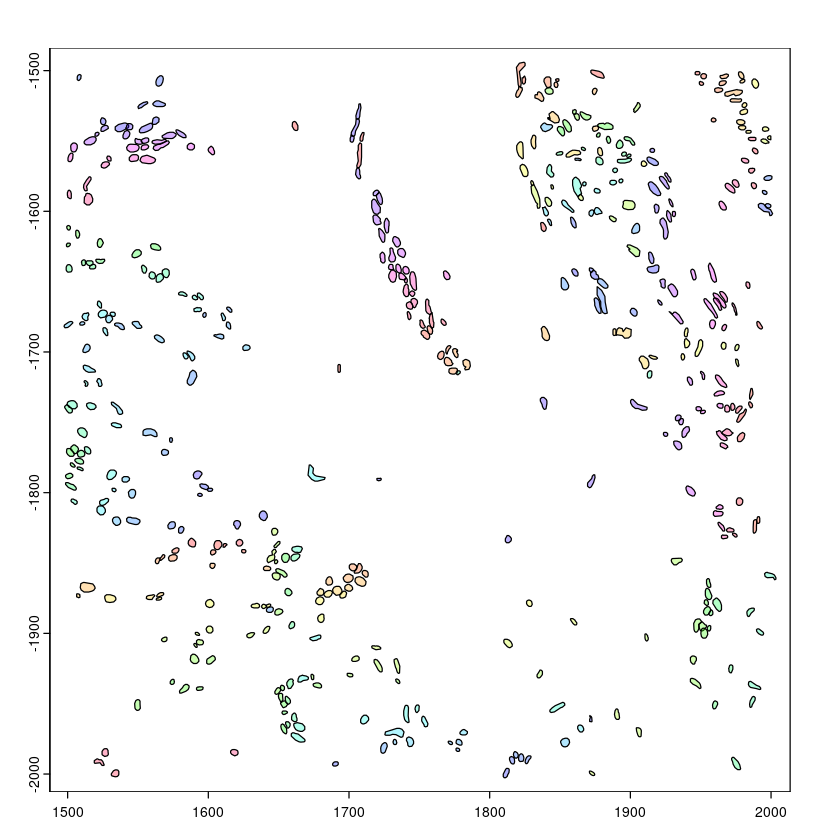

In [15]:
nuc_polys |>
    crop(c(1500, 2000, -2000, -1500)) |>
    plot(col = rainbow(100), alpha = 0.3)

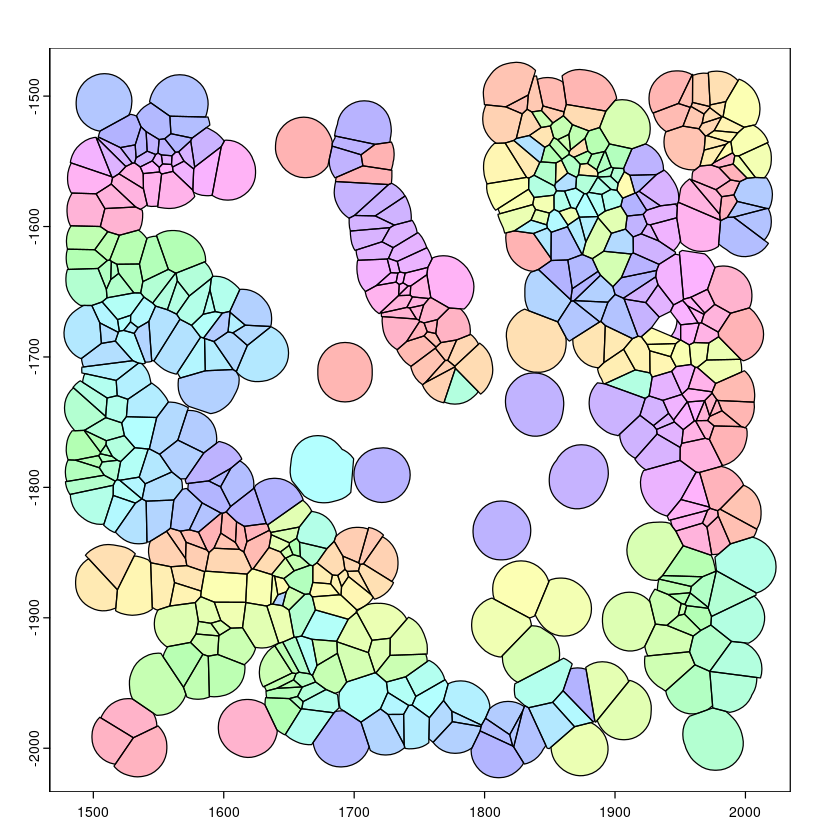

In [16]:
# single buffer of 20
nuc_polys |>
    crop(c(1500, 2000, -2000, -1500)) |>
    buffer(20) |>
    plot(col = rainbow(100), alpha = 0.3)

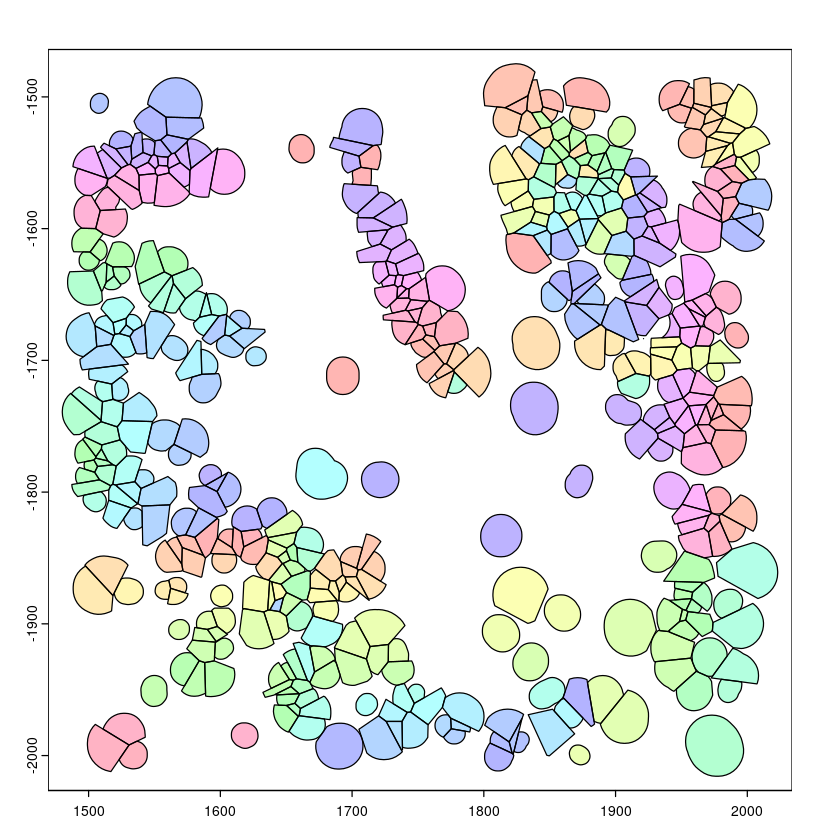

In [17]:
# variable size buffering
nuc_polys |>
    crop(c(1500, 2000, -2000, -1500)) |>
    buffer(sample(seq(from = 5, to = 20, length.out = nrow(nuc_polys)))) |>
    plot(col = rainbow(100), alpha = 0.3)

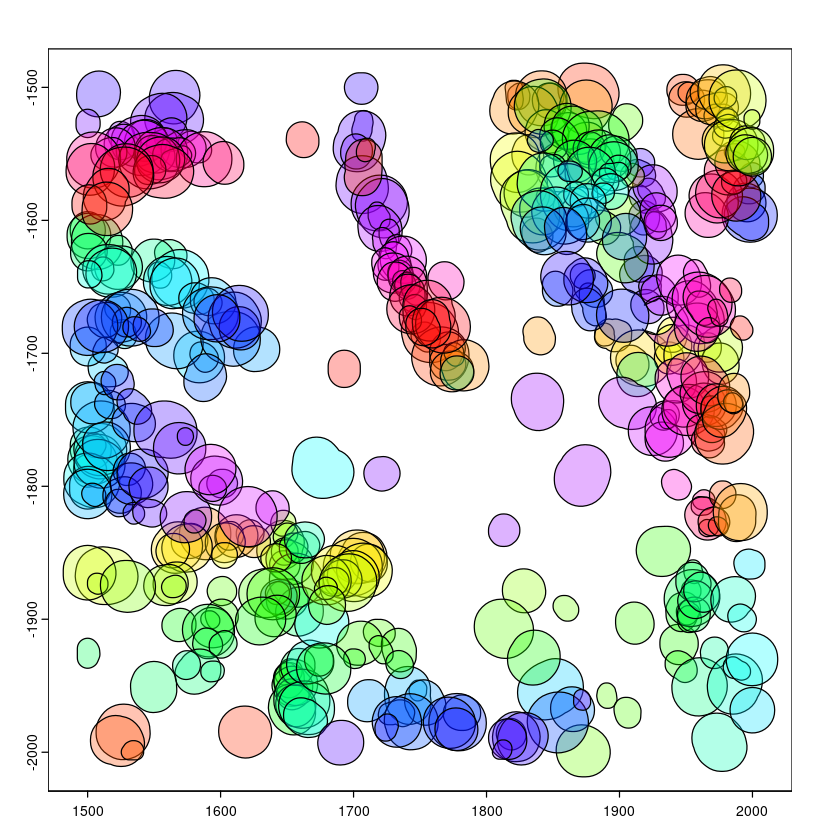

In [18]:
# settle is Giotto specific
nuc_polys[] |>
    crop(c(1500, 2000, -2000, -1500)) |>
    buffer(sample(seq(from = 5, to = 20, length.out = nrow(nuc_polys)))) |>
    plot(col = rainbow(100), alpha = 0.3)

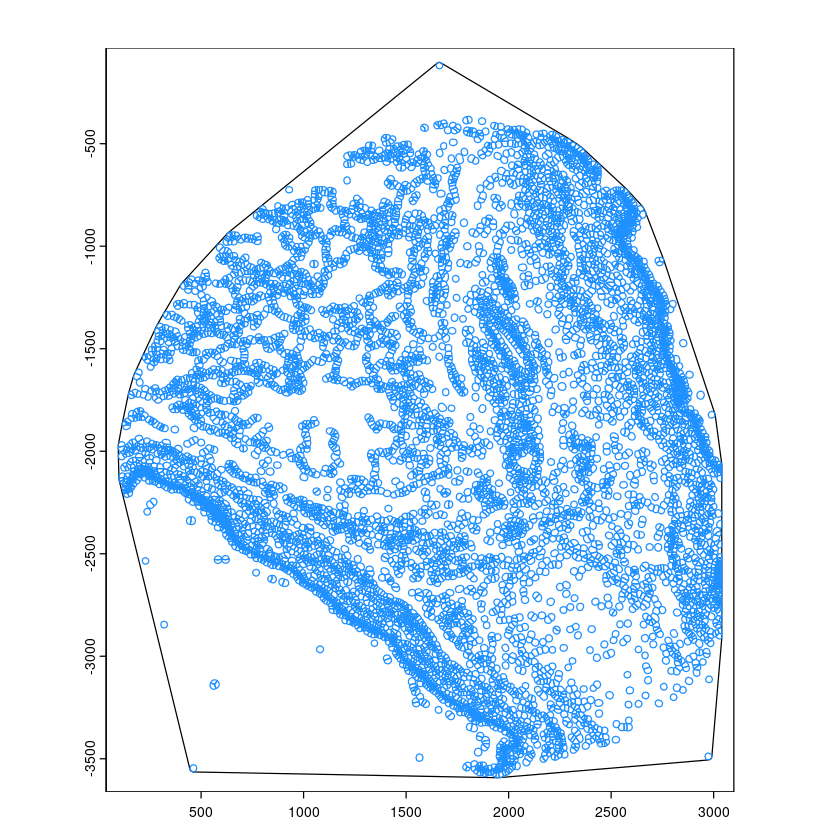

In [19]:
cell_polys |>
    convHull() |>
    plot()

plot(cell_polys, add = TRUE, border = "dodgerblue")

In [20]:
# how much area does the convex hull cover?
cell_polys |>
    convHull() |>
    area()

# area per cell?
cell_polys |> area() |> head()

[1] 8062784

[1] 321.7373 355.0630 153.3288 557.0031 174.0566 269.7852

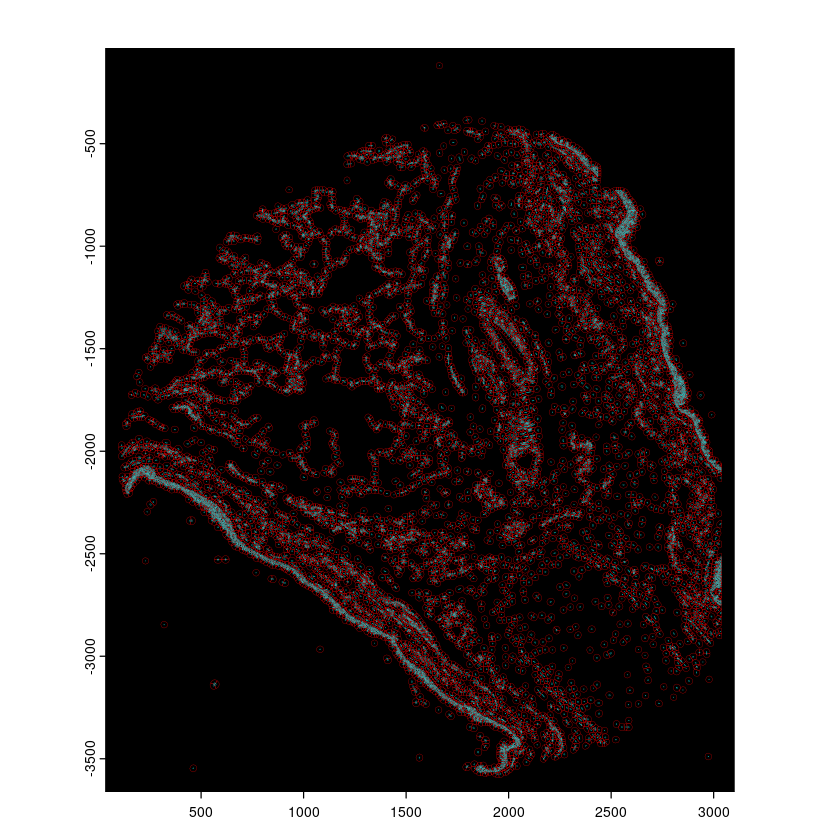

In [21]:
# additive plotting
plot(cell_polys, border = "red", lwd = 0.2, background = "black")
plot(nuc_polys, add = TRUE, border = "cyan", lwd = 0.2)

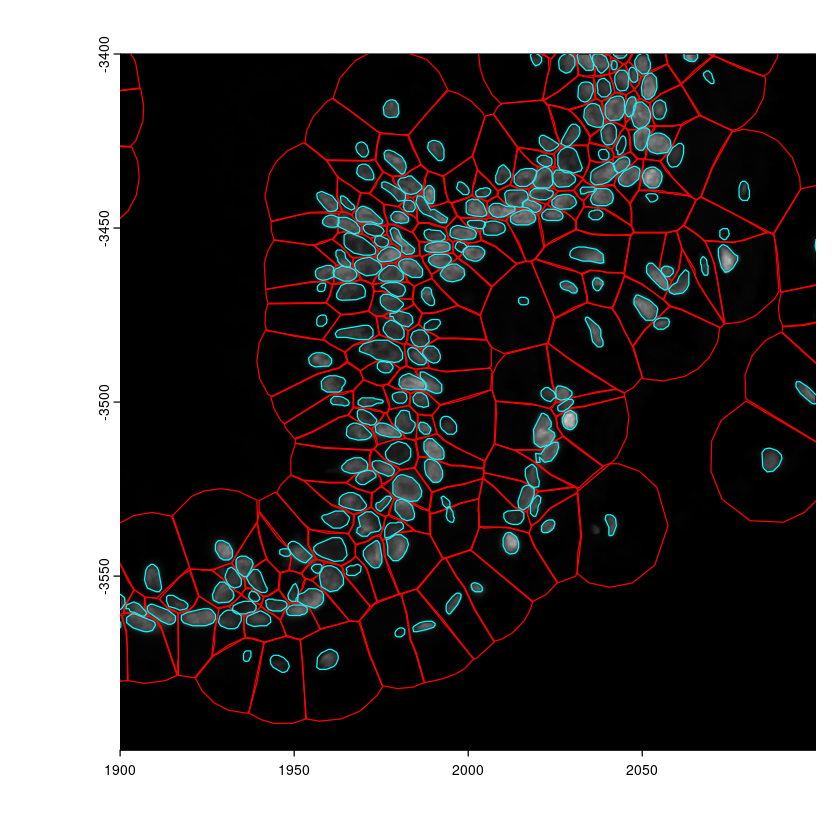

In [22]:
# zoomin ### `zoom(dapi1[[1]])` could normally be used here for interactive
plot(dapi1[[1]], ext = c(1900, 2100, -3600, -3400))
plot(polys[[1]], add = TRUE, border = "red", lwd = 1, background = "black")
plot(polys[[2]], add = TRUE, border = "cyan", lwd = 1)
# from the zoomin, you can also see that this is with the default Xenium segmentation (no bound stains)

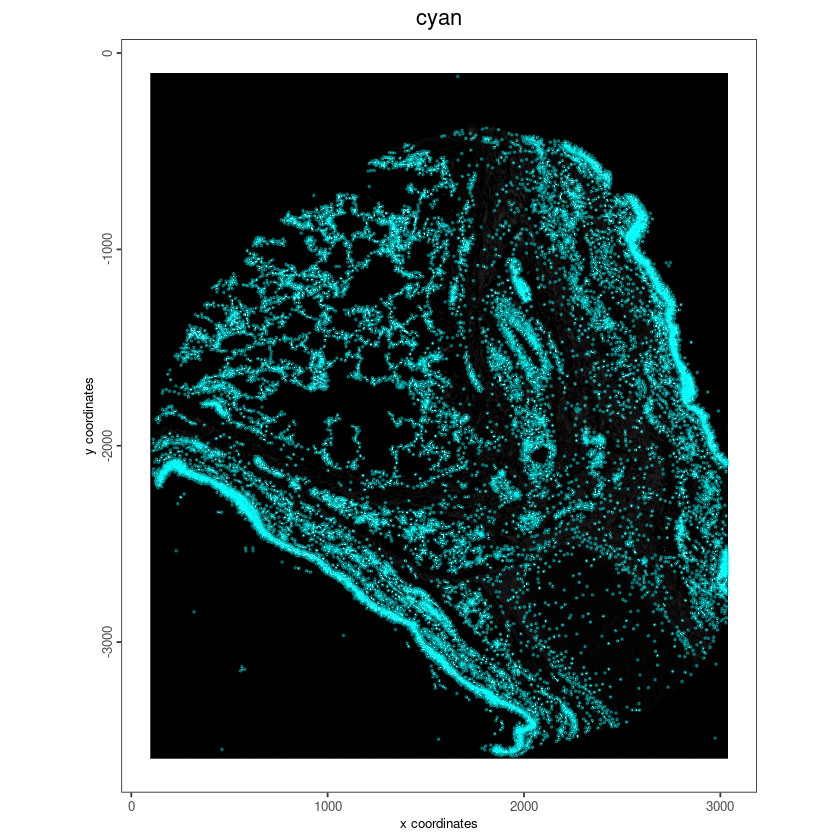

In [23]:
spatPlot2D(xen1, show_image = TRUE, point_size = 0.4, cell_color = "cyan", point_shape = "no_border", point_alpha = 0.3)
# you can also see that this populates in the output plot directory

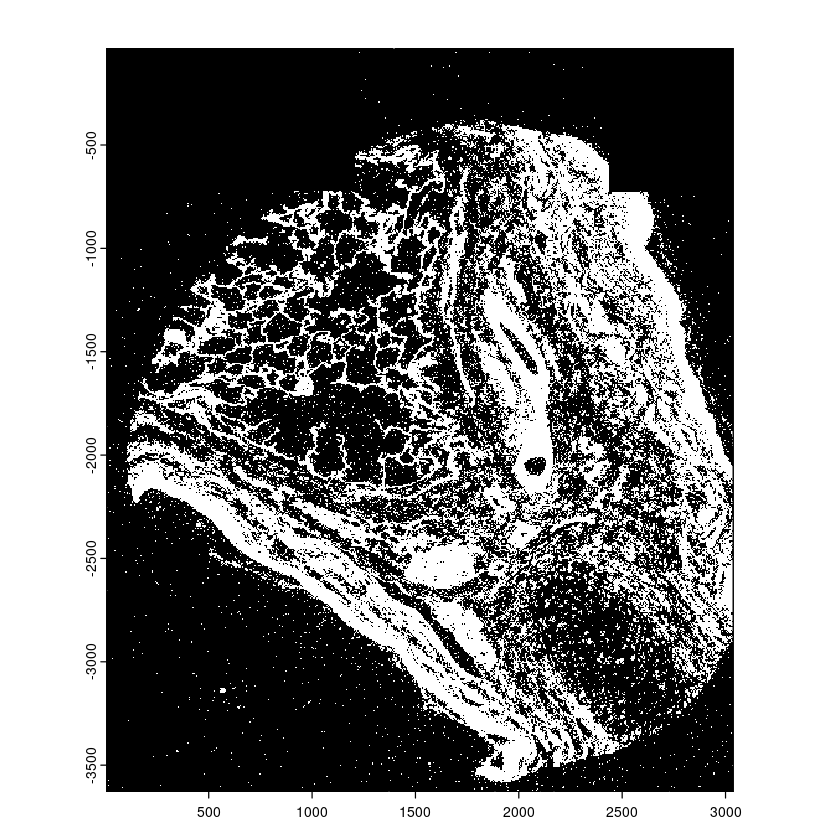

In [24]:
# detections to aggregate
tx <- getFeatureInfo(xen1, feat_type = "rna", return_giottoPoints = TRUE)
tx |> plot() # custom method for rasterized plots

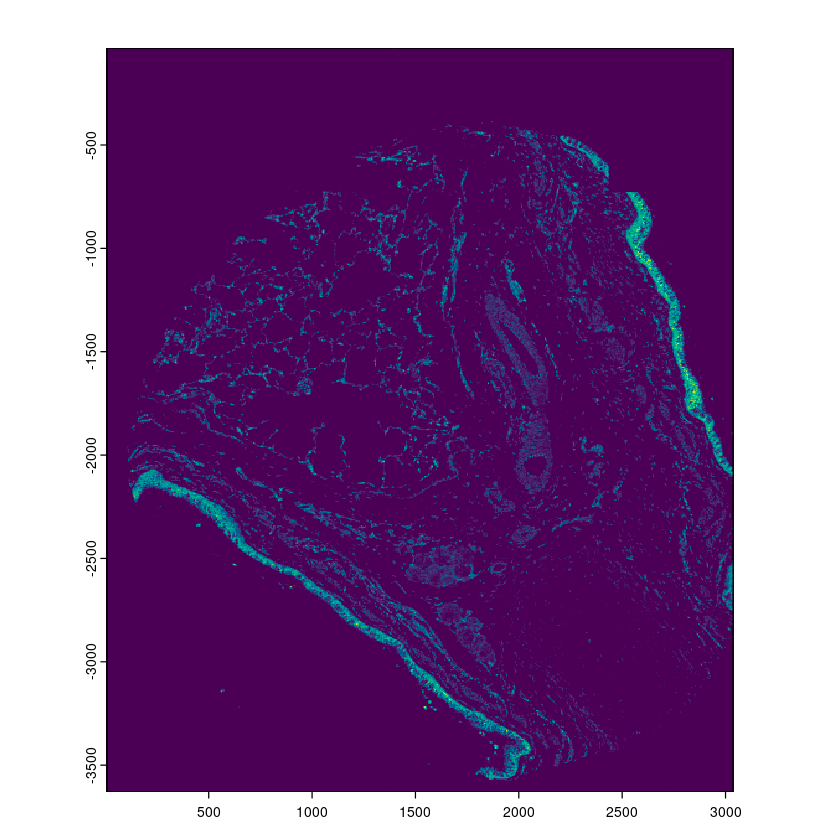

In [25]:
tx |> plot(dens = TRUE)

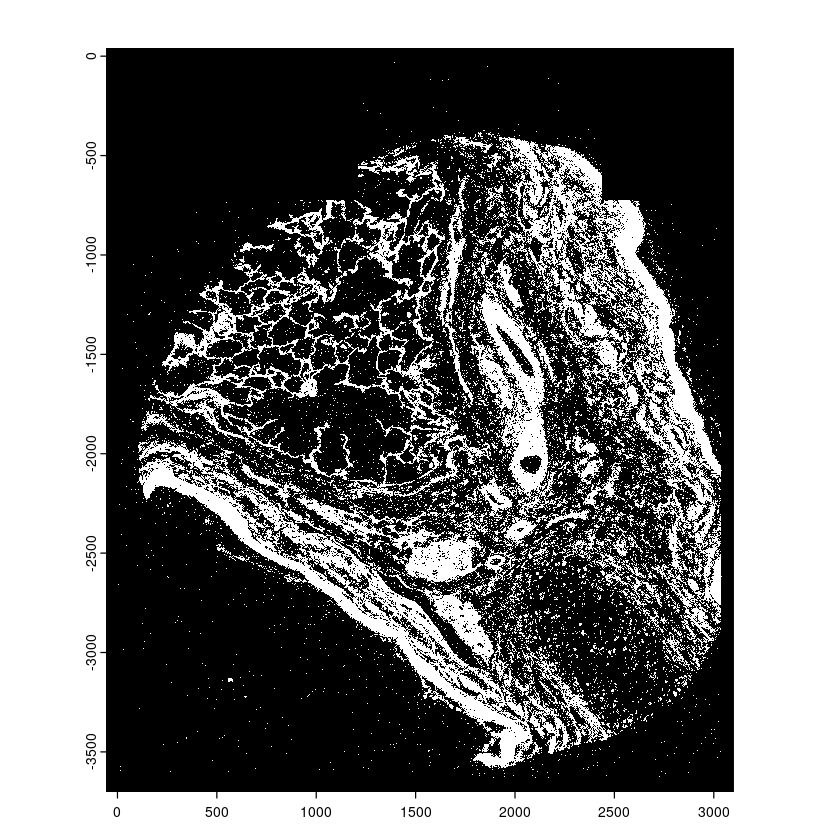

In [26]:
tx |> plot(raster = FALSE) # sharper, but can be very slow for large datasets

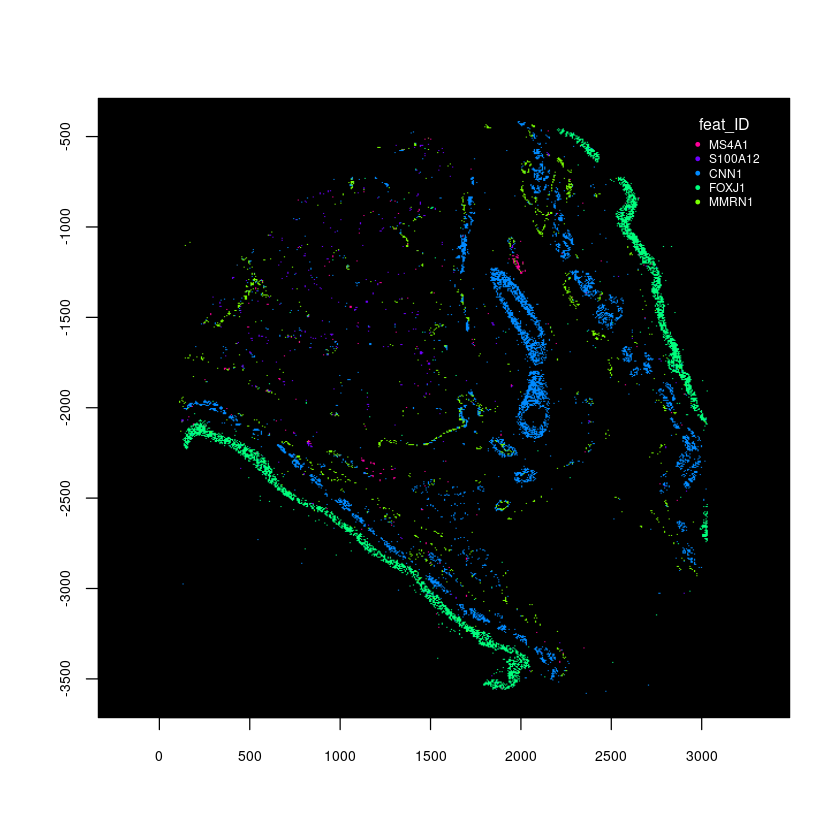

In [27]:
tx |> plot(feats = c("MS4A1", "S100A12", "CNN1", "FOXJ1", "MMRN1")) # this is also rasterized by default

So we have our features and our spatial annotations.

We next need to associate the transcripts with cells.

We do this by calculating the overlap between transcripts and polygons. This will create an expression matrix that contains the expression for each cell for all the transcripts identified.

In [28]:
# feature aggregation (cell)
xen1 <- calculateOverlap(xen1) # find features overlapped by polygons
xen1 <- overlapToMatrix(xen1) # convert those overlaps to a matrix

1. convert polygon to raster

2. overlap raster and points

3. add polygon information

4. add points information

5. create overlap polygon
 information



Once we've created the expression matrix we can see distribution of expression profiles for cells either as a measure of total unique transcripts per cell (top) or total expression (bottom).

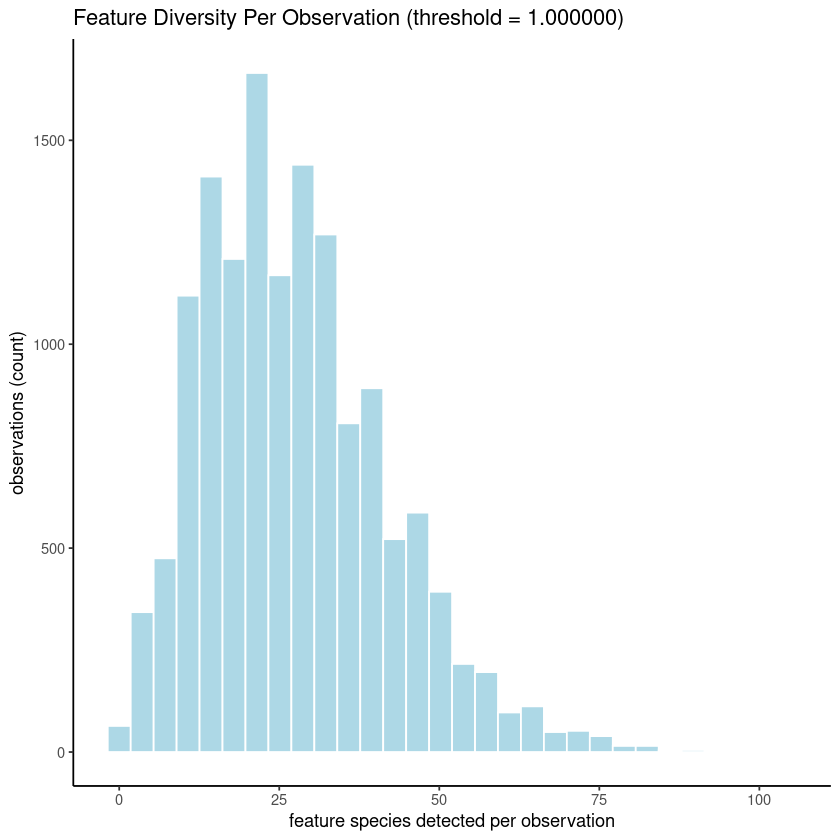

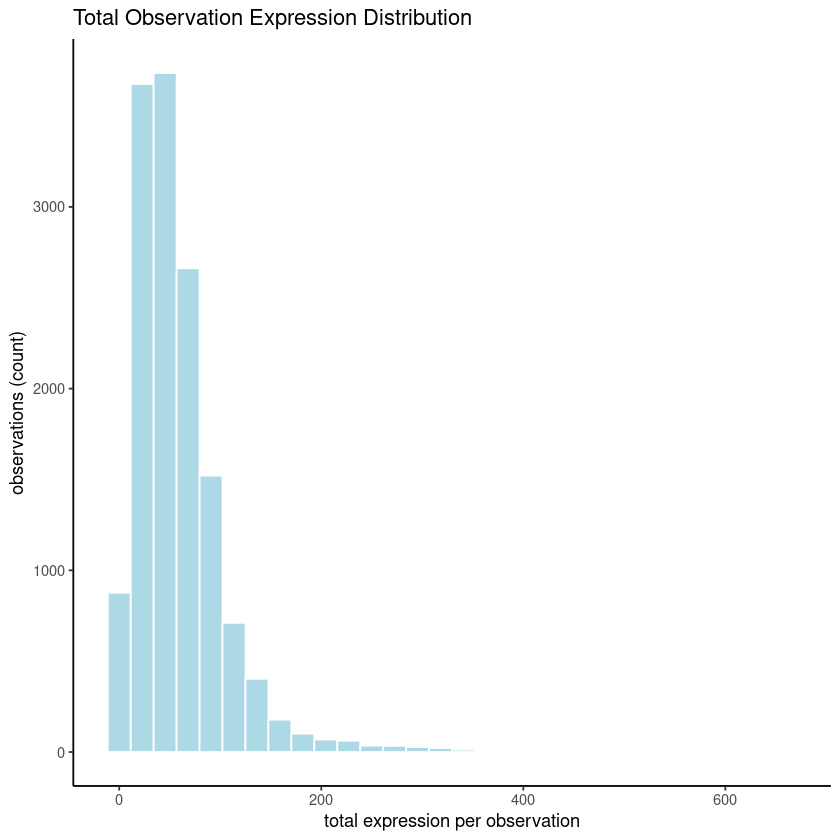

In [29]:
# number of different features per cell
filterDistributions(xen1, detection = "cells")
# total expression per cell
filterDistributions(xen1, detection = "cells", method = "sum") # can set log2 scaling with scale_axis

In [30]:
## Filtering

In [31]:
# just remove 0 values
xen1 <- filterGiotto(xen1,
    expression_threshold = 1,
    feat_det_in_min_cells = 1,
    min_det_feats_per_cell = 1
)
# light filtering but only tagged, not fully removed
xen1 <- filterGiotto(xen1,
    expression_threshold = 1,
    feat_det_in_min_cells = 10,
    min_det_feats_per_cell = 10,
    tag_cells = TRUE,
    tag_feats = TRUE
)

completed 1: preparation

completed 2: subset expression data

completed 3: subset spatial locations

completed 4: subset cell metadata

completed 5: subset feature metadata

completed 6: subset spatial network(s)

completed 7: subsetted dimension reductions

completed 8: subsetted nearest network(s)

completed 9: subsetted spatial enrichment results

for cell

--> cell found back in polygon layer: cell

for nucleus

completed 10: subsetted spatial information data

subset feature info: rna

completed 11: subsetted spatial feature data




Feature type:  rna 
Number of cells removed:  28  out of  14168 
Number of feats removed:  0  out of  289 


> Cell metadata for spat_unit " cell " and feat_type " rna " already exists and
 will be replaced with new metadata.

Setting cell metadata [cell][rna]

> Feat metadata for spat_unit " cell " and feat_type " rna " already exists and
 will be replaced with new metadata.

Setting feature metadata [cell][rna]

completed 1: preparation

completed 2: subset expression data

completed 3: subset spatial locations

completed 4: subset cell metadata

completed 5: subset feature metadata

completed 6: subset spatial network(s)

completed 7: subsetted dimension reductions

completed 8: subsetted nearest network(s)

completed 9: subsetted spatial enrichment results

for cell

--> cell found back in polygon layer: cell

for nucleus

completed 10: subsetted spatial information data

subset feature info: rna

completed 11: subsetted spatial feature data




Feature type:  rna 
Number of cells tagged:  1071  out of  14140 
Number of feats tagged:  1  out of  289 


You can see on the first filtration we remove 28 out of 14168 cells from the dataset as these contain less than 1 feature (transcript) with an expression threshold of 1.

We next make the cutoffs a little more stringent to what would be helpful for analysis.

This time, we only tag the cells for removal, so that we can first get a grasp of what will be removed.

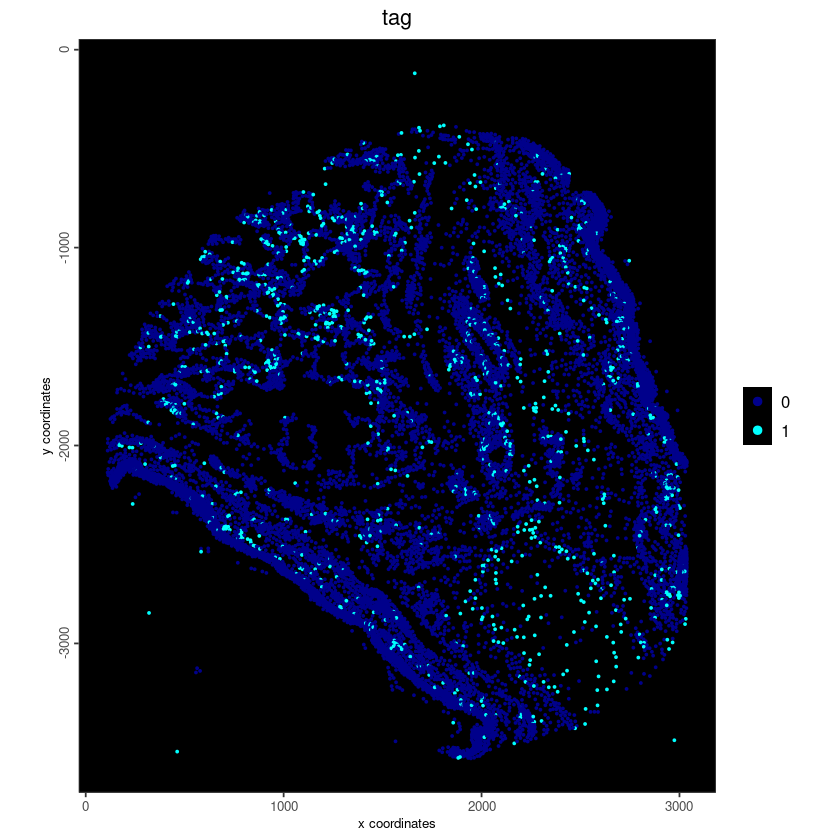

In [32]:
spatPlot2D(xen1,
    point_size = 0.4,
    cell_color = "tag",
    point_shape = "no_border",
    background = "black",
    cell_color_code = c("darkblue", "cyan")
)

In [33]:
# what is the feature removed?
fDataDT(xen1)[tag == TRUE]

feat_ID,ensembl,type,tag
<chr>,<chr>,<chr>,<dbl>
TCL1A,ENSG00000100721,gene,1


[1] 7

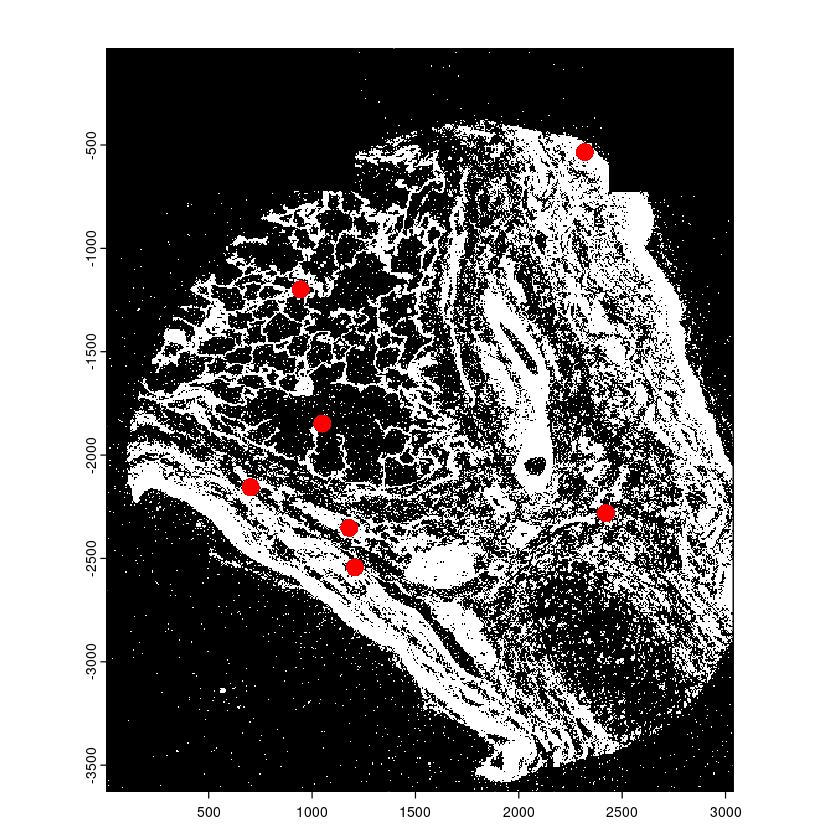

In [34]:
tx <- xen1[[, "rna"]][[1]]

plot(tx)
tx["TCL1A"] |> plot(raster = FALSE, add = TRUE, col = "red", cex = 2)
tx["TCL1A"] |> nrow()
rm(tx)

calculating statistics for "raw" expression



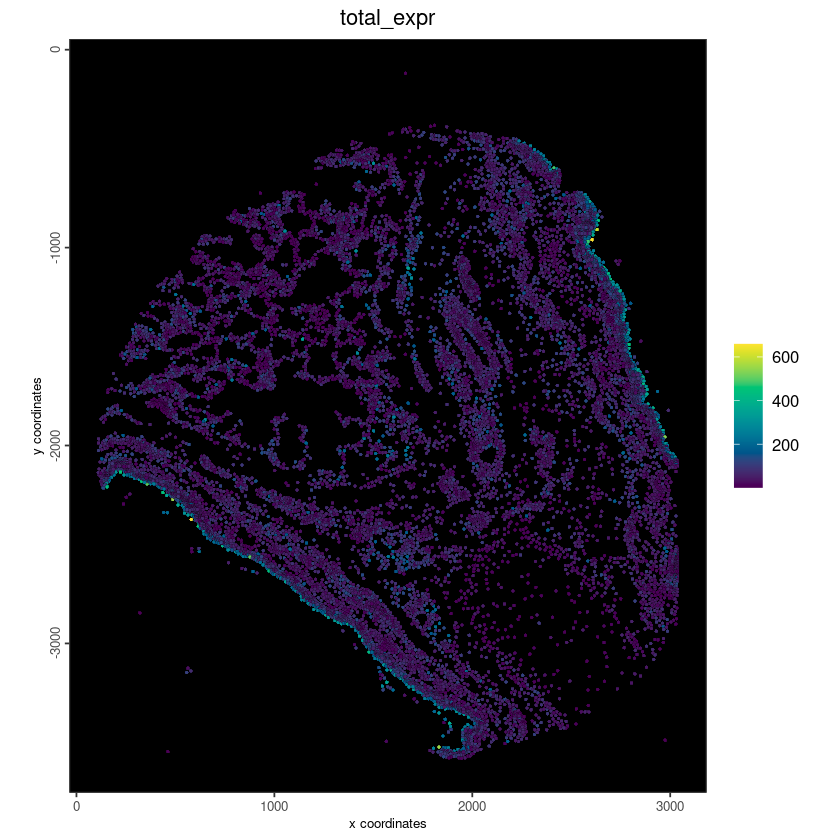

In [35]:
xen1 <- addStatistics(xen1, expression_values = "raw")
spatPlot2D(xen1, cell_color = "total_expr", gradient_style = "sequential", background_color = "black", point_size = 1, color_as_factor = FALSE)

In [36]:
# normalization (standard RNA libnorm, scale by 6000, then log2)
xen1 <- normalizeGiotto(xen1)

first scale feats and then cells

Setting expression [cell][rna] normalized

Setting expression [cell][rna] scaled



# Spatial Expression

We can first start with a general overview of the spatially organized expression that is present. It is also easier to calculate spatial relationships when no nodes have been removed from the spatial data yet.

Setting spatial network [cell] Delaunay_network



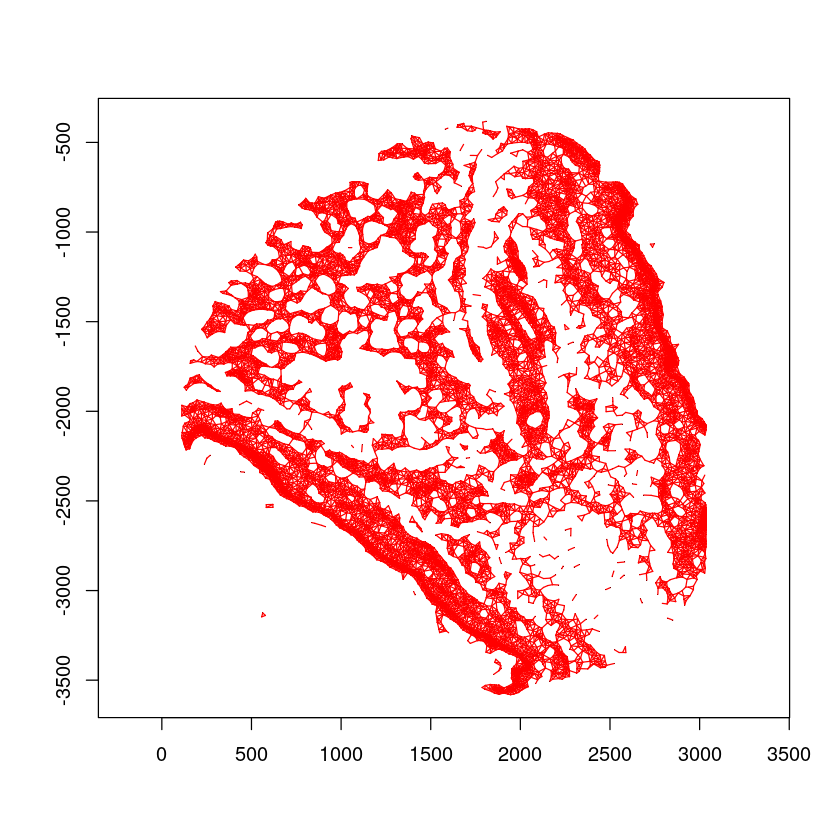

In [37]:
# spatial network generation
xen1 <- createSpatialNetwork(xen1,
    method = "Delaunay",
    # method = "kNN",
    # k = 8
    maximum_distance_delaunay = "auto" # auto set as whisker of a boxplot for center to center distances
)
sn <- getSpatialNetwork(xen1)
plot(sn)

## binSpect
1. Binarizes each gene across the cells

    1.1. Binarization threshold determined by `bin_method` param (either kmeans = 2 or expression value ranking + `percentage_rank`)
2. Contingency table calculated based on all spatial network and binarized expression
3. A higher score means more spatially contiguous expression



In [38]:
binspect_res <- binSpect(xen1) # takes 30 sec
head(binspect_res)


This is the single parameter version of binSpect


1. matrix binarization complete


2. spatial enrichment test completed


3. (optional) average expression of high
 expressing cells calculated


4. (optional) number of high expressing cells
 calculated



feats,p.value,estimate,adj.p.value,score,av_expr,high_expr
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
FOXJ1,7.981057e-310,36.53848,2.239345e-309,26005.33,7.473927,1884
CYP2F1,7.981057e-310,36.08374,2.239345e-309,25681.68,7.610029,2039
DES,7.981057e-310,34.10975,2.239345e-309,24276.74,8.872491,1876
SOX2,7.981057e-310,32.57020,2.239345e-309,23181.00,7.382569,2758
CCDC78,7.981057e-310,28.14291,2.239345e-309,20030.00,7.175050,1343
KRT15,7.981057e-310,27.72758,2.239345e-309,19734.39,8.145148,1951


## Detect spatially correlated features
Another method in Giotto is `detectSpatialCorFeats()` to perform multivariate correlations between features in the dataset.

1. expression-smoothing across the spatial neighbors using the spatial network.
2. find correlations (pearson by default) between features (feature vs feature matrix output) for smoothed matrix and original matrix
3. find difference between cor values: larger positive difference means spatial correlation between those features. Lower/neg values mean not spatially correlated.

This is a computationally expensive function to run due to the pairwise cor runs, so usually we subset the number of features to test by checking for whether it is even a spatially organized gene (binSpect)

For a smaller dataset like this though, we could probably run it without any `subset_feats`

In [39]:
spat_cor_obj <- detectSpatialCorFeats(xen1,
    method = "network",
    subset_feats = head(binspect_res, 50)$feats
)

In [40]:
# these are the calculated values
spat_cor_obj$cor_DT |> head()

feat_ID,variable,spat_cor,expr_cor,cordiff,spatrank,exprrank,rankdiff
<chr>,<fct>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>
ACKR1,ACKR1,1.00000000,1.00000000,0.00000000,1,1,0
ACKR1,SELP,0.64647504,0.52837571,0.11809933,2,2,0
ACKR1,SELE,0.54206446,0.42885967,0.11320479,3,3,0
ACKR1,MMRN1,0.37221350,0.30148107,0.07073244,4,4,0
ACKR1,FCN3,0.08908566,0.10399383,-0.01490817,5,5,0
ACKR1,LMOD1,0.06665452,0.04872393,0.01793060,6,6,0


In [41]:
# hierarchical clustering (ward.D) to find k clusters between the spat_cor values
spat_cor_obj <- clusterSpatialCorFeats(spat_cor_obj, k = 6, name = "spat_modules")
spat_cor_obj$cor_clusters$spat_modules

ACKR1     AGER     AGR3 BAIAP2L1    BCAS1   CCDC78    CCNA1     CD24 
       1        2        3        3        3        3        4        3 
   CD79A     CDH1     CNN1       CP    CXCL6   CYP2F1      DES      EHF 
       5        3        6        3        3        3        6        3 
    ELF3    EPCAM       F3     FCN3    FOXJ1     GJA5     KLF5    KLK11 
       3        3        3        2        3        2        3        3 
   KRT15    LMOD1      LTF    MARCO   MCEMP1    MMRN1    MUC5B    MYH11 
       3        6        4        2        2        1        3        6 
    MZB1    PEBP4      PI3  PLA2G2A      PLN    PROX1     RBP4    RERGL 
       5        2        3        4        6        1        4        6 
    SELE     SELP    SFTPD  SLC15A2     SOX2  TACSTD2     TMC5     TP63 
       1        1        2        3        3        3        3        3 
    TP73    UPK1B 
       3        3

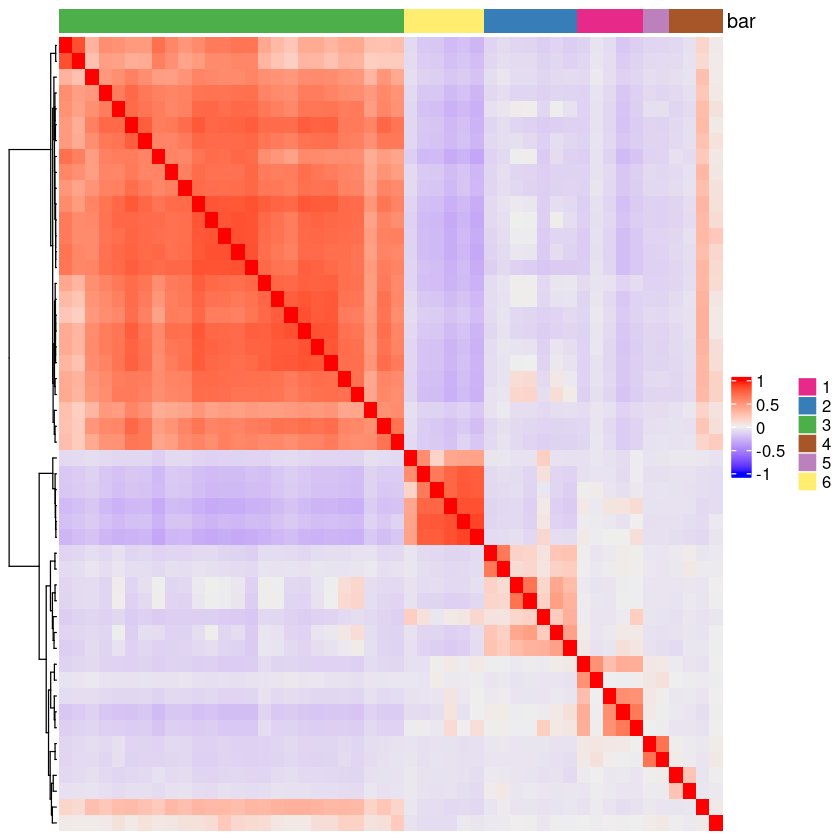

In [42]:
heatmSpatialCorFeats(gobject = xen1,
    spatCorObject = spat_cor_obj,
    use_clus_name = "spat_modules",
    heatmap_legend_param = list(title = NULL)
)

In [43]:
spatcor_features_table <- showSpatialCorFeats(
    spatCorObject = spat_cor_obj,
    use_clus_name = "spat_modules",
    show_top_feats = 1, # how many top feature/feature interactions to retrieve
    min_spat_cor = 0.5,
    min_expr_cor = NULL,
    min_cor_diff = NULL,
    min_rank_diff = NULL
)
spatcor_features_table |> head()

feat_ID,variable,spat_cor,expr_cor,cordiff,spatrank,exprrank,rankdiff,clus
<chr>,<fct>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<int>
ACKR1,ACKR1,1,1,0,1,1,0,1
AGER,AGER,1,1,0,1,1,0,2
AGR3,AGR3,1,1,0,1,1,0,3
BAIAP2L1,BAIAP2L1,1,1,0,1,1,0,3
BCAS1,BCAS1,1,1,0,1,1,0,3
CCDC78,CCDC78,1,1,0,1,1,0,3


In [44]:
# convert extracted features into metafeature for plotting
cluster_features <- spatcor_features_table$clus
names(cluster_features) <- spatcor_features_table$feat_ID

xen1 <- createMetafeats(xen1,
    feat_clusters = cluster_features,
    name = "cluster_metagene",
    stat = "mean"
)

calculating metafeature: 1

calculating metafeature: 2

calculating metafeature: 3

calculating metafeature: 4

calculating metafeature: 5

calculating metafeature: 6



In [45]:
# what features are in these metafeatures?
for (i in 1:6) {
    print(head(cluster_features[cluster_features == i]))
}

ACKR1 MMRN1 PROX1  SELE  SELP 
    1     1     1     1     1 
  AGER   FCN3   GJA5  MARCO MCEMP1  PEBP4 
     2      2      2      2      2      2 
    AGR3 BAIAP2L1    BCAS1   CCDC78     CD24     CDH1 
       3        3        3        3        3        3 
  CCNA1     LTF PLA2G2A    RBP4 
      4       4       4       4 
CD79A  MZB1 
    5     5 
 CNN1   DES LMOD1 MYH11   PLN RERGL 
    6     6     6     6     6     6 


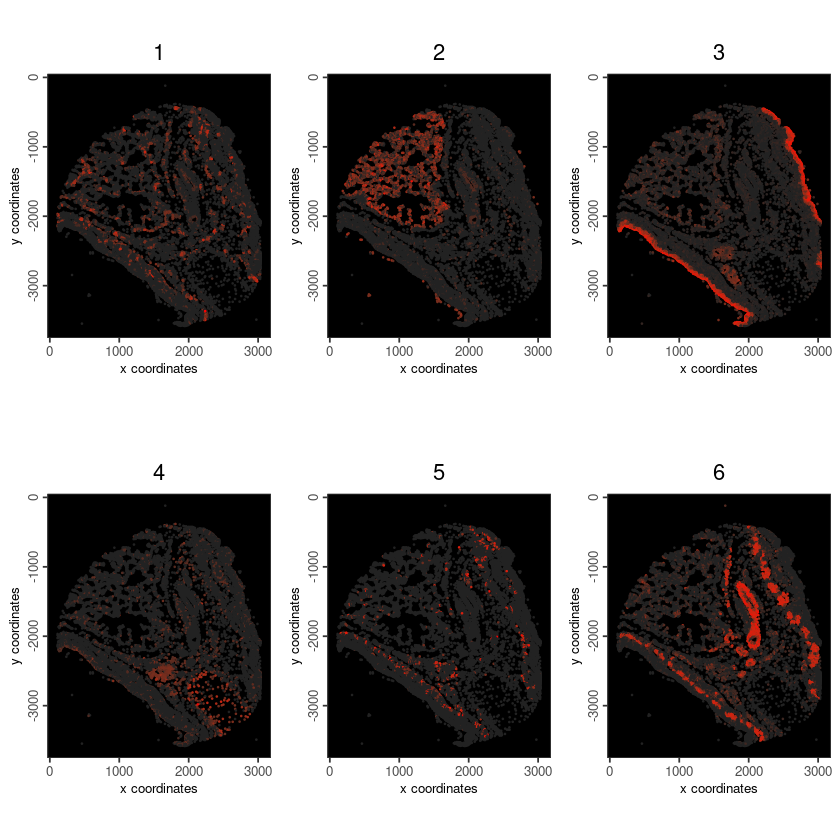

In [46]:
spatCellPlot(xen1,
    spat_enr_names = "cluster_metagene",
    cell_annotation_values = 1:8,
    point_size = 0.1,
    point_shape = "no_border",
    background_color = "black",
    cell_color_gradient = c("#222222", "red"),
    show_legend = FALSE
)

In [47]:
# # Autocorrelation
# xen1 <- createSpatialNetwork(xen1, method = "kNN", k = 8)
#
# # takes ~4min
# moran <- spdepAutoCorr(
#     gobject = xen1,
#     method = "moran.test",
#     spatial_network_to_use = "kNN_network"
# )

# show table of values
# moran

# Continuing with dim reduction and clustering

To analyze the data we first use a standard RNA library normalization, which is scaled by 6,000 then log2 transformed. We can the perform a dimension reduction through PCA. For spatial transcriptomics such as Visium HD that have much higher transcript counts it might be necassary to identify highly variable features before dimension reduction. For regular xenium datasets, the panel size is less than 500 genes, so this is not required. We can then visualize the principal components through the `screePlot` function.

"hvf" was not found in the gene metadata information.
 all genes will be used.

Setting dimension reduction [cell][rna] pca

PCA with name: pca already exists and will be used for the screeplot



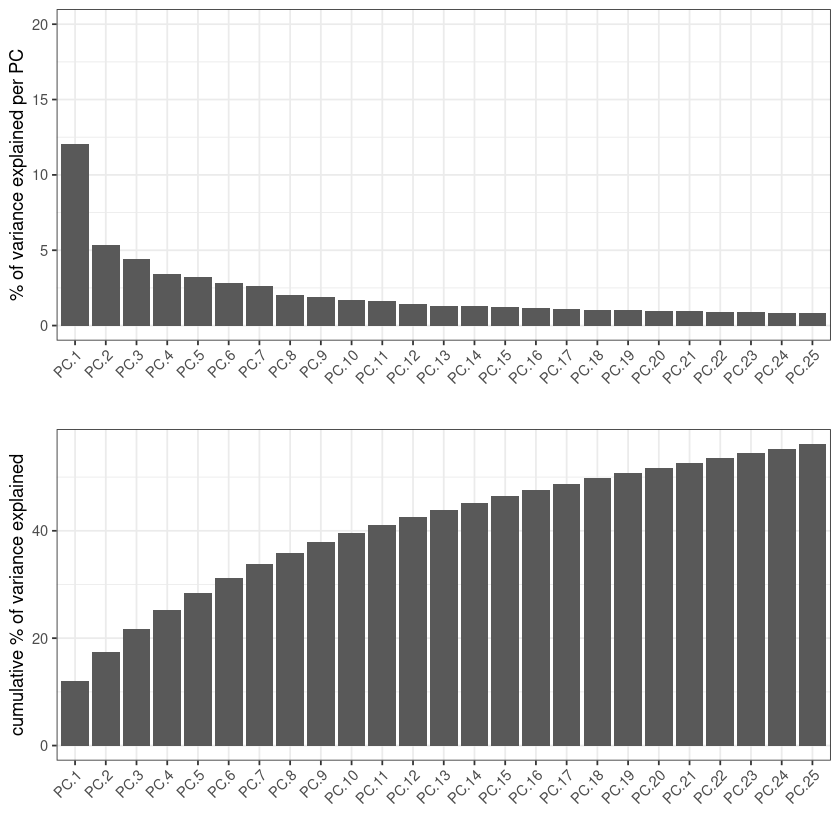

In [48]:
xen1 <- filterGiotto(xen1,
    expression_threshold = 1,
    feat_det_in_min_cells = 10,
    min_det_feats_per_cell = 10,
    verbose = FALSE
)

# run pca (no hvf selection needed with this panel size)
xen1 <- runPCA(xen1)

# check what a good number of PCs is
screePlot(xen1, ncp = 25) # only display first 25 PCs

Giotto does have another [way](https://drieslab.github.io/Giotto_website/articles/dimension_reduction.html#jackstraw-plot) of guessing what a good number of PCs to use are.

For downstream analyses we ideally want to use principal components that encompass the greatest degree variability of the dataset. For this dataset the first 15 principal components should work. We can then perform the UMAP calculation using these principal components. To perform Leiden clustering we first need to create a nearest neighbor network using the same principal components used to calculate the UMAP. Finally we can perform Leiden clustering. Here we can vary the resolution to increase or decrease the number of clusters. Below we can see a breakdown of the cell metadata through `pDataDT`, which contains information on the number of features expressed per cell, the area and the cluster information. As we perform more analyses this metadata will be filled out.

In [49]:
pc_use <- 1:15 # first 15 PCs

# UMAP calculation for visualization
xen1 <- runUMAP(xen1, dimensions_to_use = pc_use)

Setting dimension reduction [cell][rna] umap



In [50]:
# NN network generation for network clustering
xen1 <- createNearestNetwork(xen1, dimensions_to_use = pc_use)
# Leiden cluster on network
xen1 <- doLeidenCluster(xen1, res = 0.6, n_iterations = 100) # reduced number of iterations

# show clustering results from cell metadata
pDataDT(xen1) |> head()

cell_ID,tag,nr_feats,perc_feats,total_expr,area,leiden_clus
<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>
aaaaicnd-1,0,15,5.190311,108,321.7373,11
aaaiciie-1,0,22,7.612457,51,355.0630,11
aaaodfkf-1,0,27,9.342561,53,153.3288,4
aaapljnn-1,0,19,6.574394,33,557.0031,8
aabagpmd-1,0,26,8.996540,76,174.0566,1
aabgdghl-1,0,23,7.958478,57,269.7852,1


We can now visualize the UMAP space with `plotUMAP` based on the 16 clusters we determined above. It is possible to visualize any of the columns found in `pDataDT`. For instance we can look at the low quality cells we tagged above and find where they reside in the UMAP space. Please note if using a continuous scale, set the `color_as_factor` variable to FALSE.

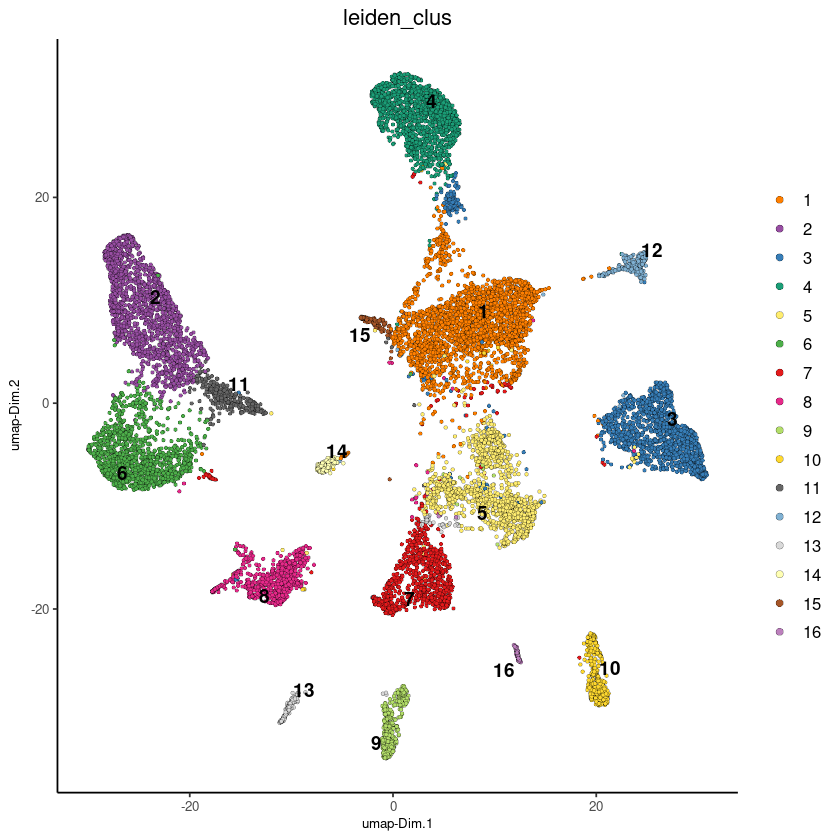

In [51]:
plotUMAP(xen1,
    cell_color = "leiden_clus",
    # point_shape = "no_border"
)

Warning message in doTryCatch(return(expr), name, parentenv, handler):
“You need to select features (feats) and modify feature
 types (feat_type) if you want to show individual features
 (e.g. transcripts)
 This warning is shown once per session”
plot polygon layer done



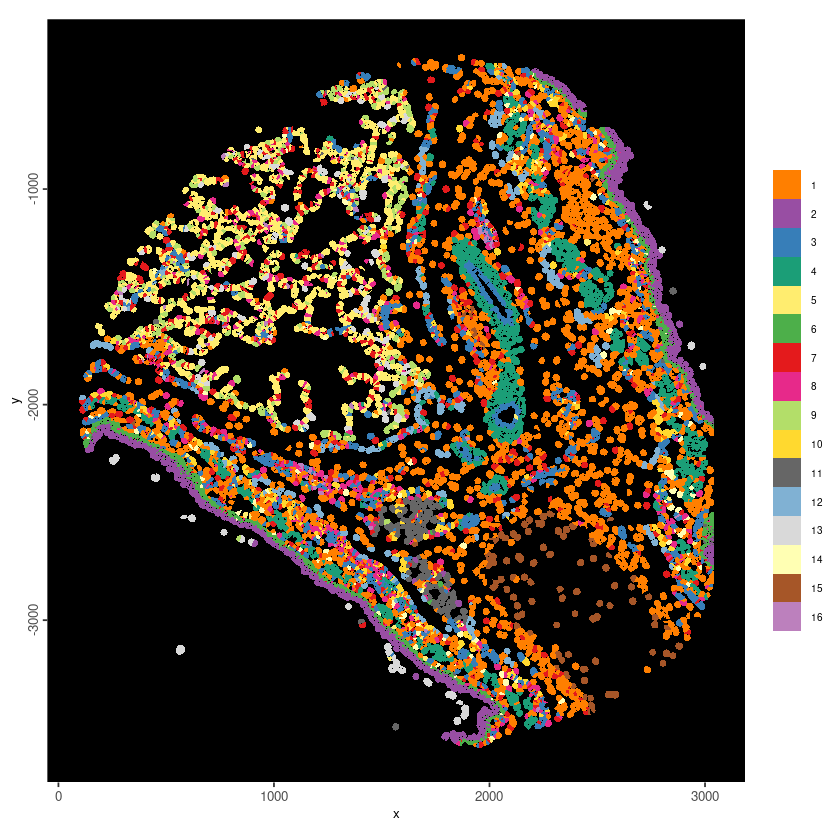

In [52]:
# plot polygons with clustering annotations
spatInSituPlotPoints(xen1,
    polygon_fill = "leiden_clus",
    polygon_fill_as_factor = TRUE,
    polygon_line_size = 0
)

Giotto objects can handle mutliple sets of polygons. Using this, we can also compare these results against "better" segmentations that we get from UCS (unified approach to cell segmentation) [Chen et al. 2025](https://doi.org/10.1002/smtd.202400975) which can enhance segmentation starting from nuclear polygons and rasterized transcript detections.

Each UCS run on a core takes roughly an hour with GPU. The output is a mask image that should increase cell segmentation accuracy and decrease the spillover of transcripts between neighboring cells.

In [53]:
ucs1_path <- file.path(data_path, "giotto_premade", "segmentation_mask_1.tif")

ucs_mask <- createGiottoLargeImage(ucs1_path)
ucs_mask

An object of class giottoLargeImage : "image"
Image extent            : 0, 3038, -3631, 0 (xmin, xmax, ymin, ymax)
Original image extent   : 0, 3038, -3631, 0 (xmin, xmax, ymin, ymax)
Scale factor            : 1, 1 (x, y)
Resolution              : 1, 1 (x, y)
Layers                  : 1 
Name                    : segmentation_mask_1 
Estimated max intensity : 14146 
Estimated min intensity : 0 
Values                  : integers
File path               : '/hive/hubmap/data/public/spatial-data-workshop/TMA2/giotto_premade/segmentation_mask_1.tif'

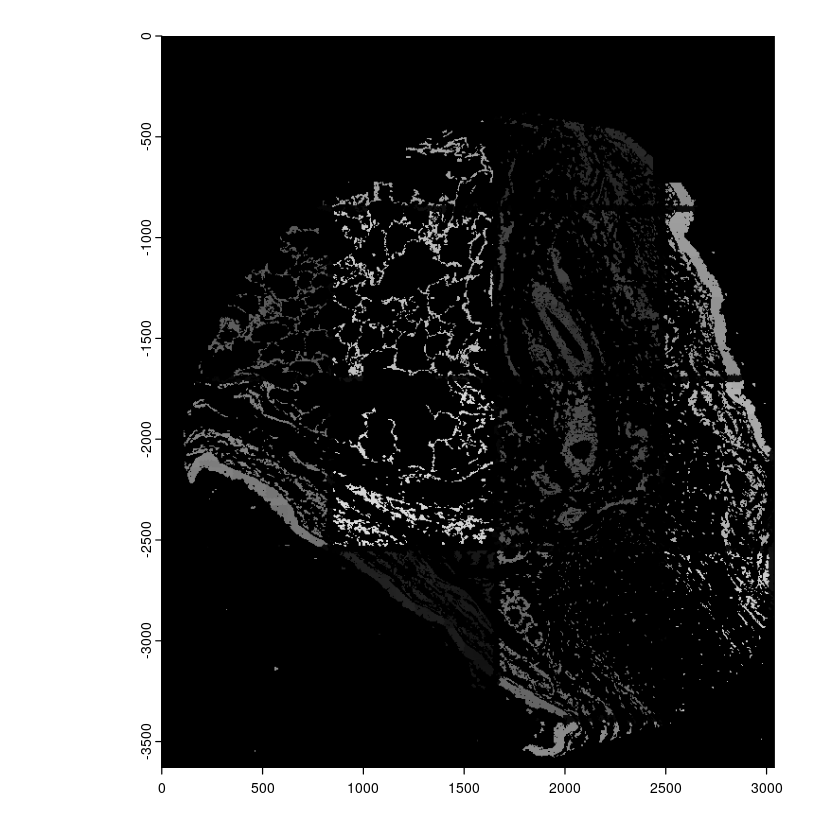

In [54]:
plot(ucs_mask)

We can read in the output from UCS using the `createGiottoPolygon` function. To match the space between the polygons and the trancripts we specified the shift_vertical_step variable to -1. Please keep in mind this might vary between datasets so make sure to check the extents of of your dataset throug the `ext(gobject)` function. Lastly we name these new polygons `ucs`. This is important as it differentiates the polygons from the default `cell` we used above.

We can visualize the new polygons and transcripts through the plotting functions.

In [55]:
# load in ucs as a polygon
ucs1 <- createGiottoPolygon(ucs1_path,
    shift_vertical_step = -1, # shift into the negatives like the Xenium dataset
    name = "ucs" # name to assign the spat_unit that this will define
)

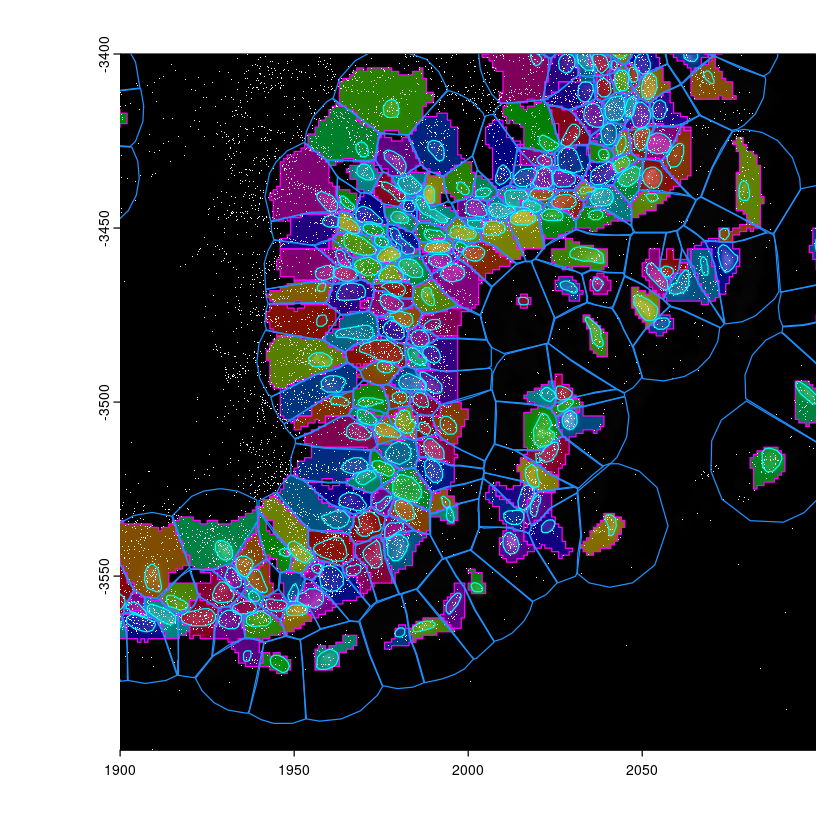

In [56]:
# plot same zoomed in region
plot(dapi1[[1]], ext = c(1900, 2100, -3600, -3400))
plot(ucs1, add = TRUE, col = sample(rainbow(100)), alpha = 0.5, border = "magenta", lwd = 1)
plot(xen1@feat_info$rna, add = TRUE, raster = FALSE)
plot(polys[[1]], add = TRUE, border = "dodgerblue", lwd = 1, background = "black")
plot(polys[[2]], add = TRUE, border = "cyan", lwd = 1)

To incorporate the ucs polygons into our Giotto object we use the `setGiotto` function. As these are named differently they will be added independently of the original polygons. We can also set the active spatial unit with `activeSpatUnit` to ensure all functions moving forward will default to the new polygons for analysis.

From here we can perform the same analyses we did above. For more information on these please refer to earlier steps.

In [57]:
# append UCS segmentation to gobject
xen1 <- setGiotto(xen1, ucs1)

activeSpatUnit(xen1) <- "ucs"

Setting polygon info [ucs]



In [58]:
# feature aggregation (ucs)
xen1 <- calculateOverlap(xen1, spatial_info = "ucs")
xen1 <- overlapToMatrix(xen1, poly_info = "ucs")
xen1 # show contents

1. convert polygon to raster

2. overlap raster and points

3. add polygon information

4. add points information

5. create overlap polygon
 information



An object of class giotto 
>Active spat_unit:  ucs 
>Active feat_type:  rna 
dimensions    : 288, 14167 (features, cells)
[SUBCELLULAR INFO]
polygons      : cell nucleus ucs 
features      : rna NegControlProbe UnassignedCodeword NegControlCodeword DeprecatedCodeword 
[AGGREGATE INFO]
expression -----------------------
  [cell][rna] raw normalized scaled
  [ucs][rna] raw
spatial locations ----------------
  [cell] raw
  [nucleus] raw
  [ucs] raw
spatial networks -----------------
  [cell] Delaunay_network
spatial enrichments --------------
  [cell][rna] cluster_metagene
dim reduction --------------------
  [cell][rna] pca umap
nearest neighbor networks --------
  [cell][rna] sNN.pca
attached images ------------------
images      : image 


Use objHistory() to see steps and params used

In [59]:
dim(xen1)

[1]   288 14167

completed 1: preparation

completed 2: subset expression data

completed 3: subset spatial locations

completed 4: subset cell metadata

completed 5: subset feature metadata

completed 6: subset spatial network(s)

completed 7: subsetted dimension reductions

completed 8: subsetted nearest network(s)

completed 9: subsetted spatial enrichment results

for cell

for nucleus

for ucs

--> ucs found back in polygon layer: ucs

completed 10: subsetted spatial information data

subset feature info: rna

completed 11: subsetted spatial feature data




Feature type:  rna 
Number of cells removed:  1720  out of  14167 
Number of feats removed:  0  out of  288 


calculating statistics for "raw" expression

first scale feats and then cells

Setting expression [ucs][rna] normalized

Setting expression [ucs][rna] scaled

"hvf" was not found in the gene metadata information.
 all genes will be used.

Setting dimension reduction [ucs][rna] pca

PCA with name: pca already exists and will be used for the screeplot



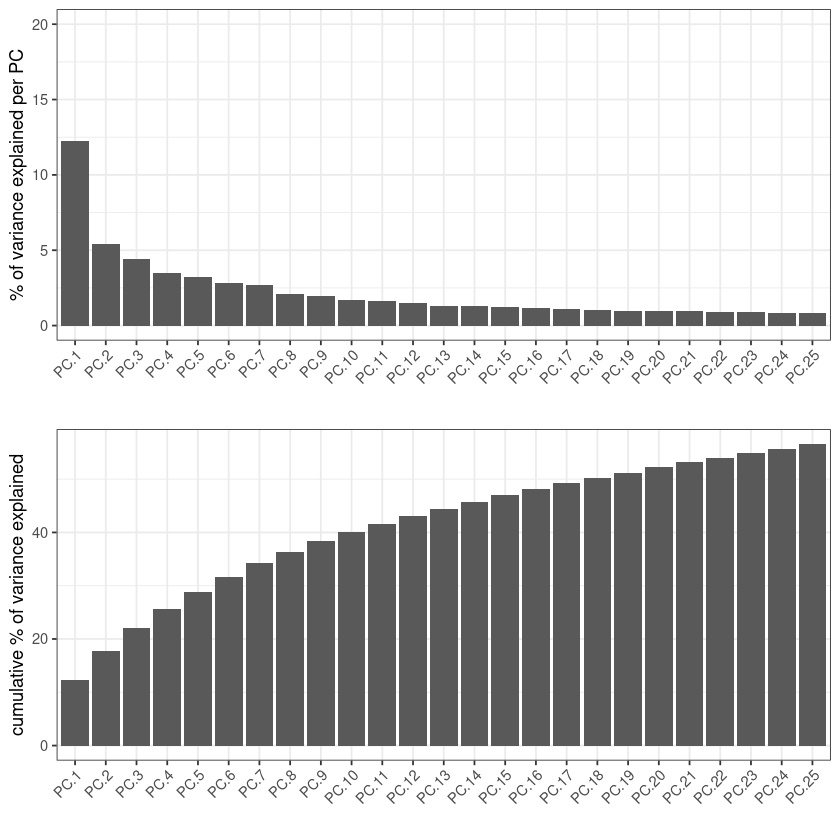

In [60]:
# data processing
xen1 <- filterGiotto(xen1,
    expression_threshold = 1,
    feat_det_in_min_cells = 10,
    min_det_feats_per_cell = 10
) |>
    addStatistics(expression_values = "raw") |>
    normalizeGiotto() |>
    runPCA()

screePlot(xen1, ncp = 25)

Setting dimension reduction [ucs][rna] umap



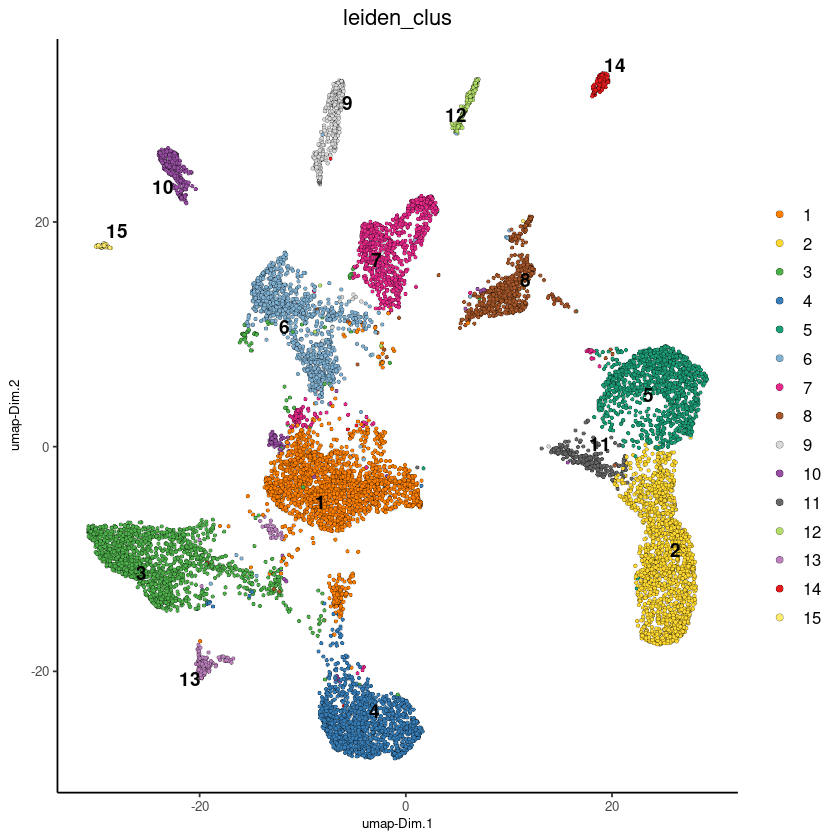

In [61]:
# 15 PCs is also good here
pc_use <- 1:15

# UMAP calculation for visualization
xen1 <- runUMAP(xen1, dimensions_to_use = pc_use) |>
    createNearestNetwork(dimensions_to_use = pc_use) |>
    doLeidenCluster(res = 0.6, n_iterations = 100) # this will take a minute or two

plotUMAP(xen1, cell_color = "leiden_clus")

plot polygon layer done



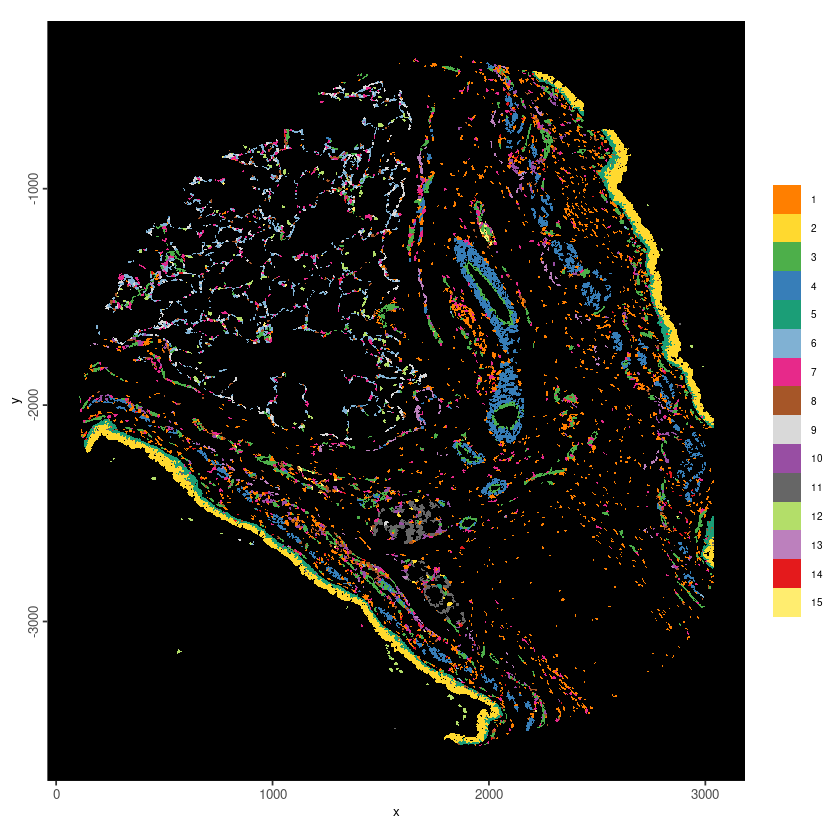

In [62]:
# plot polygons with clustering annotations
spatInSituPlotPoints(xen1,
    polygon_feat_type = "ucs",
    polygon_fill = "leiden_clus",
    polygon_fill_as_factor = TRUE,
    polygon_line_size = 0
)

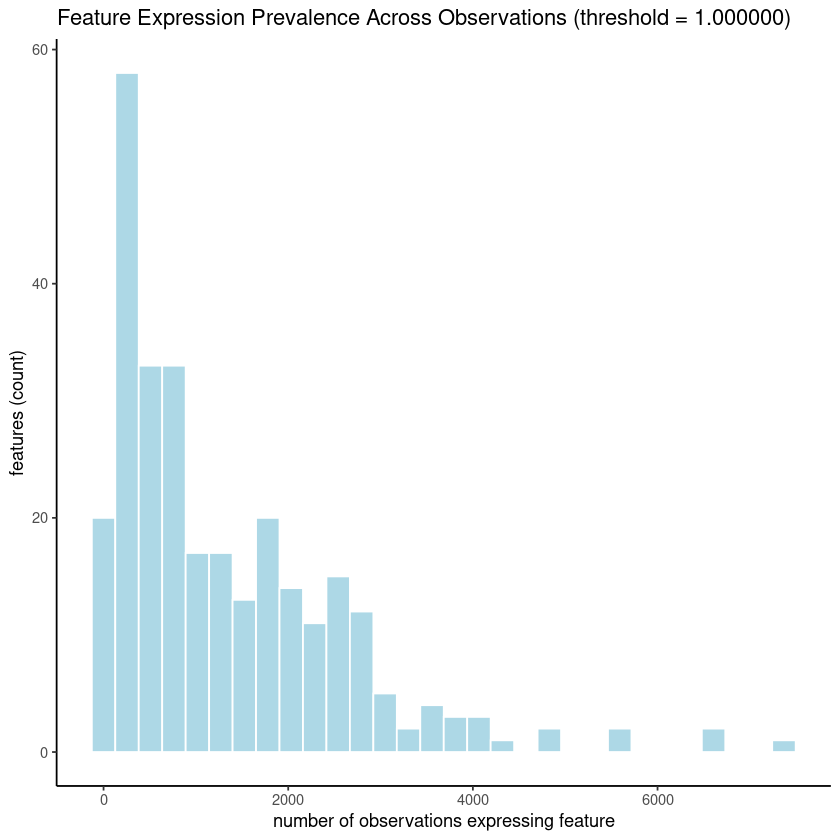

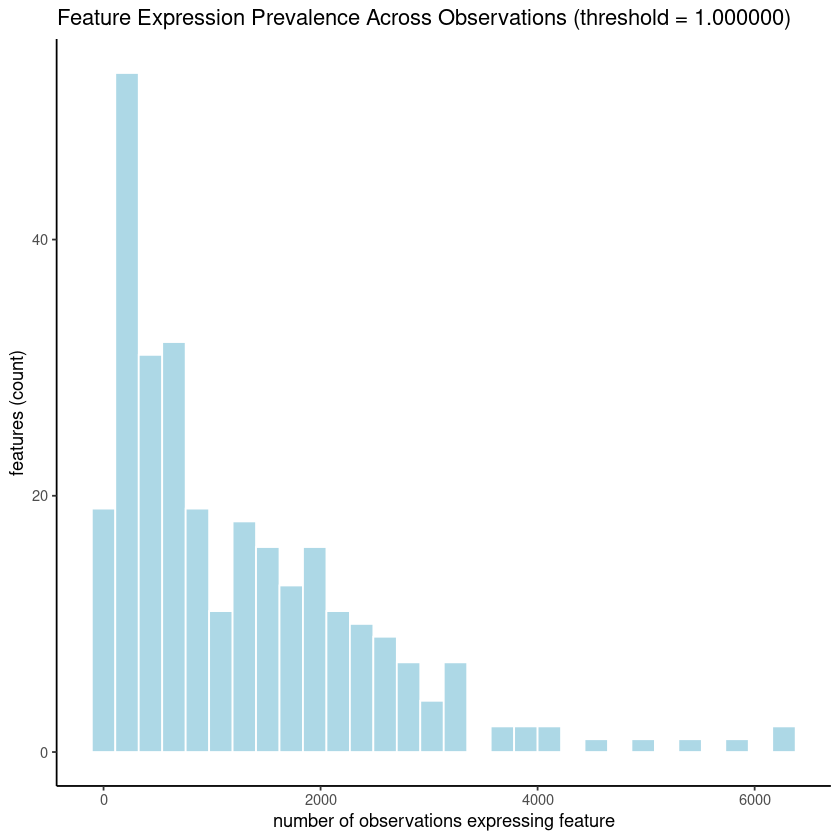

In [63]:
# histogram of number of cells in which a feature is detected
filterDistributions(xen1, spat_unit = "cell")
filterDistributions(xen1, spat_unit = "ucs")

We can also directly compare the differences in the polygons. The UCS cells have a smaller area compared to the 10X segmentation. We can check if this has an affect on our ability to detect rare features. We took features using `fDataDT` that were expressed in fewer than 50 cells and compared thse with a table. We identified a marginal difference between the segmentation methods for detecting rare features

In [64]:
# does UCS smaller area make it harder to see rare features?
fDataDT(xen1, spat_unit = "cell")[nr_cells < 50, c("feat_ID", "nr_cells", "total_expr")]
fDataDT(xen1, spat_unit = "ucs")[nr_cells < 50, c("feat_ID", "nr_cells", "total_expr")]
# yes a little, but these are often 1 transcript/cell cases

feat_ID,nr_cells,total_expr
<chr>,<int>,<dbl>
ARL14,48,48
CD1A,39,41
CD70,12,12
FOXP3,43,47
MMP12,29,29
PDCD1,30,30
RETN,48,57
TNFRSF18,38,38
WT1,46,47


feat_ID,nr_cells,total_expr
<chr>,<int>,<dbl>
ARL14,44,44
CD1A,32,33
CD70,11,11
FOXP3,38,41
MMP12,25,25
PDCD1,29,29
RETN,48,57
SMIM24,44,45
TNFRSF18,37,38


So far we've identified clusters but we haven't determined the cells that each cluster represents. To identify cell type we can identify marker genes for each cluster through the function `findMarkers_one_vs_all`. Below we use the scran method using the ucs polygon analysis to identify markers for each Leiden cluster. We can visualize the top marker genes using the `plotMetaDataHeatmap`. To help identify cell types we have functions (`writeChatGPTqueryDEG`) that output a prompt for ChatGPT or other lanuage models based on the top marker genes.

Based on the identified cell types we can add our own metadata to the Giotto object. Based on the output from Claude we created a vector that was labeled based on cluster name and the relevant Leiden cluster. This vector is then added to the Giotto object through `annotateGiotto`, which edits the cell metadata with our cluster annotations. We can then use the same visualization methods as before to visualize these labels in the UMAP and tissue space.

In [65]:
# differential expression
markers_scran <- findMarkers_one_vs_all(xen1,
    spat_unit = "ucs",
    method = "scran",
    expression_values = "normalized",
    cluster_column = "leiden_clus",
    min_feats = 10
)

using 'Scran' to detect marker feats. If used in published
        research, please cite: Lun ATL, McCarthy DJ, Marioni JC (2016).
        'A step-by-step workflow for low-level analysis of single-cell RNA-seq
        data with Bioconductor.'
        F1000Res., 5, 2122. doi: 10.12688/f1000research.9501.2. 



start with cluster  1start with cluster  2start with cluster  3start with cluster  4start with cluster  5start with cluster  6start with cluster  7start with cluster  8start with cluster  9start with cluster  10start with cluster  11start with cluster  12start with cluster  13start with cluster  14start with cluster  15

In [66]:
# sort scran results on ranking (how well a feature serves as a positive marker)
data.table::setorder(markers_scran, "ranking")
markers_scran |> head()

Top,p.value,FDR,logFC,feats,cluster,ranking
<int>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
1,0.000000e+00,0.000000e+00,5.632625,APOD,1,1
9,0.000000e+00,0.000000e+00,6.078546,FOXJ1,2,1
3,0.000000e+00,0.000000e+00,6.027637,VWF,3,1
1,0.000000e+00,0.000000e+00,9.480469,MYH11,4,1
2,0.000000e+00,0.000000e+00,8.041455,KRT15,5,1
8,1.540331e-189,5.545191e-188,4.618692,FCN3,6,1


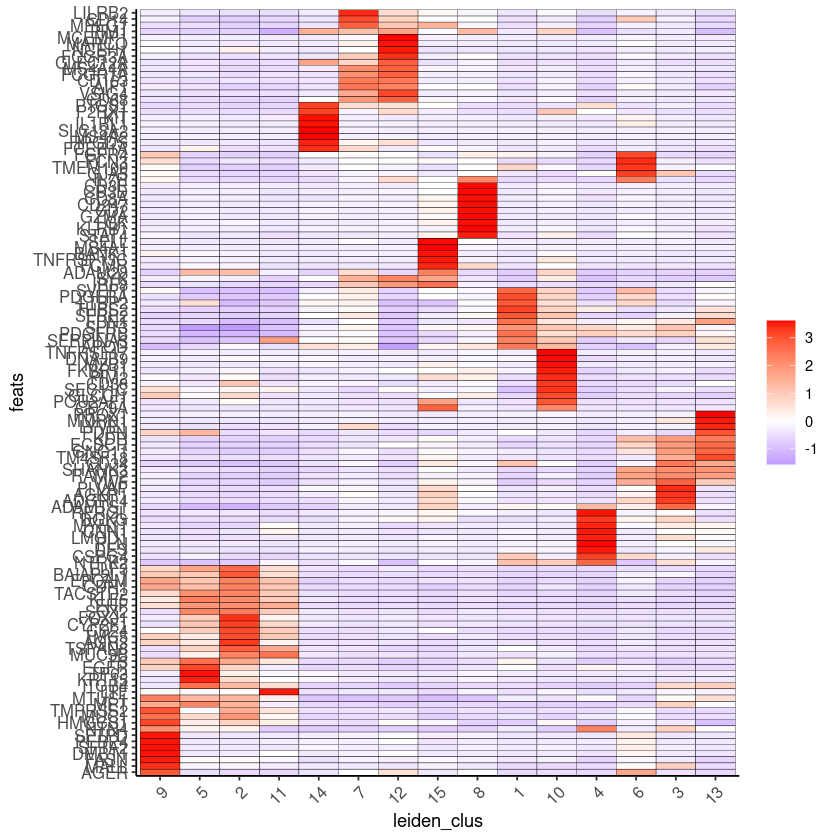

In [67]:
# select the 10 highest ranked markers by leiden cluster
top_markers <- markers_scran[, head(.SD, 10), by = "cluster"]

# Plot marker genes' expression
plotMetaDataHeatmap(xen1,
    selected_feats = unique(top_markers$feats),
    metadata_cols = "leiden_clus"
)

In [68]:
# Cell Typing
writeChatGPTqueryDEG(top_markers, tissue_type = "human bronchi")


 start writing 


# Claude results

I'll identify the cell types in human bronchi tissue based on the marker genes provided. Here's each cell type with its corresponding markers:

1. Fibroblasts - APOD, SFRP2, LTBP2, FBN1, PDGFRB, PDGFRA, SERPINA3, THBS2, SVEP1, SLIT3
2. Ciliated Epithelial Cells - FOXJ1, CYP2F1, TMC5, CD24, ELF3, SOX2, TACSTD2, AGR3, BAIAP2L1, EHF
3. Endothelial Cells - VWF, PLVAP, ADGRL4, ACKR1, SHANK3, CD34, ECSCR, GNG11, ADAMTS1, RAMP2
4. Smooth Muscle Cells - MYH11, CNN1, LMOD1, DES, PLN, CSPG4, NTRK2, NTN4, RERGL, DGKG
5. Basal Epithelial Cells - KRT15, F3, KLF5, TP63, ITGB4, SOX2, TACSTD2, EGFR, EHF, MET
6. Alveolar Type I Cells - FCN3, TMEM100, SHANK3, IL7R, VWF, RAMP2, FGFR4, CD14, GJA5, AGER
7. Macrophages - MPEG1, CD14, AIF1, CD68, LILRB2, CD163, VSIG4, FCGR1A, SYK, MS4A4A
8. T Cells - CD2, CD3E, CD3D, CD247, KLRB1, LCK, GZMA, STAT4, IL7R, CD8A
9. Alveolar Type II Cells - SFTPD, MUC1, PEBP4, TMPRSS2, MALL, FASN, HMGCS1, DMBT1, MTUS1, SFTA2
10. Plasma Cells - MZB1, PIM2, SEC11C, DNAJB9, POU2AF1, CD79A, CD38, FKBP11, TNFRSF17, GLCCI1
11. Secretory/Club Cells - MUC5B, LTF, EHF, SERPINA3, TSPAN8, TACSTD2, KLF5, EPCAM, SOX2, CDH1
12. Alveolar Macrophages - MARCO, MCEMP1, CD68, FCGR3A, VSIG4, AIF1, NCEH1, SYK, FCGR1A, CLEC12A
13. Lymphatic Endothelial Cells - MMRN1, LYVE1, PROX1, ECSCR, GNG11, TM4SF18, SHANK3, PDPN, KDR, CD34
14. Mast Cells - KIT, MS4A2, SLC18A2, IL1RL1, HPGDS, P2RX1, PTGS1, CLEC12A, FCER1A, PIM1
15. B Cells - MS4A1, BANK1, CD79A, FCMR, SELL, TNFRSF13C, IRF8, POU2AF1, ADAM28, SYK

We can then add these labels to our Giotto object through the `annotateGiotto()` function. This amends our cell metadata with the new cluster labels. The labels are added based on merging with the Leiden cluster labels through naming the annotation vector `1:15`. Ensure that the order of cluster labels corresponds to the order of the Leiden Clusters otherwise clusters will be mislabeled.

In [69]:
# annotate clusters
ann <- c(
    "Fibroblasts", "Ciliated Epithelial Cells", "Endothelial Cells", "Smooth Muscle Cells", "Basal Epithelial Cells",
    "Alveolar Type I Cells", "Macrophages", "T Cells", "Alveolar Type II Cells", "Plasma Cells",
    "Secretory Cells", "Alveolar Macrophages", "Lymphatic Endothelial Cells", "Mast Cells", "B Cells"
)
names(ann) <- 1:15
xen1 <- annotateGiotto(xen1,
    annotation_vector = ann,
    cluster_column = "leiden_clus",
    name = "cell_types"
)

We can then visualize these in the UMAP space or spatially on the tissue.

plot polygon layer done



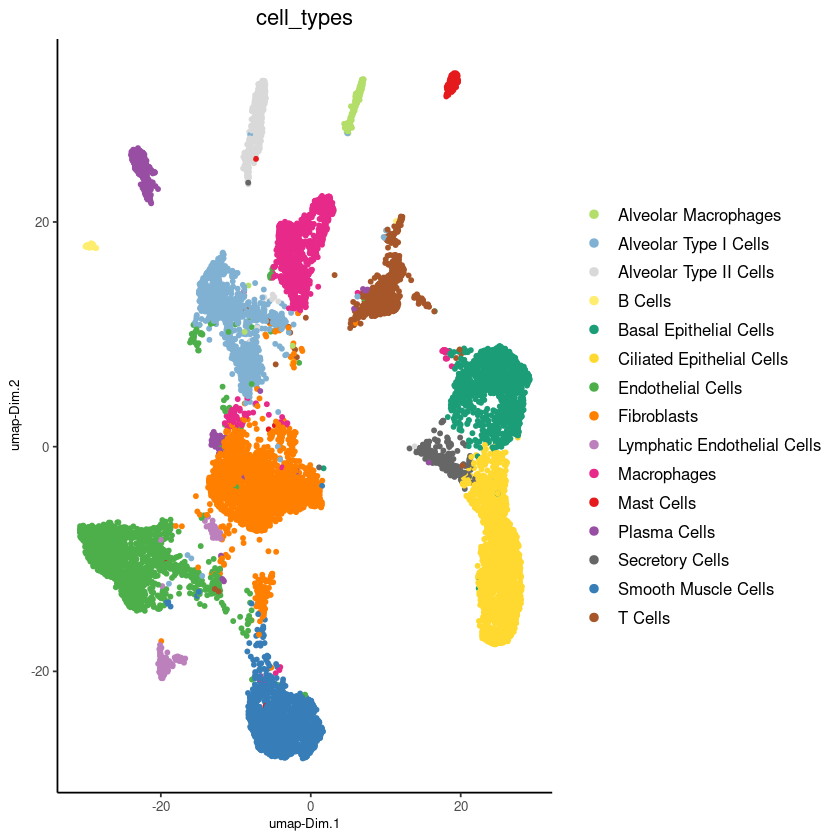

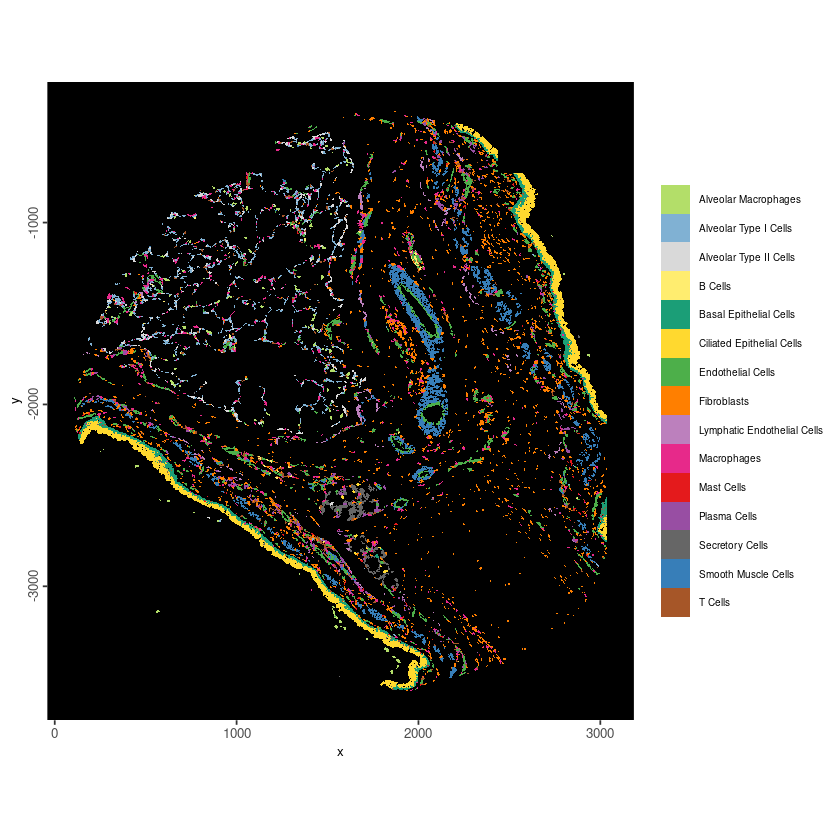

In [70]:
plotUMAP(xen1,
    cell_color = "cell_types",
    feat_type = "rna",
    show_center_label = FALSE,
    point_shape = "no_border"
)
spatInSituPlotPoints(xen1,
    polygon_feat_type = "ucs",
    polygon_fill = "cell_types",
    polygon_fill_as_factor = TRUE,
    polygon_line_size = 0
)

We can also check where these marker genes reside in the UMAP space using the `dimFeatPlot2D()` function that takes a vector of features and plots their expression onto cells in UMAP. We can change the color gradient through the `cell_color_gradient` variable.

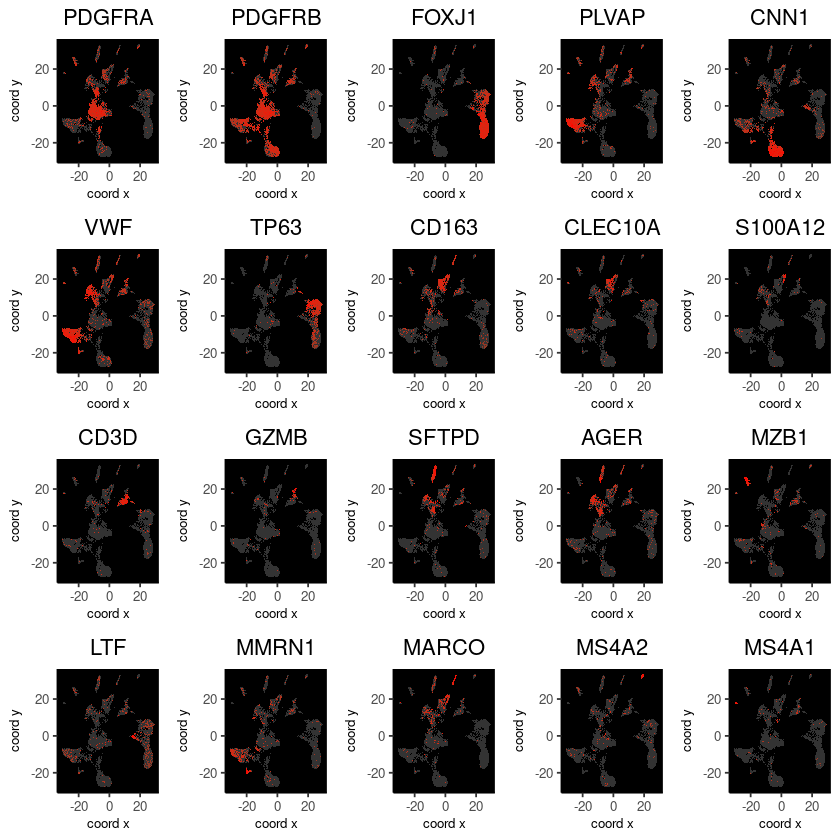

In [71]:
# genes selected based on review of literature, cross referencing human protein atlas, and AI
# https://www.proteinatlas.org/ --> single-cell tab --> tissues: lung
dimFeatPlot2D(xen1,
    feat_type = "rna",
    feats = c(
        "PDGFRA",             # fibroblast
        "PDGFRB",             # pericyte
        "FOXJ1",              # ciliated
        "PLVAP",              # microvascular (capillary) endothelial
        "CNN1",               # smooth muscle
        "VWF" ,               # macrovascular (arterial/venous) endothelial
        "TP63",               # basal epithelial
        "CD163",              # monocyte-derived / alveolar macrophages
        "CLEC10A",            # dendritic
        "S100A12",            # granulocytes
        "CD3D",               # t cell
        "GZMB",               # nk / t
        "SFTPD",              # alveolar type II
        "AGER",               # alveolar type I
        "MZB1",               # plasma / b
        "LTF",                # secretory / goblet
        "MMRN1",              # lymphatic endothelial
        "MARCO",              # alveolar macrophage
        "MS4A2",              # mast
        "MS4A1"               # b cell
    ),
    point_size = 0.1,
    point_border_stroke = 0,
    background_color = "black",
    cow_n_col = 5,
    show_legend = FALSE,
    cell_color_gradient = c("#333333", "red")
)

If we want to check the expression of the marker genes by cluster we can using the `dotPlot()` function to plot a points that correspond to the expression level (color) and the number of cells within that cluster expressing each marker (size).

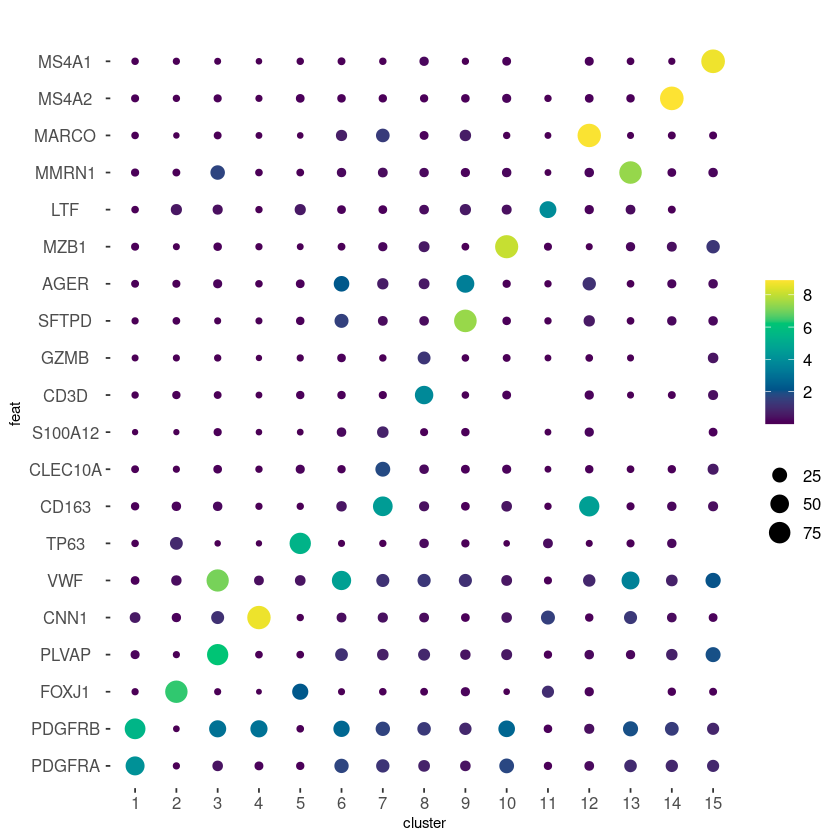

In [72]:
# Another way of displaying marker specificity:
dotPlot(xen1,
    feat_type = "rna",
    feats = c(
        "PDGFRA",             # fibroblast
        "PDGFRB",             # pericyte
        "FOXJ1",              # ciliated
        "PLVAP",              # microvascular (capillary) endothelium
        "CNN1",               # smooth muscle
        "VWF" ,               # macrovascular (arterial/venous) endothelium
        "TP63",               # basal
        "CD163",              # monocyte-derived / alveolar macrophages
        "CLEC10A",            # dc
        "S100A12",            # granulocytes
        "CD3D",               # t cell
        "GZMB",               # nk / t
        "SFTPD",              # alveolar type II
        "AGER",               # alveolar type I
        "MZB1",               # plasma / b
        "LTF",                # goblet
        "MMRN1",              # lymphatic endothelial
        "MARCO",              # alveolar macrophage
        "MS4A2",              # mast
        "MS4A1"               # b cell
    ),
    cluster_column = "leiden_clus",
    dot_size = function(x) mean(x != 0) * 100, # % cells in cluster expressing
    dot_size_threshold = 0,
    dot_scale = 6,
    dot_color = mean,
    dot_color_gradient = NULL,
    gradient_midpoint = NULL,
    gradient_style = "sequential",
    gradient_limits = NULL,
    expression_values = "normalized"
)

Finally, if we want to check the expression within the tissue we can use the use the `spatFeatPlot2D()` function that takes a list of features and plots the expression of feature per cell.

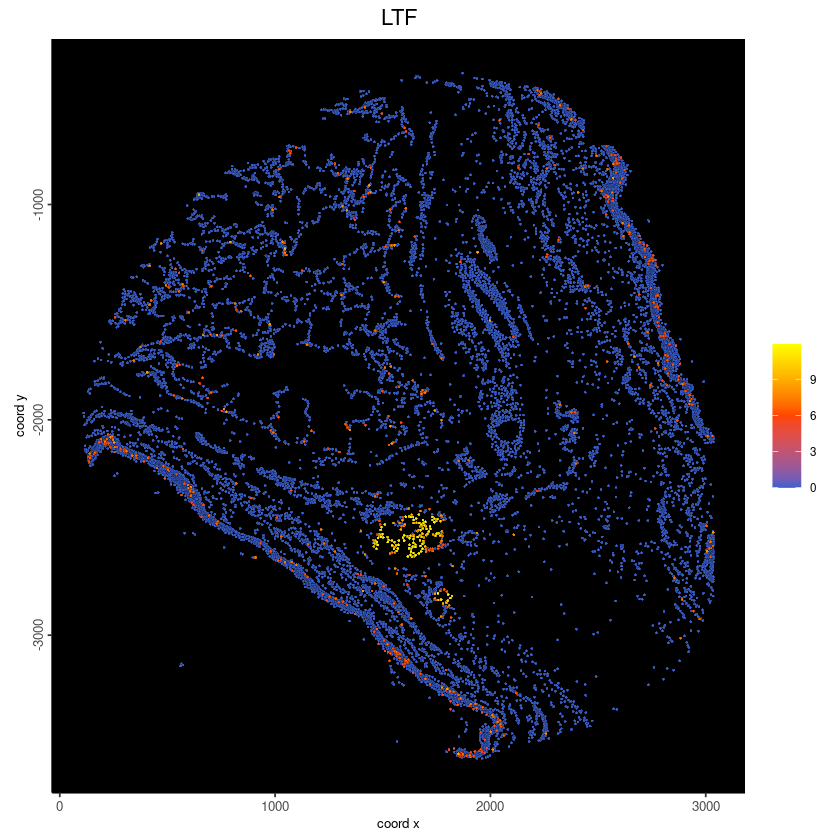

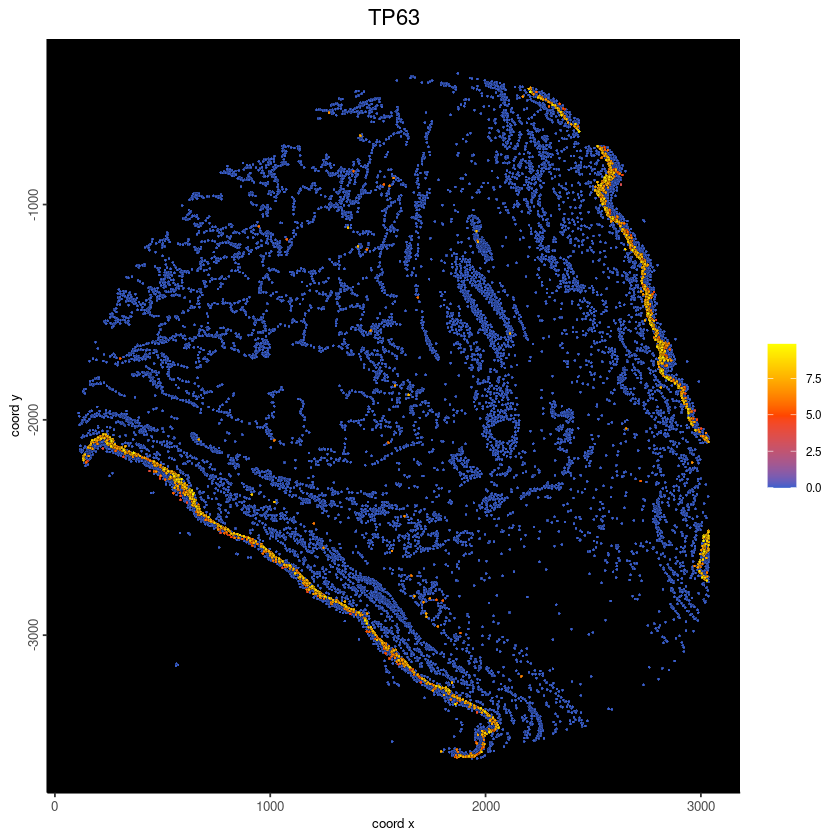

In [73]:
spatFeatPlot2D(xen1,
    cell_color_gradient = c("royalblue3", 'orangered', "yellow"),
    expression_values = "normalized",
    gradient_style = "s",
    feats = c("LTF"), #secretory cells
    point_size = 0.75,
    background_color = "black",
    legend_text = 7
)

spatFeatPlot2D(xen1,
    cell_color_gradient = c("royalblue3", 'orangered', "yellow"),
    expression_values = "normalized",
    gradient_style = "s",
    feats = c("TP63"), #basal cells
    point_size = 0.75,
    background_color = "black",
    legend_text = 7
)

## Niche clustering

Tissues are organized into niches of multiple cell types. Knowing about the composition of these niches can suggest things about their function and phenotype.
However, how do we actually define niches?

A commonly used method is by finding groups of similar combinations of labels per spatial region

### Network based niches

Spatial networks are one way that we can define a spatial region and group of cells from which to extract a cell composition signature
For each node, we can look at its spatial neighbors as defined by the network and determine extract a label composition signature that way.

Setting spatial network [ucs] Delaunay_network



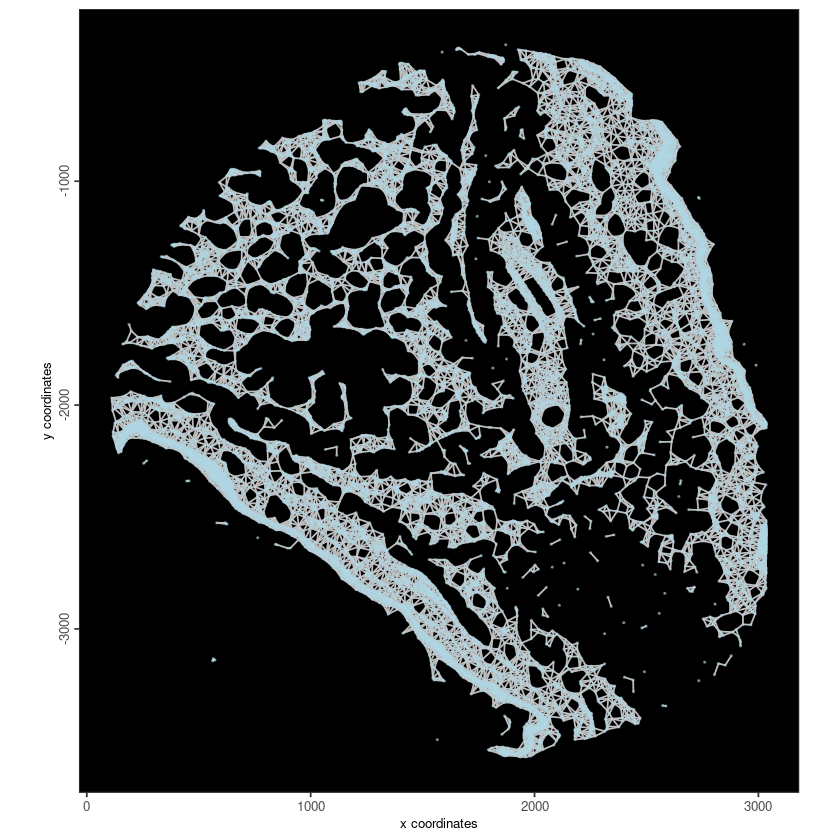

In [74]:
xen1 <- createSpatialNetwork(xen1, spat_unit = "ucs", type = "Delaunay")

# visualize network
spatPlot2D(xen1,
    point_shape = "no_border",
    show_network = TRUE,
    point_size = 0.25,
    point_alpha = 0.5,
    network_color = "grey",
    background_color = "black"
)

In [75]:
xen1 <- calculateSpatCellMetadataProportions(xen1,
    spat_network = "Delaunay_network",
    metadata_column = "cell_types",
    name = "celltypes_niche"
)
# this gets stored as a new spatial enrichment

In [76]:
# retrive proportions of leiden clusters info
prop_table <- getSpatialEnrichment(xen1,
    name = "celltypes_niche",
    output = "data.table"
)

# convert to matrix
prop_matrix <- GiottoUtils::dt_to_matrix(prop_table)

# kmeans clustering to define niches based on proportions
set.seed(1234) # make kmeans clustering reproducible

prop_kmeans <- kmeans(
    x = prop_matrix,
    centers = 4, # controls how many clusters will be formed
    iter.max = 1000,
    nstart = 100
)

prop_kmeansDT = data.table::data.table(
    cell_ID = names(prop_kmeans$cluster),
    niche = prop_kmeans$cluster
)

# return kmeans clustering on niche to gobject
xen1 <- addCellMetadata(xen1,
    new_metadata = prop_kmeansDT,
    by_column = TRUE,
    column_cell_ID = "cell_ID"
)

plot polygon layer done



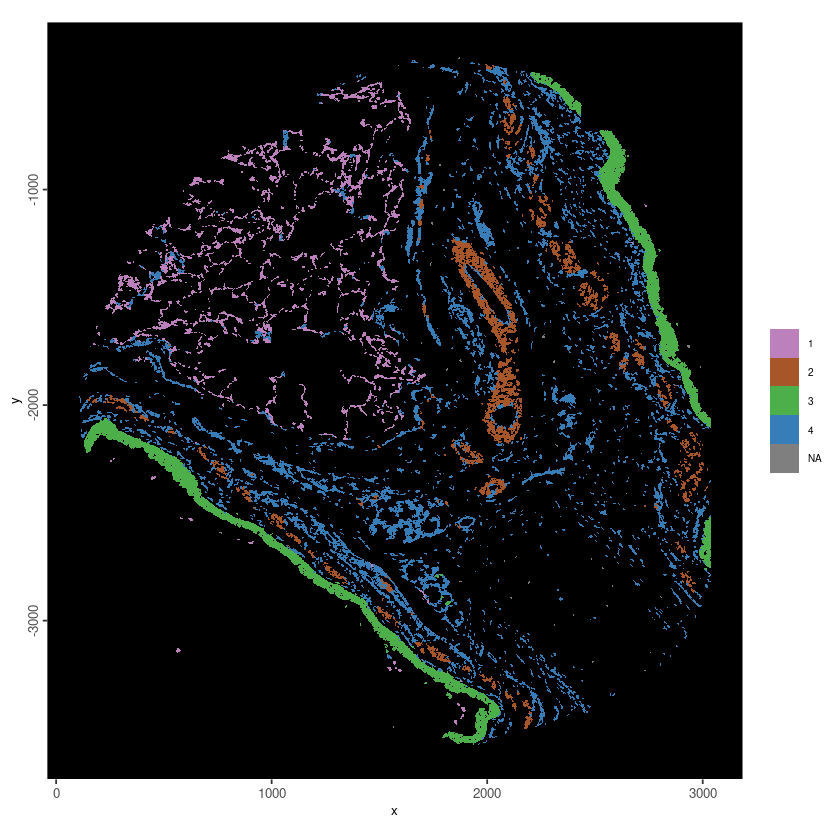

In [77]:
# visualize niches
spatInSituPlotPoints(xen1,
    polygon_feat_type = "ucs",
    polygon_fill_as_factor = TRUE,
    polygon_fill = "niche",
    polygon_color = "black",
    polygon_line_size = 0,
    # polygon_fill_code = getColors("Accent", 4),
    polygon_alpha = 1
)

Getting values from [ucs][rna] cell metadata



[1] 32

Getting values from [ucs][rna] cell metadata



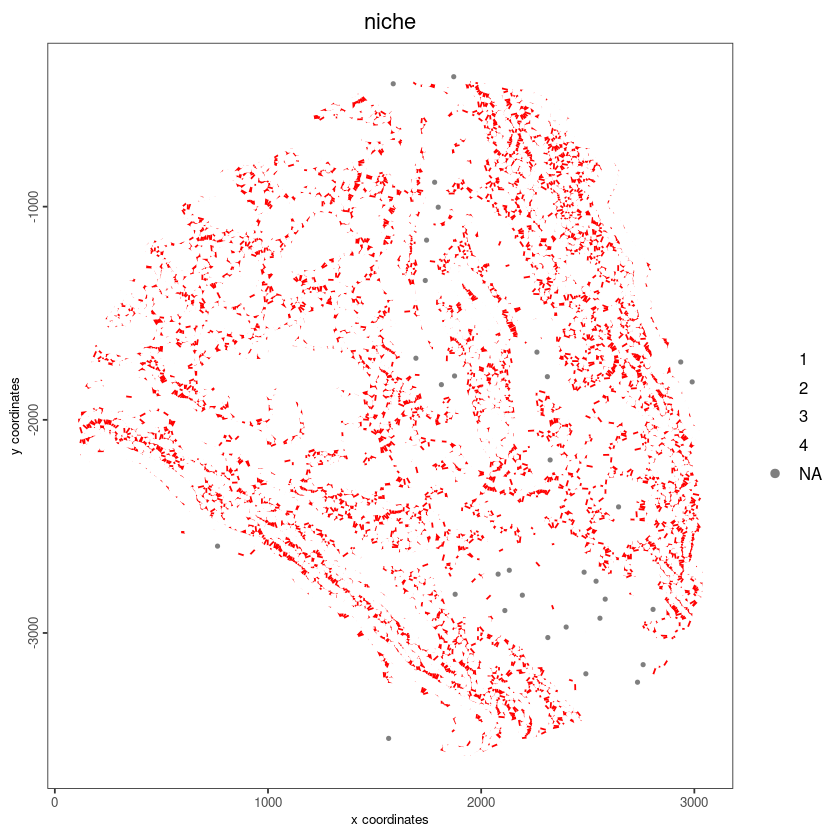

In [78]:
# there is a NA group. What are these?
xen1$niche |> is.na() |> sum()

spatPlot2D(xen1,
    cell_color = "niche",
    cell_color_code = c(rep("white", length(unique(xen1$niche)))),
    point_size = 0.8,
    color_as_factor = TRUE,
    show_network = TRUE,
    point_shape = "no_border"
)
# these are the cells that had no neighbors on the spatial network and were not in the spatial enrichment.

Warning message:
“Removed 32 rows containing missing values or values outside the scale range
(`geom_bar()`).”


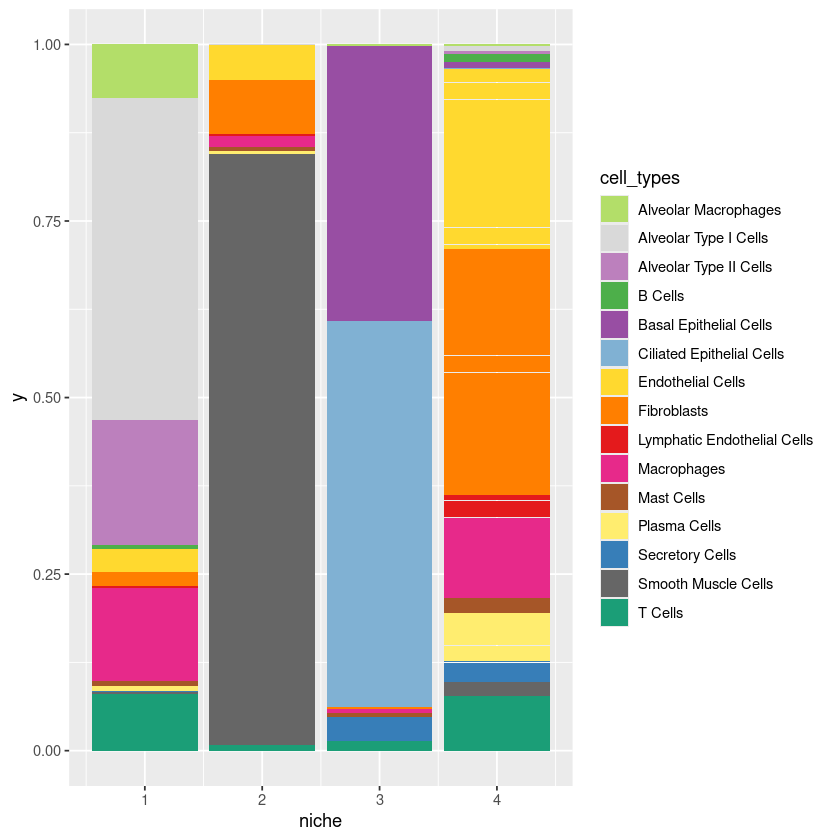

In [79]:
# visualize niche makeup
cellmeta <- pDataDT(xen1)

ggplot2::ggplot(cellmeta,
    ggplot2::aes(fill = cell_types,
        y = 1,
        x = niche
    )
) +
    ggplot2::geom_bar(position = "fill", stat = "identity") +
    ggplot2::scale_fill_manual(values = c(
        "#B3DE69", "#D9D9D9", "#BC80BD", "#4DAF4A", "#984EA3",
        "#80B1D3", "#FFD92F", "#FF7F00", "#E41A1C", "#E7298A", "#A65628",
        "#FFED6F", "#377EB8", "#666666", "#1B9E77")
    )

## Bin-based niches

Another way to find niches is to use a spatial window as a way to define a group of cells from which to extract a label composition.

In [80]:
e <- ext(xen1)
e

SpatExtent : 0, 3039.8125, -3635.2375, 0 (xmin, xmax, ymin, ymax)

4980 polygons generated



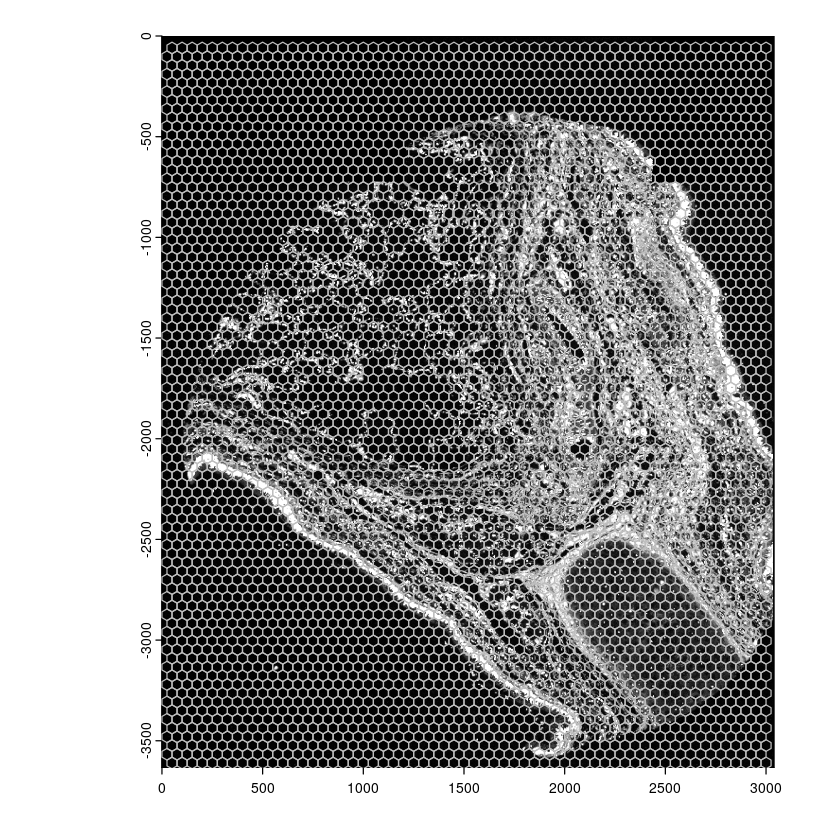

In [81]:
# basic hexbin across giotto object extent
hexbin <- tessellate(
    extent = e,
    shape = "hexagon",
    shape_size = 50 # this is the x width
)
plot(getGiottoImage(xen1), max_intensity = 200)
plot(hexbin, add = TRUE, border = "grey")

4980 polygons generated



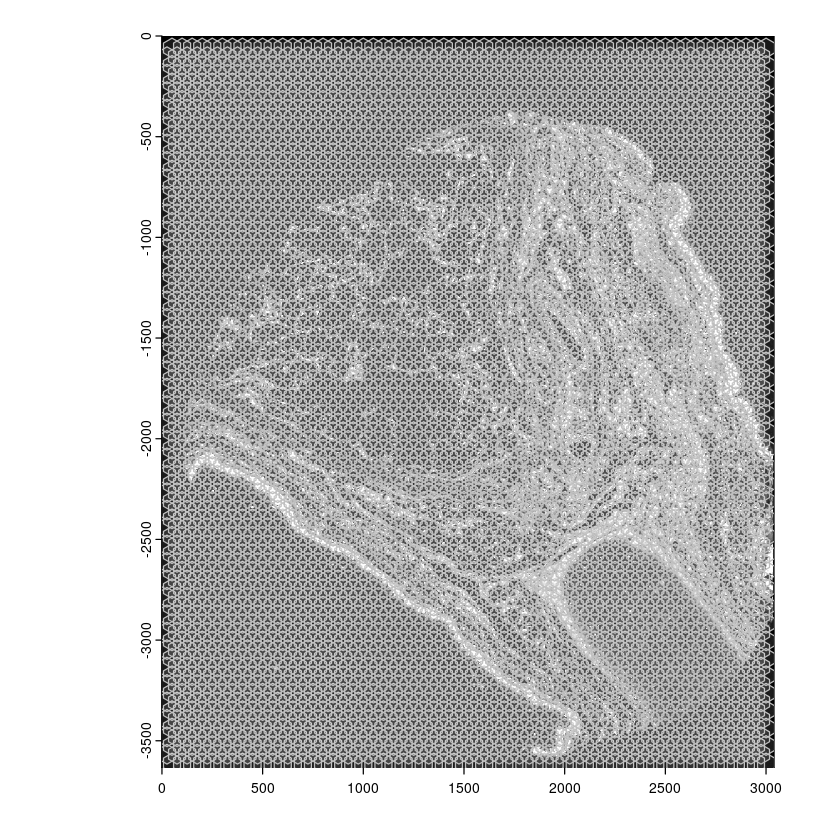

In [82]:
# hexbin with overlaps
hexbin <- tessellate(extent = e, shape = "hexagon", shape_size = 50, gap = -20, name = "hex_niche")
plot(getGiottoImage(xen1),
     max_intensity = 200,
     # ext = c(600, 800, -2000, -1800)
)
plot(hexbin, add = TRUE, border = "grey", col = "white", alpha = 0.1)

In [83]:
hexbin

An object of class giottoPolygon
spat_unit : "hex_niche"
Spatial Information:
 class       : SpatVector 
 geometry    : polygons 
 dimensions  : 4980, 1  (geometries, attributes)
 extent      : -17.32051, 3042.321, -3659.105, -10.66583  (xmin, xmax, ymin, ymax)
 coord. ref. :  
 names       : poly_ID
 type        :   <chr>
 values      :    ID_1
                  ID_2
                  ID_3
 centroids   : NULL
 overlaps    : NULL

In [84]:
hex_rels <- relate(
    hexbin,
    getPolygonInfo(xen1, polygon_name = "ucs", return_giottoPolygon = TRUE), relation = "intersects"
)
names(hex_rels) <- c("hex_ID", "cell_ID")
head(hex_rels)

hex_ID,cell_ID
<chr>,<chr>
ID_37,cell_8987
ID_37,cell_8988
ID_37,cell_8967
ID_37,cell_8971
ID_38,cell_8986
ID_38,cell_8985


In [85]:
ct <- spatValues(xen1, feats = "cell_types")
hex_rels <- merge(hex_rels, ct, by = "cell_ID")
head(hex_rels)

Getting values from [ucs][rna] cell metadata



cell_ID,hex_ID,cell_types
<chr>,<chr>,<chr>
cell_1,ID_1472,Secretory Cells
cell_1,ID_1473,Secretory Cells
cell_1,ID_1533,Secretory Cells
cell_1,ID_1534,Secretory Cells
cell_10,ID_633,Basal Epithelial Cells
cell_10,ID_693,Basal Epithelial Cells


In [86]:
# Step 1: Get counts of each cell type by hex_ID
hex_ct_counts <- hex_rels[, .N, by = .(hex_ID, cell_types)]

# Step 2: Calculate the total count per hex_ID
hex_totals <- hex_rels[, .N, by = hex_ID]

# Step 3: Merge and calculate proportions
hex_ct_props <- merge(hex_ct_counts, hex_totals, by = "hex_ID")
hex_ct_props[, proportion := N.x / N.y]

hex_ct_props_wide <- data.table::dcast.data.table(hex_ct_props, formula = "hex_ID~cell_types", fill = 0, value.var = "proportion")

In [87]:
# set up spat unit in preparation for plotting
xen1 <- setGiotto(xen1, hexbin)
xen1 <- addSpatialCentroidLocations(xen1, poly_info = "hex_niche")

Setting polygon info [hex_niche]

Warning message in FUN(X[[i]], ...):
“spat_unit: ucs feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”
Start centroid calculation for polygon information
 layer: hex_niche



In [88]:
# convert to matrix
prop_matrix <- GiottoUtils::dt_to_matrix(hex_ct_props_wide)

# kmeans clustering to define niches based on proportions
set.seed(1234) # make kmeans clustering reproducible

prop_kmeans <- kmeans(
    x = prop_matrix,
    centers = 6, # controls how many clusters will be formed
    iter.max = 1000,
    nstart = 100
)

prop_kmeansDT = data.table::data.table(
    cell_ID = names(prop_kmeans$cluster),
    niche = prop_kmeans$cluster
)

# return kmeans clustering on niche to gobject
if ("niche" %in% names(xen1@cell_metadata$hex_niche$rna[])) {
    # just to help with re-runs.
    xen1@cell_metadata$hex_niche$rna[][, niche := NULL]
}
xen1@cell_metadata$hex_niche$rna[] <- merge(xen1@cell_metadata$hex_niche$rna[], prop_kmeansDT, by = "cell_ID")

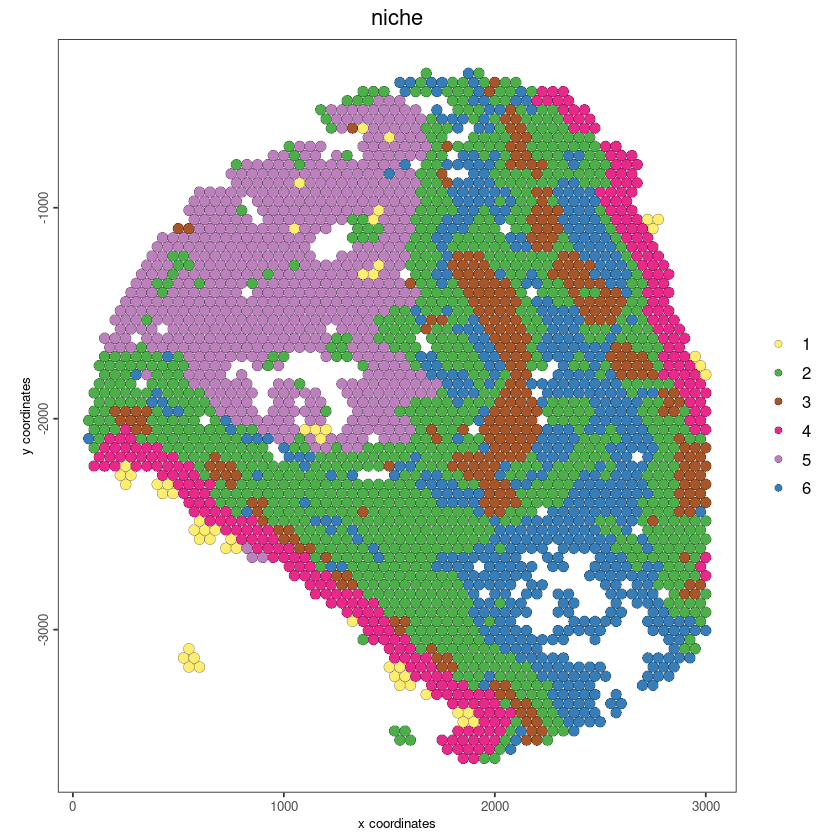

In [89]:
spatPlot2D(xen1, spat_unit = "hex_niche", cell_color = "niche")

Another thing that we can do now that we have this smoothed label information is plot the composition signatures.

There are non numeric or integer columns for the spatial
 enrichment input at column position(s): 1
 The first non-numeric column will be considered as a cell ID to test for
 consistency with the expression matrix.
 Other non-numeric columns will be removed.

Setting spatial enrichment [hex_niche][rna] celltypes_niche

Warning message in FUN(X[[i]], ...):
“spat_unit: ucs feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”
Warning message in FUN(X[[i]], ...):
“spat_unit: hex_niche feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”


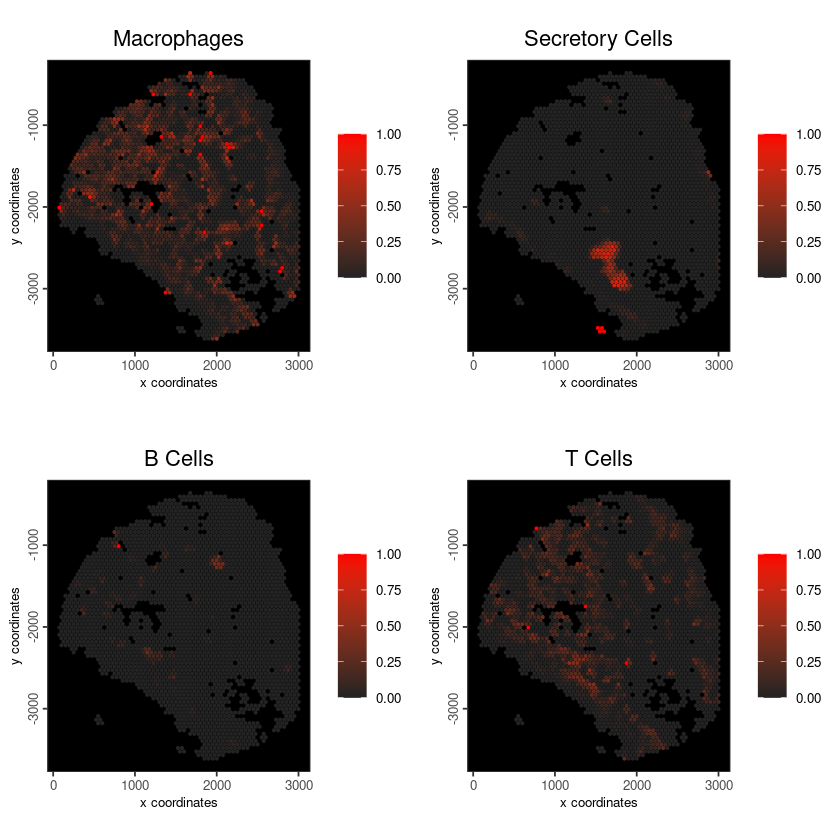

In [90]:
data.table::setnames(hex_ct_props_wide, old = "hex_ID", new = "cell_ID")
enr <- createSpatEnrObj(hex_ct_props_wide,
    name = "celltypes_niche",
    spat_unit = "hex_niche",
    feat_type = "rna"
)
xen1 <- setGiotto(xen1, enr)
spatCellPlot(xen1,
    point_size = 0.5,
    point_shape = "no_border",
    spat_unit = "hex_niche",
    spat_enr_names = "celltypes_niche",
    cell_annotation_values = c("Macrophages", "Secretory Cells", "B Cells", "T Cells"),
    background_color = "black",
    cell_color_gradient = c("#232323", "red")
)

## Cell type proximity

`cellProximityEnrichment()` calculates the observed vs the expected frequency of cell-cell interactions.

You start with the spatial network, then you do multiple iterations of randomizing the node IDs.

The average frequency of interactions between two celltypes is calculated this way.

If the true frequency is higher, then you find an enrichment.

In [91]:
leiden_ct_prox <- cellProximityEnrichment(xen1,
    cluster_column = "cell_types",
    spatial_network_name = "Delaunay_network",
    adjust_method = "fdr",
    number_of_simulations = 1000
)

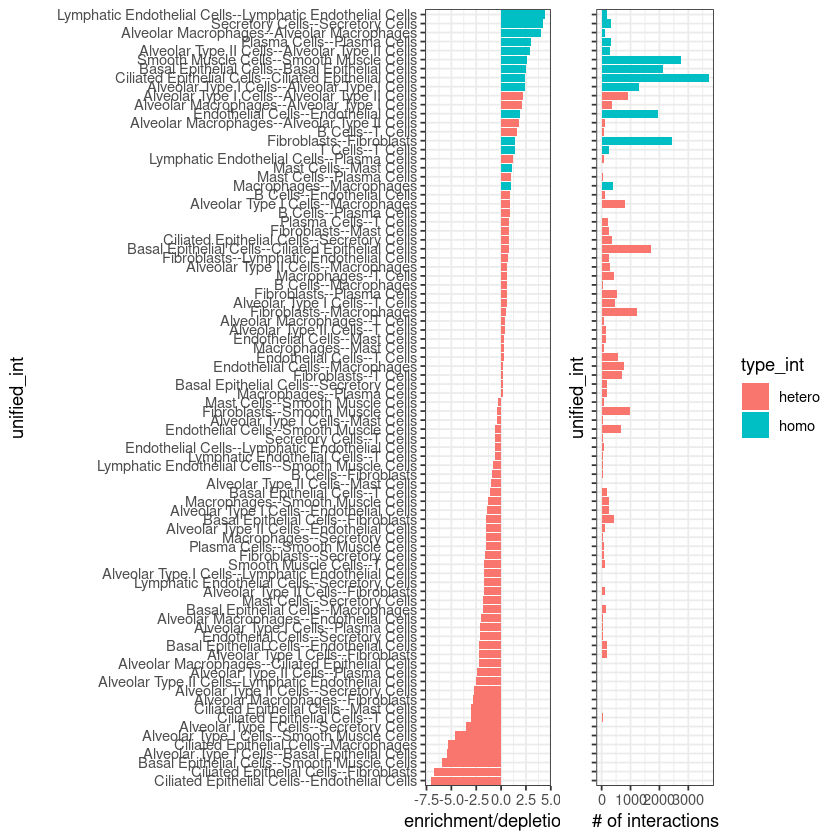

In [92]:
cellProximityBarplot(xen1,
    CPscore = leiden_ct_prox,
    min_orig_ints = 5, # minimum original cell-cell interactions
    min_sim_ints = 5 # minimum simulated cell-cell interactions
)

# plot is color coded by self vs non-self interactions.

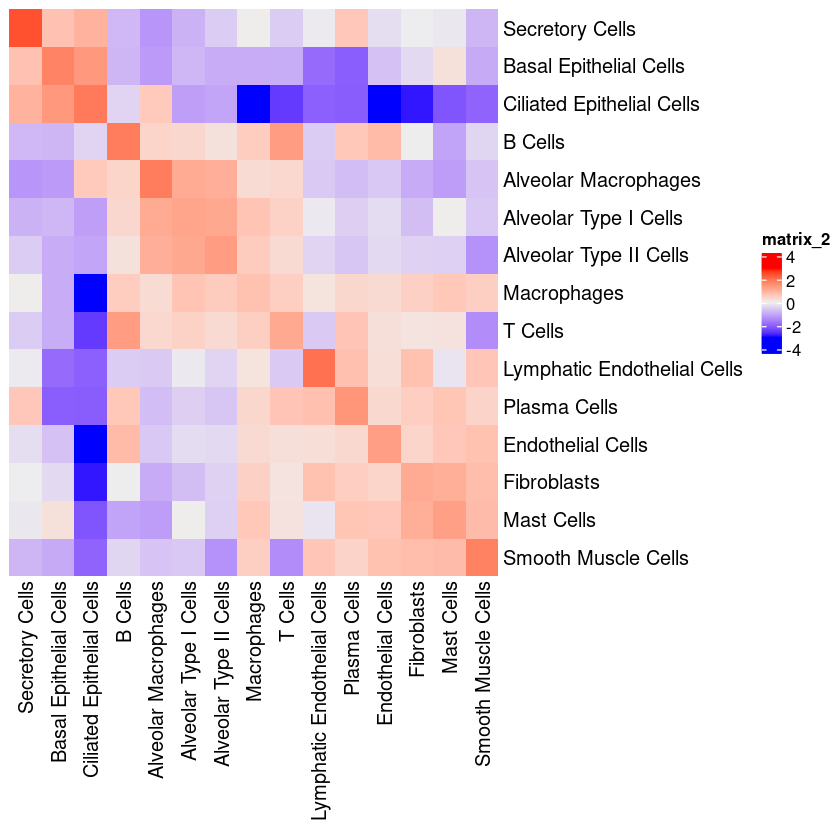

In [93]:
# plot the heatmap visualization for these results
cellProximityHeatmap(xen1, CPscore = leiden_ct_prox)

plot image layer done

plot polygon layer done



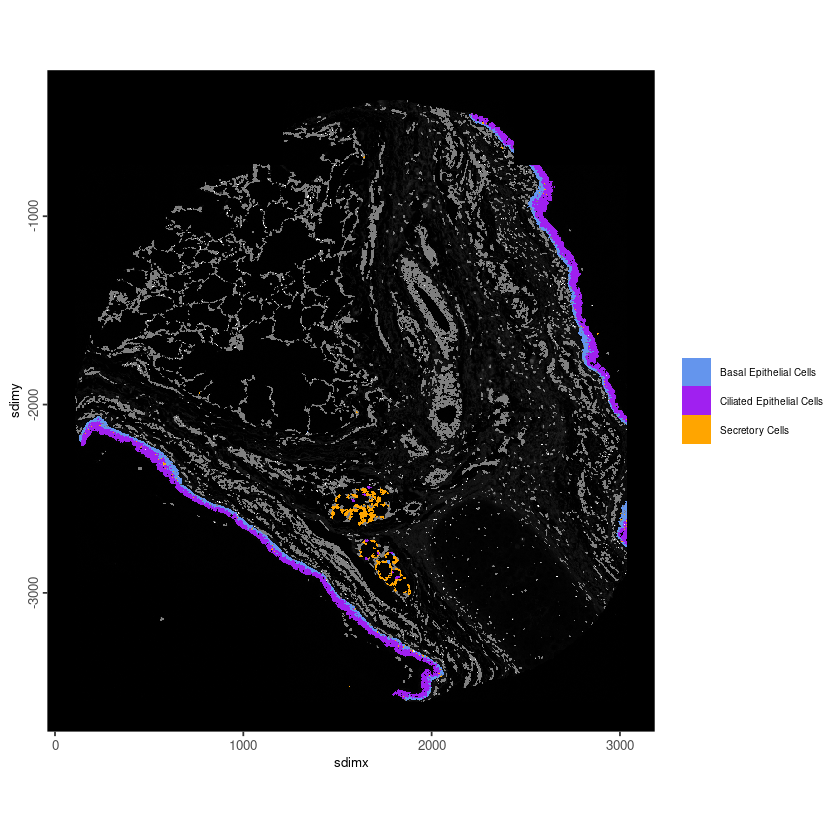

In [94]:
other_cell_color <- rep("grey", 15)
int_Secretory_Ciliated <- int_Secretory_Endo <- other_cell_color
int_Secretory_Ciliated[c("Secretory cells", "Ciliated epithelial cells")] <- c("orange", "cornflowerblue")
int_Secretory_Endo[c("Secretory cells", "PLVAP- endothelial cells")] <- c("orange", "cornflowerblue")

spatInSituPlotPoints(xen1,
    polygon_feat_type = "ucs",
    polygon_fill = "cell_types",
    polygon_fill_as_factor = TRUE,
    polygon_fill_code = c(
        "Secretory Cells" = "orange",
        "Basal Epithelial Cells" = "cornflowerblue",
        "Ciliated Epithelial Cells" = "purple"
    ),
    polygon_line_size = 0,
    polygon_alpha = 1,
    show_image = TRUE
)

plot image layer done

plot polygon layer done



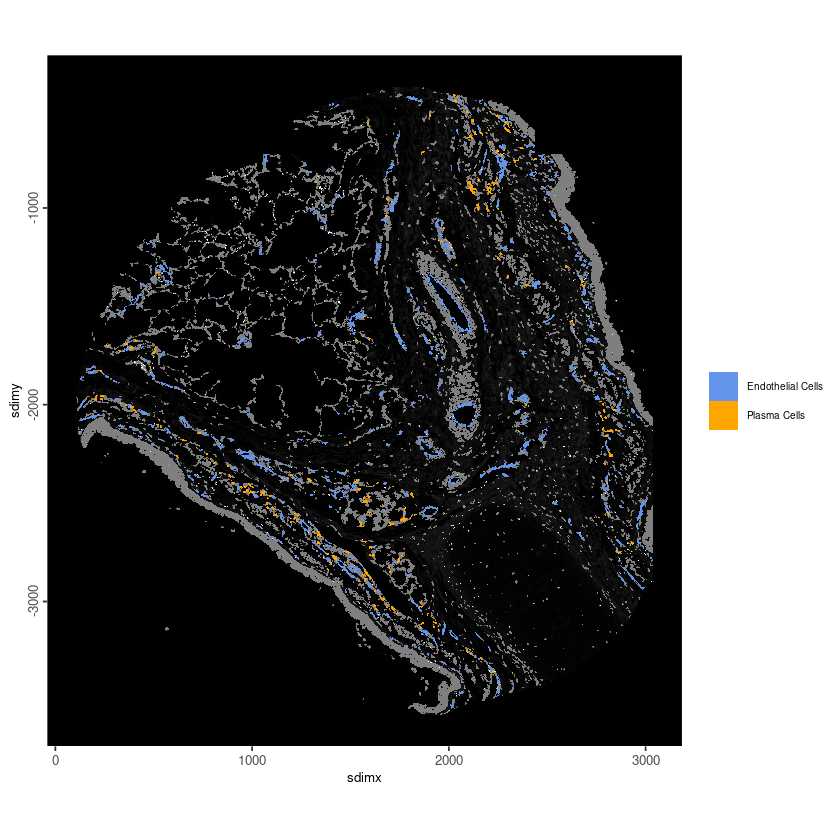

In [95]:
spatInSituPlotPoints(xen1,
    polygon_feat_type = "ucs",
    polygon_fill = "cell_types",
    polygon_fill_as_factor = TRUE,
    polygon_fill_code = c(
        "Plasma Cells" = "orange",
        "Endothelial Cells" = "cornflowerblue"
    ),
    polygon_line_size = 0,
    show_image = TRUE,
    polygon_alpha = 1
)

# Manually selecting regions of interest

We can also select regions manually. Say we've got a particular region within the tissue you're interested in studying. We can use the `plotInteractivePolygons()` function to manually select polygons. This function takes a ggplot object, such as those exported by Giotto plotting functions and allows us to draw polygons on our spatial data. The output from this function is a `data.table` that contains x and y spatial location for all polygons we defined. We won't be performing polygon selection here, however we have a tutorial [here](https://drieslab.github.io/Giotto_website/articles/interactive_selection.html) that explains the process. Instead we're providing a dataframe with all the information output by the function.

We can take these point data to create Giotto polygon data through the `createGiottoPolygonsFromDfr()` function. Note that we set the name to 'selections'. This can be anything but try not to use the same name as another set of polygons. If we plot these we can see where polygons are localized on the tissue. Finally we can add these to our Giotto object.

In [96]:
polygon_data <- data.frame(
    x = c(1633.6845, 1421.3339, 1232.5778, 1446.7434, 916.7744, 698.9789, 535.6323, 764.3176),
    y = c(-2844.754, -3006.285, -2888.313, -2699.557, -2285.745, -2536.210, -2398.273, -2187.737),
    name = c(rep("polygon 1", 4), rep("polygon 2", 4))
)

rois <- createGiottoPolygonsFromDfr(polygon_data, name = 'selections')

  Selecting col "name" as poly_ID column

  Selecting cols "x" and "y" as x and y respectively



Setting polygon info [selections]

Warning message in FUN(X[[i]], ...):
“spat_unit: ucs feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”
Warning message in FUN(X[[i]], ...):
“spat_unit: hex_niche feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”


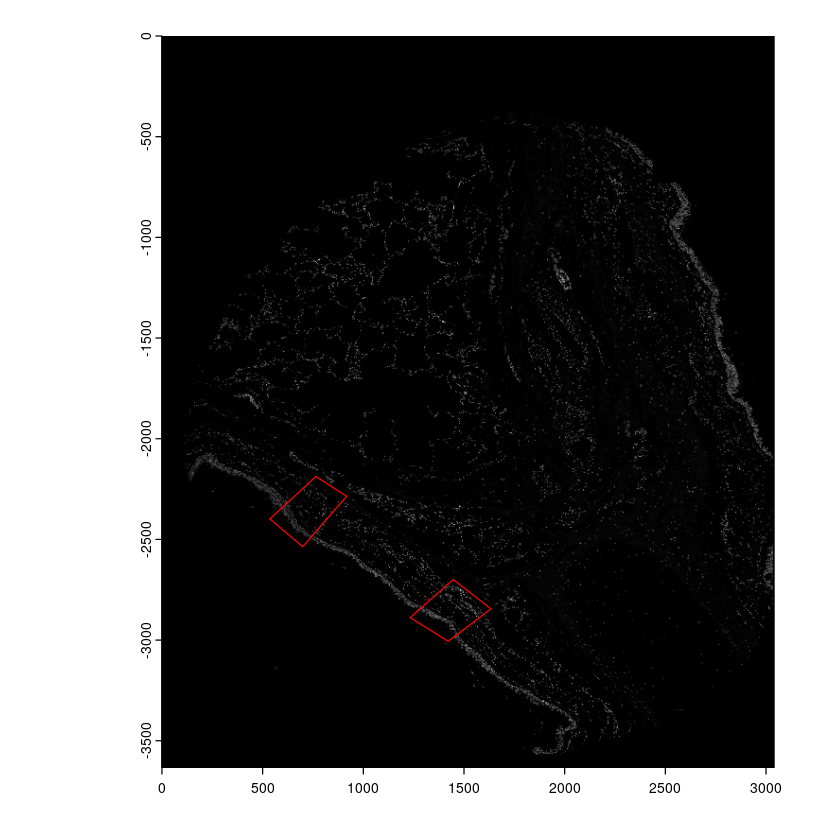

In [97]:
plot(getGiottoImage(xen1, name = "image"))
plot(rois, border="red", lwd=1, add = T)

xen1 <- setGiotto(xen1, rois)

# Classifier imputation for filtered cells

There are a lot of removed cells which disrupt spatial architecture.
Can we try to salvage these?

In [98]:
# record clusters
cluster_info <- spatValues(xen1, feats = c("leiden_clus", "cell_types"))

Getting values from [ucs][rna] cell metadata



In [99]:
head(cluster_info)

cell_ID,leiden_clus,cell_types
<chr>,<dbl>,<chr>
cell_1,11,Secretory Cells
cell_2,11,Secretory Cells
cell_3,4,Smooth Muscle Cells
cell_4,8,T Cells
cell_5,1,Fibroblasts
cell_6,1,Fibroblasts


In [100]:
# new giotto object
test <- giotto(instructions = instrs)
test <- setGiotto(test, list(ucs1, getFeatureInfo(xen1, feat_type = "rna", return_giottoPoints = TRUE)))
test

Setting polygon info [ucs]

Setting feature info [rna]



An object of class giotto 
>Active spat_unit:  ucs 
>Active feat_type:  rna 
dimensions    : 288, 14167 (features, cells)
[SUBCELLULAR INFO]
polygons      : ucs 
features      : rna 
[AGGREGATE INFO]


Use objHistory() to see steps and params used

In [101]:
# feature aggregation (ucs)
test <- calculateOverlap(test, spatial_info = "ucs")
test <- overlapToMatrix(test, poly_info = "ucs") |>
    filterGiotto(expression_threshold = 1,
                 feat_det_in_min_cells = 1,
                 min_det_feats_per_cell = 1) |>
    addStatistics(expression_values = "raw") |>
    normalizeGiotto() |>
    runPCA()

test <- createNearestNetwork(test, dimensions_to_use = pc_use)

1. convert polygon to raster

2. overlap raster and points

3. add polygon information

4. add points information

5. create overlap polygon
 information

completed 1: preparation

completed 2: subset expression data

completed 3: subset spatial locations

completed 4: subset cell metadata

completed 5: subset feature metadata

completed 6: subset spatial network(s)

completed 7: subsetted dimension reductions

completed 8: subsetted nearest network(s)

completed 9: subsetted spatial enrichment results

for ucs

--> ucs found back in polygon layer: ucs

completed 10: subsetted spatial information data

subset feature info: rna

completed 11: subsetted spatial feature data




Feature type:  rna 
Number of cells removed:  120  out of  14167 
Number of feats removed:  0  out of  288 


calculating statistics for "raw" expression

first scale feats and then cells

Setting expression [ucs][rna] normalized

Setting expression [ucs][rna] scaled

"hvf" was not found in the gene metadata information.
 all genes will be used.

Setting dimension reduction [ucs][rna] pca



In [102]:
test <- addCellMetadata(test,
    new_metadata = cluster_info,
    by_column = TRUE,
    column_cell_ID = "cell_ID"
)

plot polygon layer done



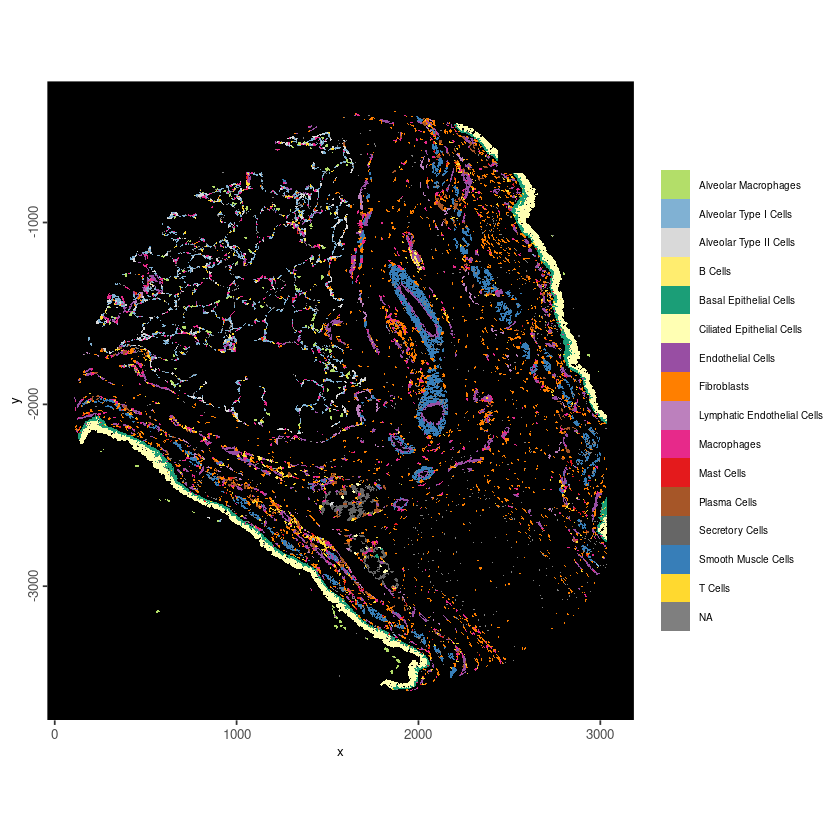

In [103]:
spatInSituPlotPoints(test,
    polygon_feat_type = "ucs",
    polygon_fill = "cell_types",
    polygon_fill_as_factor = TRUE,
    polygon_line_size = 0
)

We have the same annotations from before and lots of NA values

In [104]:
source_ids <- spatIDs(test, spat_unit = "ucs", subset = !is.na(cell_types))
target_ids <- spatIDs(test, spat_unit = "ucs", subset = is.na(cell_types))
length(source_ids)
length(target_ids)

[1] 12447

[1] 1600

In [105]:
# kNN classifier label imputation
test <- labelTransfer(test,
    labels = "cell_types",
    name = "knn_cell_types",
    source_cell_ids = source_ids,
    target_cell_ids = target_ids
)

plot polygon layer done



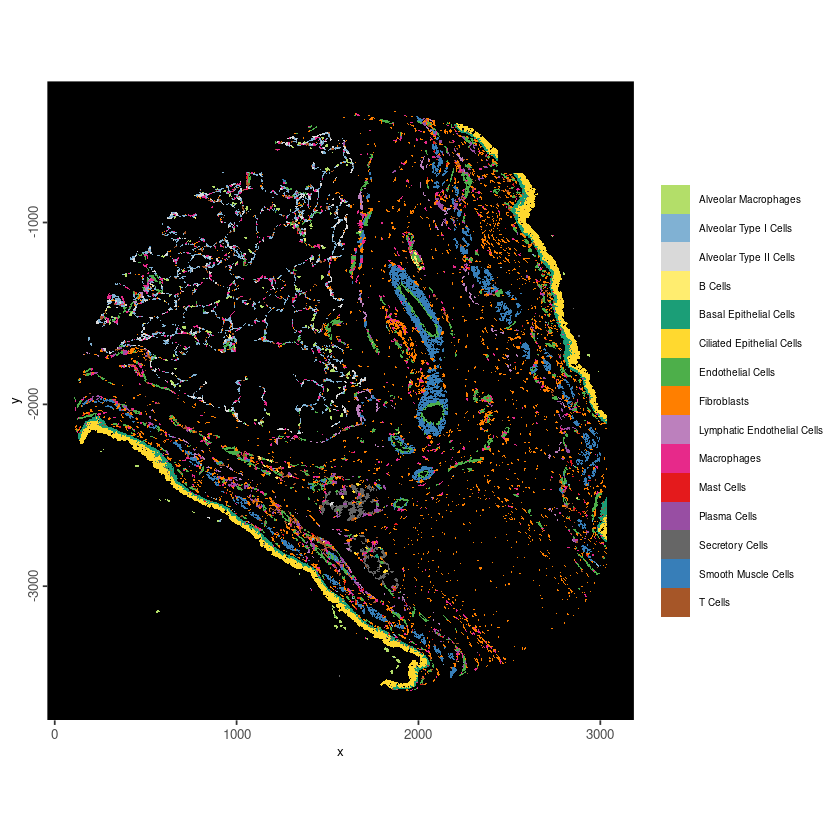

In [106]:
spatInSituPlotPoints(test,
    polygon_feat_type = "ucs",
    polygon_fill = "knn_cell_types",
    polygon_fill_as_factor = TRUE,
    polygon_line_size = 0
)

# Part 2 - Phenocycler Data

The PhenoCycler (formerly CODEX) is a protein-based spatial omics platform developed by Akoya Biosciences. The PhenoCycler uses an iterative imaging workflow to identify proteins bound antibodies conjugated to specific nucleotide barcodes. Each barcode binds to complementary fluorescent probes that are decoded to identify the specific protein and the spatial location. The output from the phenocycler is a stitched `QPTIFF` that contains images for each of the proteins assayed.

This dataset also includes a set of phenocycler data with 45 biomarkers imaged + DAPI

`Segmented_Bronchi_TMA_Scan1.er.qptiff`

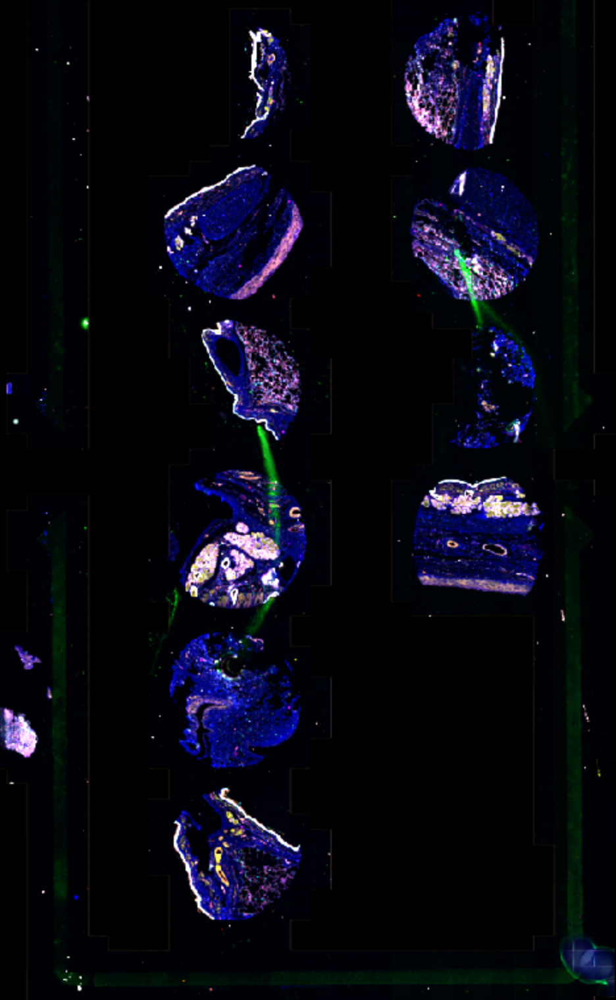

This is the same slide as the Xenium. There are small differences in morphology compared to the Xenium data, mainly due to the fact that it was run after the Xenium run completed, which may have allowed some microlifting or shrinking of tissue to occur.

Giotto heavily uses {terra} for image operations and is not directly compatible with `.qptiff`/`.ome.tiff` formats.
So, we exported subsets of the main phenocycler output using QuPath (drawing rectangle annotation + `File` -> `Export images...` -> `Original pixels`)

These can be found as

* `TMA2/giotto_premade/region_1.tif`
* `TMA2/giotto_premade/region_7.tif`

In [107]:
# phenocycler source image
src_img_path <- file.path(pheno_dir, "Segmented_Bronchi_TMA_Scan1.er.qptiff")
# pre-made output paths
r1_img_path <- file.path(data_path, "giotto_premade", "region_1.tif")
r7_img_path <- file.path(data_path, "giotto_premade", "region_7.tif")
r1_align_path <- file.path(data_path, "giotto_premade", "matrix_region1.csv")
r7_align_path <- file.path(data_path, "giotto_premade", "matrix_region7.csv")

# Get channel information (specific for QPTIFF)
analytes <- tif_metadata(src_img_path,
    page = NULL, # all channels
    node = "Biomarker",
    type = "text"
)
analytes$Biomarker

[1] "DAPI"            "Ki67"            "Pan-Cytokeratin" "CD68"           
 [5] "CD14"            "CD20"            "CD4"             "CD8"            
 [9] "CD31"            "CD3e"            "Col1A1"          "SMA"            
[13] "HLA-DR"          "SFTPC"           "CXCL4"           "CD45"           
[17] "ATP1A1"          "LYVE1"           "FOXP3"           "TPSAB1"         
[21] "AGER"            "CD11c"           "CD163"           "Keratin 5"      
[25] "Collagen IV"     "MPO"             "SCEL"            "CD1c"           
[29] "TUBB3"           "SCGB1A1"         "TP63"            "E-cadherin"     
[33] "MUC5AC"          "FOXJ1"           "Keratin-14"      "SCGB3A2"        
[37] "CD55"            "PROX1"           "SFTPB"           "GRP"            
[41] "Podoplanin"      "MUC5B"           "Caveolin"        "SOX2"           
[45] "KRT8"            "SOX9"

# Images in Giotto

Basic class `giottoLargeImage`. The underlying representation is a {terra} `SpatRaster`.
Supported images are restricted to what can be ingested via `terra::rast()` and gdal.

Images are not loaded into memory, but at time of plotting, an appropriate number of pixels is regularly sampled for visualization.

The number of pixels sampled is controlled by the global option `"giotto.plot_img_max_sample"`

(default = 500,000px or ~700x700 if image is square)

Of course, when performing feature aggregation, the full size image is used.

We do not have an expression matrix for the PhenoCycler data, so we'll need to create one from the images. The first thing we need to do is load the images into Giotto Suite through the `createGiottoLargeImage()` function.

In [108]:
pheno1 <- createGiottoLargeImage(r1_img_path)
pheno1

An object of class giottoLargeImage : "image"
Image extent            : 0, 6476, -6896, 0 (xmin, xmax, ymin, ymax)
Original image extent   : 0, 6476, -6896, 0 (xmin, xmax, ymin, ymax)
Scale factor            : 1, 1 (x, y)
Resolution              : 1, 1 (x, y)
Layers                  : 46 
Name                    : region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 region_1 
Estimated max intensity : 15143 
Estimated min intensity : 0 
Values                  : integers
File path               : '/hive/hubmap/data/public/spatial-data-workshop/TMA2/giotto_premade/region_1.tif'

In [109]:
pheno1@raster_object # underlying SpatRaster data

class       : SpatRaster 
dimensions  : 6896, 6476, 46  (nrow, ncol, nlyr)
resolution  : 1, 1  (x, y)
extent      : 0, 6476, -6896, 0  (xmin, xmax, ymin, ymax)
coord. ref. :  
sources     : region_1.tif  
              region_1.tif  
              region_1.tif  
              ... and 43 more sources
names       : region_1, region_1, region_1, region_1, region_1, region_1, ... 

We can see when we load this that we have an image with 46 layers representing the 46 analytes from our images. However, these layers do not have names associated with them. To associate names we can use `names(pheno1)` and set this as the Biomarkers defined in analytes. Now when we look at the object we can see the names field is populated by our image names.

In [110]:
# assign analyte names to the channels
names(pheno1) <- analytes$Biomarker
pheno1

An object of class giottoLargeImage : "image"
Image extent            : 0, 6476, -6896, 0 (xmin, xmax, ymin, ymax)
Original image extent   : 0, 6476, -6896, 0 (xmin, xmax, ymin, ymax)
Scale factor            : 1, 1 (x, y)
Resolution              : 1, 1 (x, y)
Layers                  : 46 
Name                    : DAPI Ki67 Pan-Cytokeratin CD68 CD14 CD20 CD4 CD8 CD31 CD3e Col1A1 SMA HLA-DR SFTPC CXCL4 CD45 ATP1A1 LYVE1 FOXP3 TPSAB1 AGER CD11c CD163 Keratin 5 Collagen IV MPO SCEL CD1c TUBB3 SCGB1A1 TP63 E-cadherin MUC5AC FOXJ1 Keratin-14 SCGB3A2 CD55 PROX1 SFTPB GRP Podoplanin MUC5B Caveolin SOX2 KRT8 SOX9 
Estimated max intensity : 15143 
Estimated min intensity : 0 
Values                  : integers
File path               : '/hive/hubmap/data/public/spatial-data-workshop/TMA2/giotto_premade/region_1.tif'

In [111]:
dim(pheno1) # pixel dims and nchannels

[1] 6896 6476   46

We can view these images using the `plot()` function. If we isolate the first image, which represents the DAPI image. We can see with the raw image, the signal is quite dim. We can alter the image histogram to increase signal through the max_intensity variable. In this case setting it to 500, meaning any value 500 or greater will be set to white and all lower values with be scale accordingly.

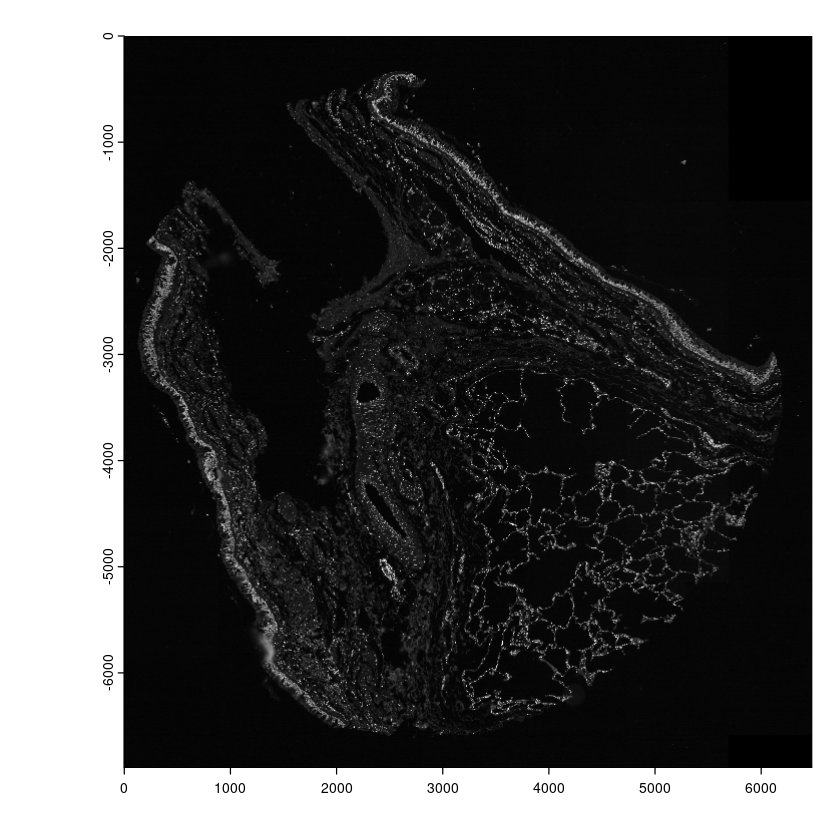

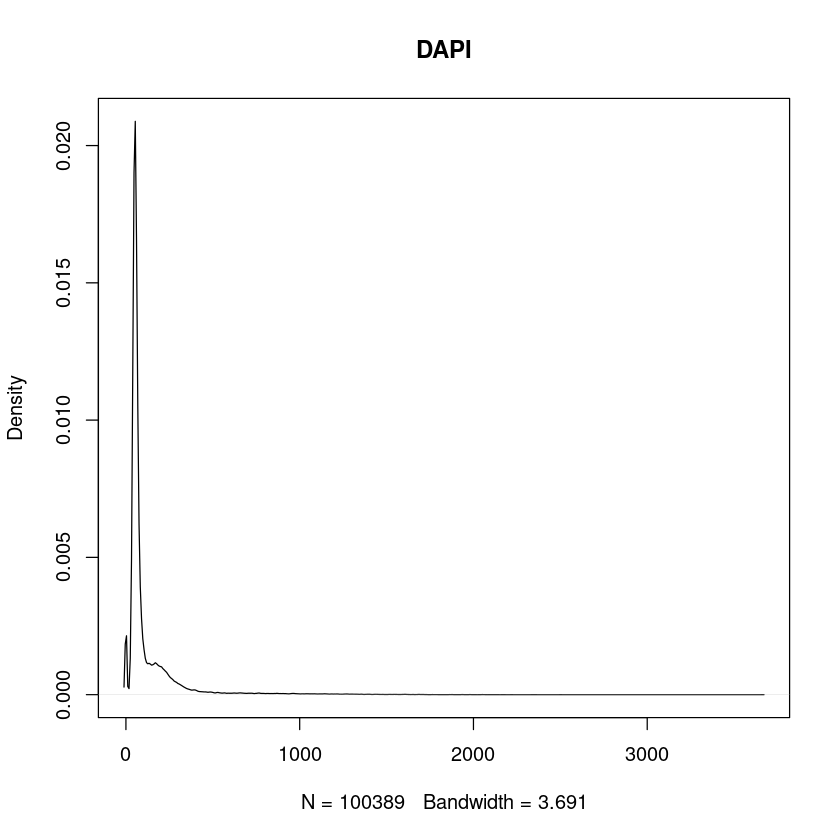

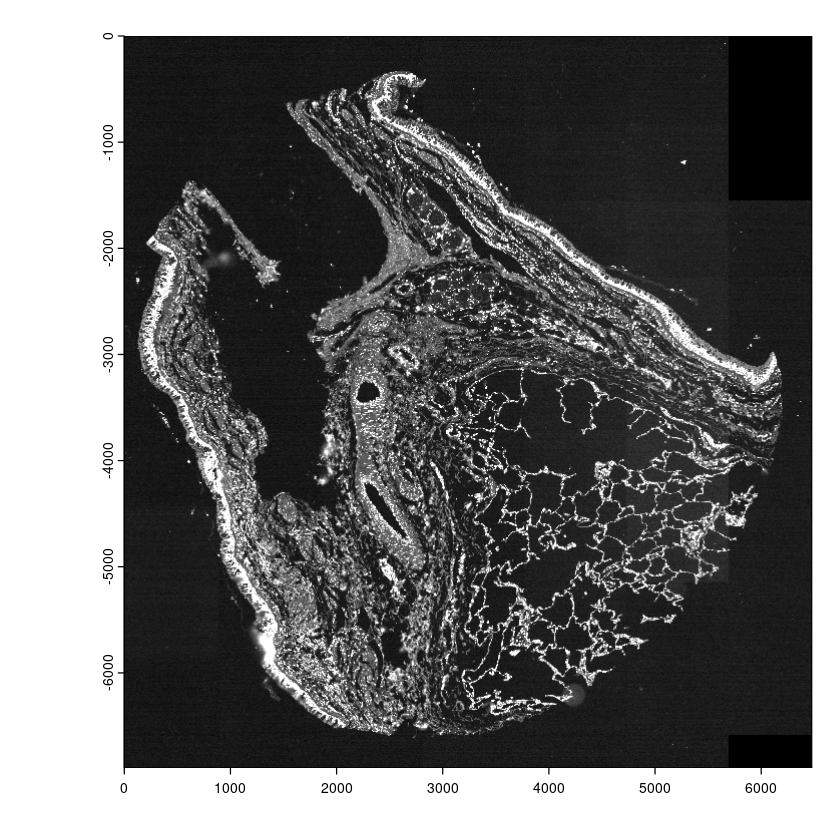

In [120]:
# isolate DAPI channel
dapi1 <- pheno1[[1]]
p1_data <- pheno1[[2:46]]
plot(dapi1)
# check image values
distGiottoImage(giottoLargeImage = dapi1)
# scale max color
plot(dapi1, max_intensity = 500)

# Creating polygons through Cellpose

Now that we have a Giotto image created we can begin to create a Giotto object to store the PhenoCycler data. Firstly we'll need to include polygons to define cells. The PhenoCycler output provided does not contain polygons for us to use. Instead we'll need to create our own. There are multiple methods we can use for this. The first we'll show is using the doCellposeSegmentation() function. This accesses a specific python environment to run Cellpose on a DAPI image or multistained image. We isolated the DAPI image from the image stack and ran Cellpose using the example code below. We won't be running this due to time constraints. Please note that having access to a GPU will speed up this step and is highly recommended, especially for larger images.

In [113]:
# Giotto::doCellposeSegmentation(
#   input = 'DAPI.tif',
#   python_env = 'giotto_segmentation',
#   mask_output = 'DAPI_Mask.tif',
#   model_name = 'nuclei',progress = T,verbose = T,batch_size = 1
# )

Once we have the mask output, we can create polygons within Giotto through the createGiottoPolygonsFromMask() function. Please note that a binary mask will not work for this. Instead we require a mask that has a background of 0 and each cell is colored by a different grey scale color. We can also visualize the position of the the mask through the plotting function. We can see the position has positive values along the y axis, whereas the image_stack is in negative space. To correct for this we can perform a spatshift to align the images in the same coordinate space.

In [114]:
library(Giotto)

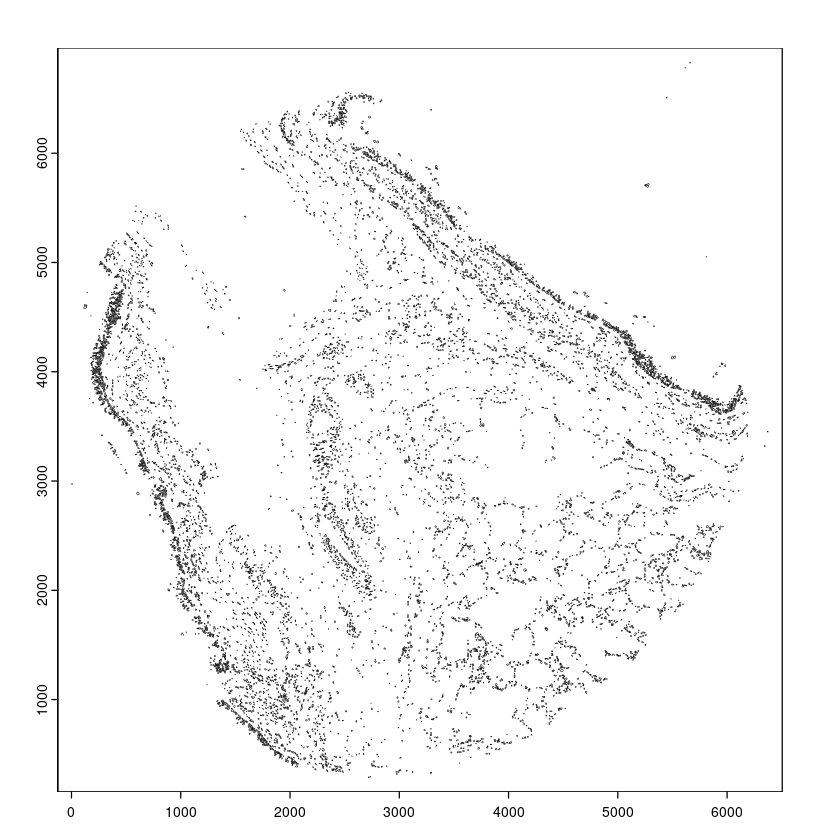

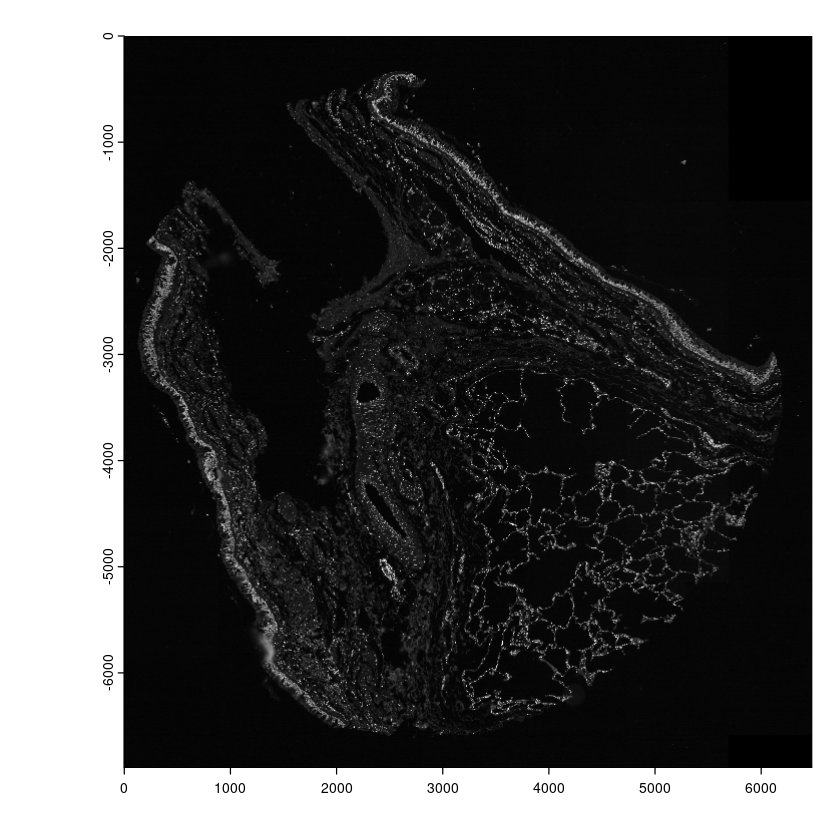

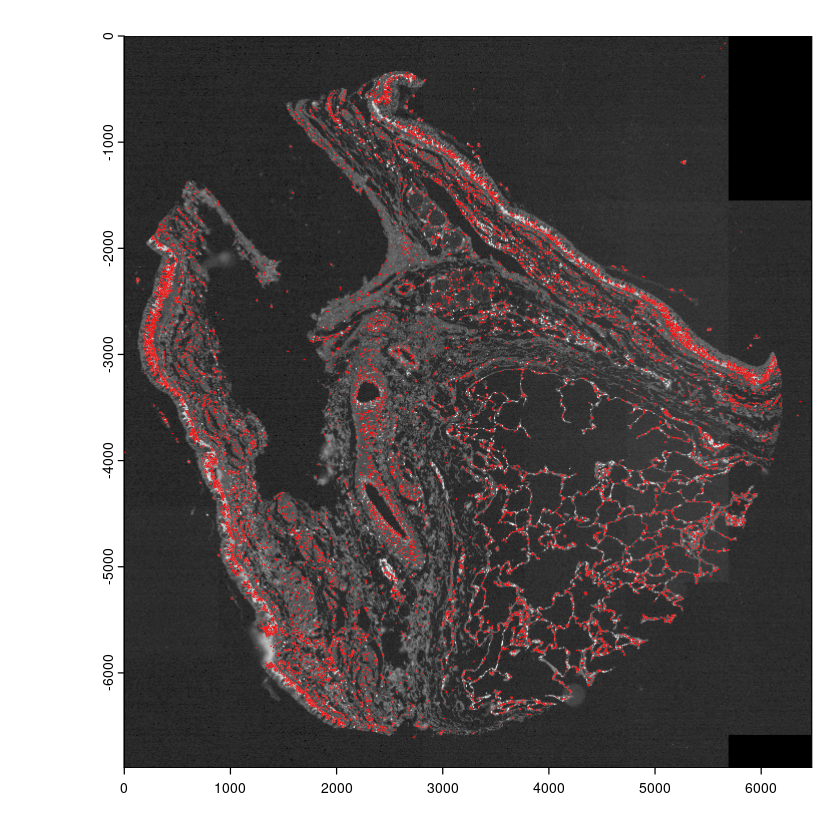

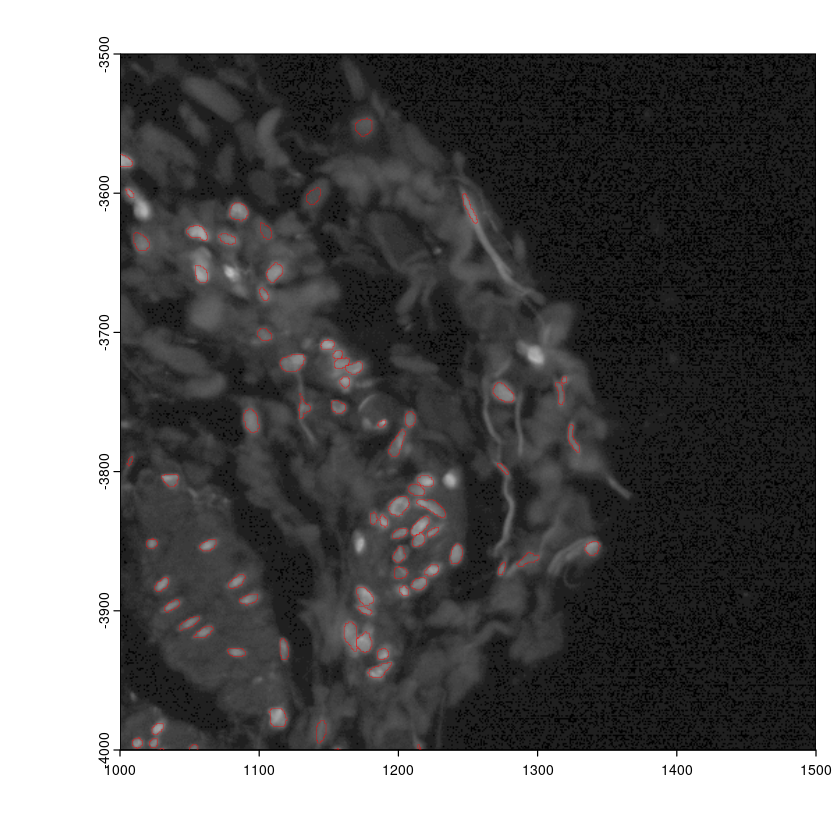

In [116]:
mask <- createGiottoPolygonsFromMask('DAPI_Mask.tif')

# If we plot these two we see they are not in the same space
# The polygons are postive along the y axis whereas the images are in negative space
plot(mask@spatVector, border="black", lwd=0.4)
plot(dapi1)

image_ext <- ext(dapi1)
mask_shift <- spatShift(mask, dy = image_ext[3])

plot(dapi1, col = gray.colors(100, start = 0, end = 1), legend=FALSE)
plot(mask_shift@spatVector, border="red", lwd=0.4, add = T)

# We can also take a closer look at the alignment
crop_dapi <- Giotto::crop(dapi1, ext(c(1000, 1500, -4000, -3500)))
crop_mask <- Giotto::crop(mask_shift, ext(c(3500, 4000, -4000, -3500)))

plot(crop_dapi, col = gray.colors(100, start = 0, end = 1), legend=FALSE)
plot(mask_shift, border="red", lwd=0.3, add = T)

Looking at the images above, we only overlap with the nuclei. Since we used Cellpose nuceli segmentation we do not have a cell mask. To achieve this with only nuclei segmentation we can expand our nuclei polygons through the `buffer()` function. This takes a set of polygons and expands by a set value. We'll use an expansion of 10, which should equate to 5 um. When selecting these values you should use values that are relevant to the pixel space the masks were created from. The current dataset has images with approximately 0.5 um per pixel. We can now visualize these expanded polygons to see how they overlap with our tissue.

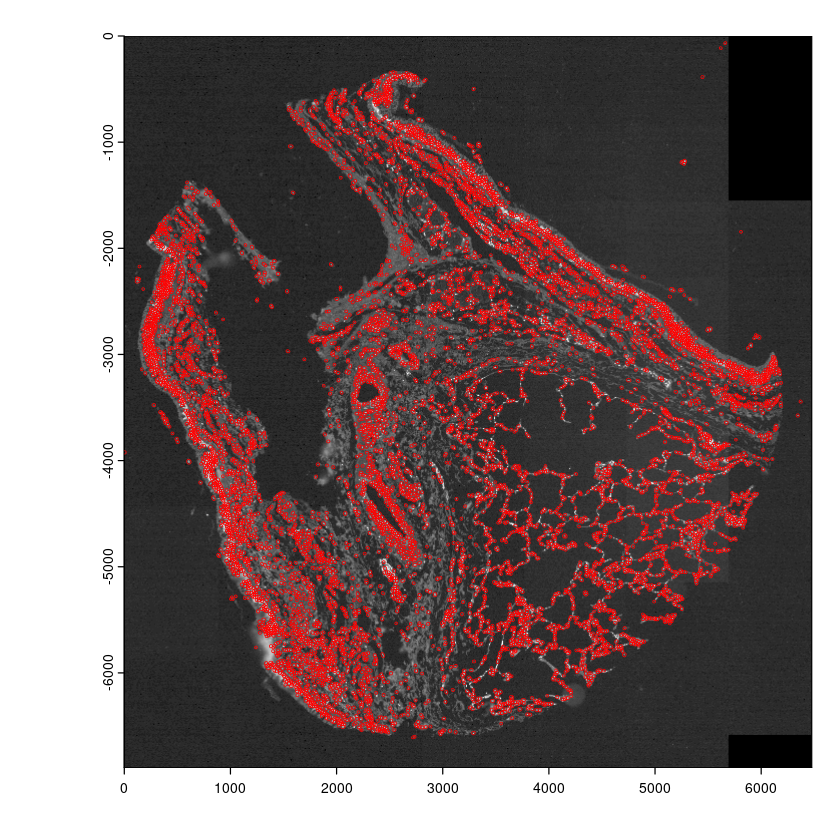

In [117]:
# this can take a second
cell_mask <- GiottoClass::buffer(mask_shift, 10)

plot(dapi1, col = gray.colors(100, start = 0, end = 1), legend=FALSE)
plot(cell_mask@spatVector, border="red", lwd=0.6, add = T)

Now that we have a set of polygons we can use the image files and the polygons to create a Giotto object that we can populate with expression data. We'll create the object using the createGiottoObjectSubcellular() function. We'll also need to add centroid values to the new object through the addSpatialCentroidLocations() function.

In [118]:
pheno1g <- createGiottoObjectSubcellular(
  gpolygons = mask_shift,
  images = pheno1
)

pheno1g <- addSpatialCentroidLocations(pheno1g)

python already initialized in this session
 active environment : 'giotto_env'
 python version : 3.10

polygonlist is not a list

[ cell ] Process polygon info...

python already initialized in this session
 active environment : 'giotto_env'
 python version : 3.10

Start centroid calculation for polygon information
 layer: cell



Our Giotto object still doesn't have an expression matrix for the protein data. To make this we'll calculate the overlap of protein expression data through intensity with the cell polygons through the `calculateOverlap()` and the `overlapToMatrix()` functions. We'll name the new expression data 'protein' to ensure interoperabiltiy with 'rna' data. Giotto objects are able to store multiple sets of expression information, however these need to have a unique name to ensure data is not overwritten. Finally we'll create the expression matrix with `createExprObj()` function and add this to the Giotto object with `setGiotto()`.

In [121]:
ovlp_cellpose <- calculateOverlap(mask_shift, p1_data, name_overlap = "protein")
m_cellpose <- overlapToMatrix(ovlp_cellpose, type = "intensity", feat_info = "protein")

ex_cellpose <- createExprObj(m_cellpose, name = "raw", spat_unit = "cell", feat_type = "protein")
pheno1g <- setGiotto(pheno1g, ex_cellpose)

Start image extract

Cannot preload entire working area of 1878752160 cells with max_cells_in_memory = 3e+07. Raster values will be read for each feature individually.



  |======================================================================| 100%


End image extract

Setting expression [cell][protein] raw



With our newly created expression matrix we can begin to analyze the PhenoCycler data. Firstly we need to filter the Giotto object to remove cells that do not contain expression information. Due to the low number of features in the analysis, we will not be removing proteins from the analysis. Instead of using the `normalizeGiotto()` function we'll be using `processExpression()` to perform an arcsin normalization for the protein data.

In [122]:
# We can set the active spat units and feat types
activeSpatUnit(pheno1g) <- 'cell'
activeFeatType(pheno1g) <- 'protein'

pheno1g <- filterGiotto(pheno1g,
                  feat_det_in_min_cells = 100,
                  min_det_feats_per_cell = 10,
                  expression_threshold = 200)

pheno1g = processExpression(pheno1g, normParam('arcsin'), expression_values = 'raw', spat_unit = 'cell', feat_type = 'protein')
pheno1g = addStatistics(pheno1g, feat_type = 'protein', spat_unit = 'cell')

completed 1: preparation

completed 2: subset expression data

completed 3: subset spatial locations

completed 4: subset cell metadata

completed 5: subset feature metadata

completed 6: subset spatial network(s)

completed 7: subsetted dimension reductions

completed 8: subsetted nearest network(s)

completed 9: subsetted spatial enrichment results

for cell

--> cell found back in polygon layer: cell

completed 10: subsetted spatial information data




Feature type:  protein 
Number of cells removed:  340  out of  9342 
Number of feats removed:  0  out of  45 


Setting expression [cell][protein] normalized

calculating statistics for "normalized" expression

Warning message in addFeatStatistics(gobject, feat_type = feat_type, spat_unit = spat_unit, :
“expression and feature metadata provenance mismatch”
Warning message in addCellStatistics(gobject, feat_type = feat_type, spat_unit = spat_unit, :
“expression and feature metadata provenance mismatch”


We can then perform clustering as we've already detailed above. Please refer to those for more detail.

"hvf" was not found in the gene metadata information.
 all genes will be used.

Warning message in .run_pca_biocsingular(x = t_flex(expr_values), center = center, :
“ncp >= minimum dimension of x, will be set to
                minimum dimension of x - 1”
Warning message in (function (A, nv = 5, nu = nv, maxit = 1000, work = nv + 7, reorth = TRUE, :
“You're computing too large a percentage of total singular values, use a standard svd instead.”
Setting dimension reduction [cell][protein] protein.pca

PCA with name: protein.pca already exists and will be used for the screeplot

Setting dimension reduction [cell][protein] protein.umap



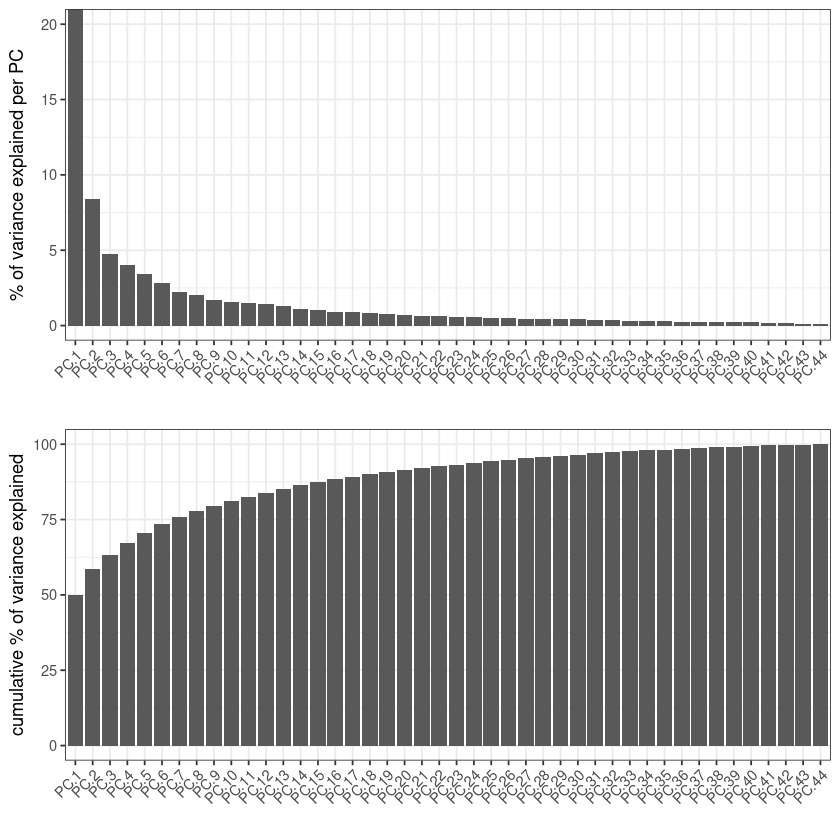

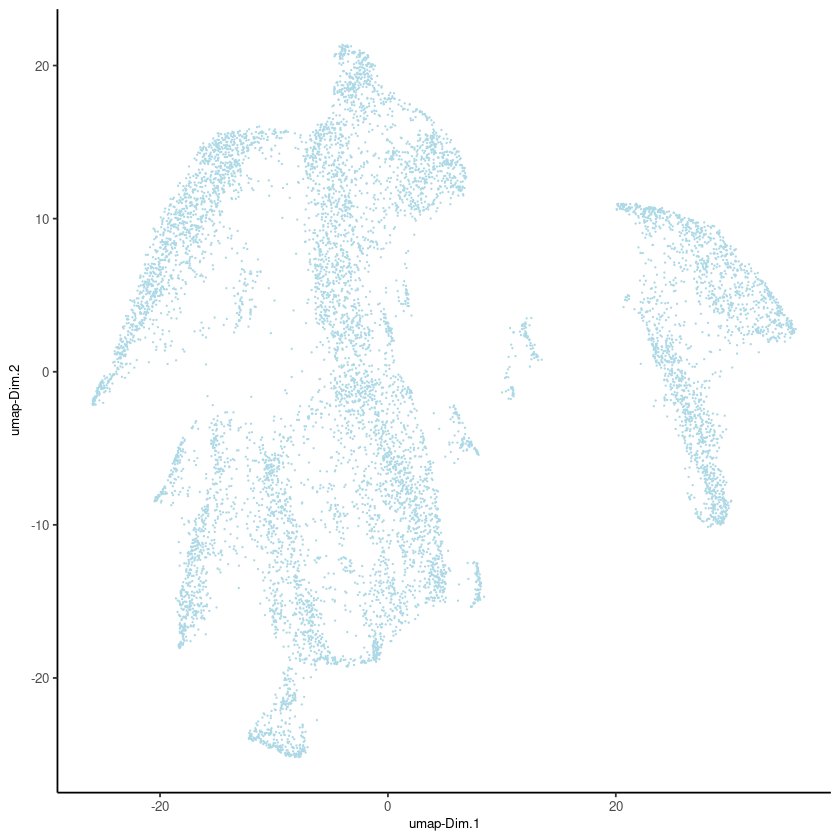

In [123]:
pheno1g <- runPCA(gobject = pheno1g,
                  feats_to_use = NULL,
                  spat_unit = 'cell')

screePlot(pheno1g)

pheno1g <- runUMAP(pheno1g,
             dimensions_to_use = 1:15,
             spat_unit = 'cell')

plotUMAP(pheno1g,
         point_size = 0.01)

pheno1g <- createNearestNetwork(pheno1g,
                dimensions_to_use = 1:15,
                expression_values = norm_name,
                k = 25,
                spat_unit = 'cell')

pheno1g <- doLeidenCluster(pheno1g,
                     resolution = 0.2,
                     n_iterations = 10,
                     spat_unit = 'cell')

Now that we've performed the clustering we can visuzalize this in the UMAP space and spatially. We can see the cluster localize to biological structures similar to the xenium data.

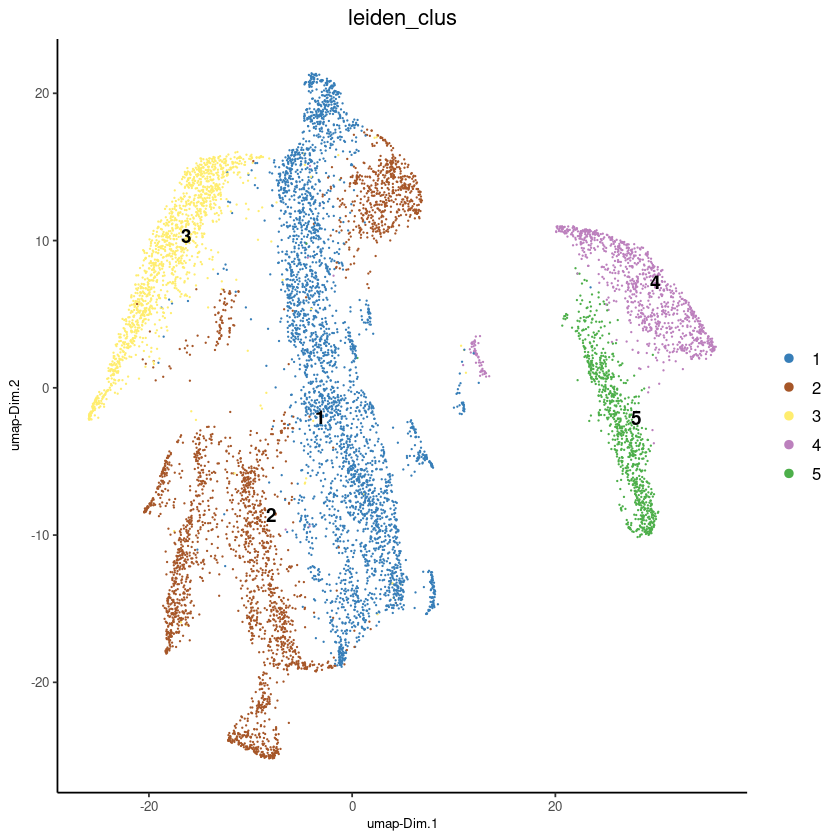

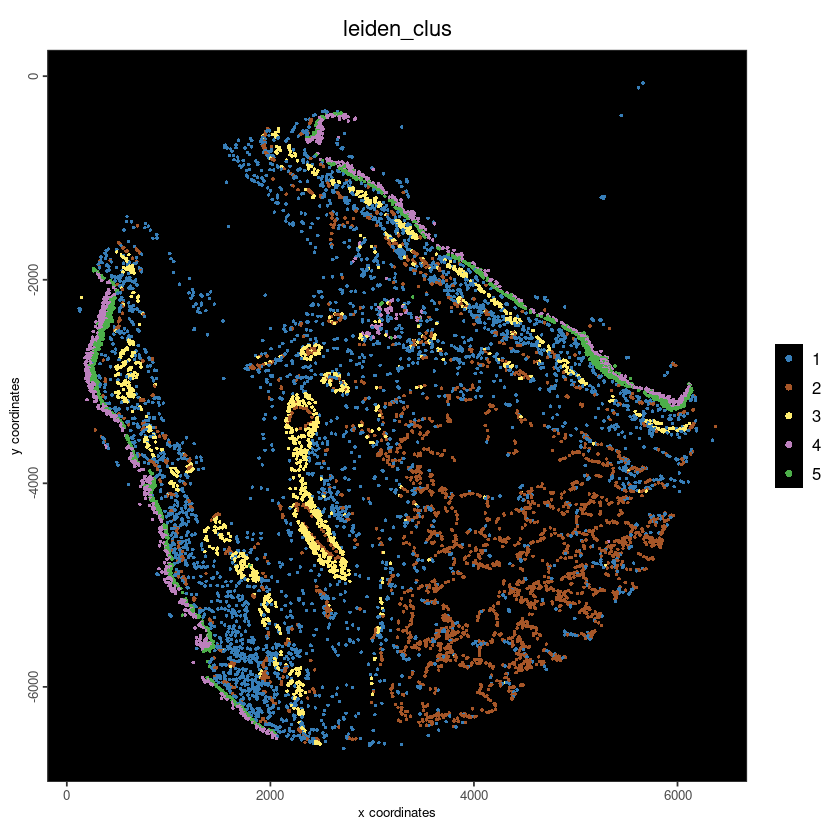

In [124]:
plotUMAP(gobject = pheno1g,
         spat_unit = 'cell',
         cell_color = 'leiden_clus',
         show_legend = TRUE,
         point_size = 0.01,
         point_shape = 'no_border')

spatPlot2D(gobject = pheno1g,
           spat_unit = 'cell',
           feat_type = 'protein',
           cell_color = 'leiden_clus',
           point_size = 1.0,
           show_legend = TRUE,
           point_border_stroke = 0,
           background_color = 'black')

# Spatial Data Alignment

Giotto has several functions for defining spatial transforms on subobjects: [more](https://drieslab.github.io/Giotto_website/articles/spatial_transformations.html)
```
* spatShift() # xy translation
* spin()      # rotations
* shear()     # shearing
* flip()      # vertical/horizontal flips
* t()         # transpose
* affine()    # affine transform
```

For this data, since it is performed on the same tissue as the Xenium, we can try analyzing the two modalities together.

First we need to put them in the same coordinate space and an affine transform should be enough.

## Xenium Explorer Alignment

Affine transform matrices exported from Xenium Explorer can be found at:

* `TMA2/giotto_premade/region_1.tif`
* `TMA2/giotto_premade/region_7.tif`

These should be loaded in with either the xenium importer object or `read10xAffineImage()` since on top of the affine matrix, an experiment-specific scalefactor is also applied (usually 0.2125)

```
jsonlite::read_json(file.path(xen1_path, "experiment.xenium"))$pixel_size
```

## Giotto `interactiveLandmarkSelection()`

`interactiveLandmarkSelection()` is a shiny app that can be run to place paired landmarks between two sets of ggplot plots.

`calculateAffineMatrixFromLandmarks()` can then be used to calculate an affine matrix to use with `affine(pre_multiply = TRUE)`

In [125]:
x <- importXenium(xen1_path)
x

Giotto <XeniumReader>
dir       : /hive/hubmap/da[...]_0021229__Region_1__20240319__210701 
qv_cutoff : 20 
filetype  : transcripts -- parquet
            boundaries  -- parquet
            expression  -- h5
            cell_meta   -- parquet
funs      : load_transcripts()
            load_polys()
            load_cellmeta()
            load_featmeta()
            load_expression()
            load_image()
            load_aligned_image()
            create_gobject()

In [126]:
# load in phenocycler data again as affine aligned information
pheno1 <- x$load_aligned_image(r1_img_path,
    imagealignment_path = r1_align_path
)
names(pheno1) <- analytes$Biomarker # apply channel names

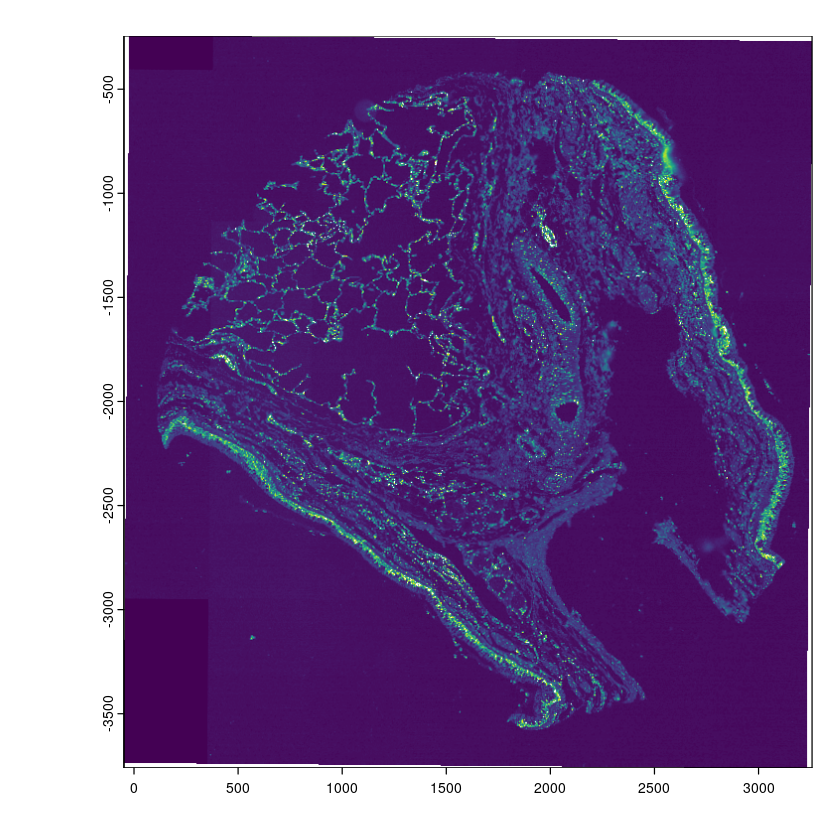

In [127]:
# plot aligned phenocycler DAPI
dapi1 <- pheno1[[1]]
plot(dapi1, max_intensity = 100, col = viridis::viridis(100))

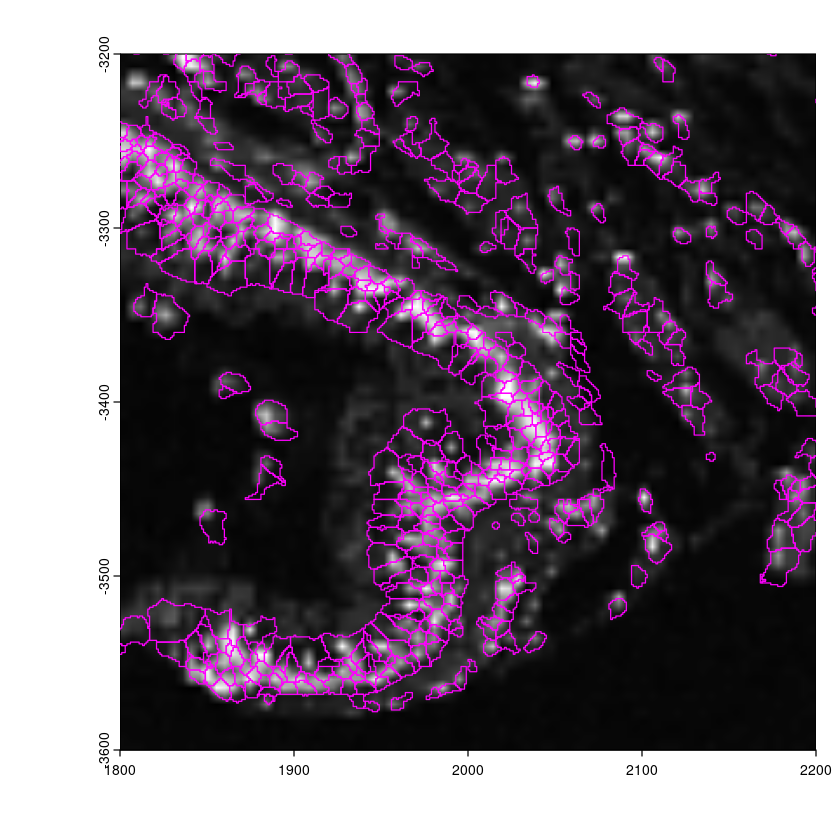

In [128]:
# aligned phenocycler vs UCS segmentations
plot(pheno1[[1]], max_intensity = 100, ext = c(1800, 2200, -3600, -3200))
plot(ucs1, add = TRUE, alpha = 0.5, border = "magenta", lwd = 1)

In [129]:
pheno1

An object of class giottoAffineImage : "aligned_image"
Image extent            : -48.3484884743202, 3257.04875264179, -3760.64480219366, -244.456301162222 (xmin, xmax, ymin, ymax)
Original image extent   : 0, 6476, -6896, 0 (xmin, xmax, ymin, ymax)
Scale factor            : 0.510407233032135, 0.509888123699454 (x, y)
Resolution              : 1.95921988420771, 1.96121453613113 (x, y)
Layers                  : 46 
Name                    : DAPI Ki67 Pan-Cytokeratin CD68 CD14 CD20 CD4 CD8 CD31 CD3e Col1A1 SMA HLA-DR SFTPC CXCL4 CD45 ATP1A1 LYVE1 FOXP3 TPSAB1 AGER CD11c CD163 Keratin 5 Collagen IV MPO SCEL CD1c TUBB3 SCGB1A1 TP63 E-cadherin MUC5AC FOXJ1 Keratin-14 SCGB3A2 CD55 PROX1 SFTPB GRP Podoplanin MUC5B Caveolin SOX2 KRT8 SOX9 
Estimated max intensity : 15143 
Estimated min intensity : 0 
Values                  : integers
File path               : '/hive/hubmap/data/public/spatial-data-workshop/TMA2/giotto_premade/region_1.tif'

# giottoAffineImage

These are lazily transformed images. In addition to the basic representation of `giottoLargeImage`, they contain an `affine2d` object which keeps track of where the original object is (`anchor`) and a mapped affine matrix to use.

When plotting, the image is again sampled as before, and the affine transform is performed on the sampled image.
When aggregating, the polygons are affine transformed in the reverse direction of the affine recorded in the image and performed on the untransformed original image.

<affine2d>
anchor    : 0, 6476, -6896, 0  (xmin, xmax, ymin, ymax)
rotate    : 0.00815731148507189  (rad)
shear     : 0, 0  (x, y)
scale     : -0.506028575022675, 0.506028575022675  (x, y)
translate : 3228.58353398558, -3760.64480219366  (x, y)

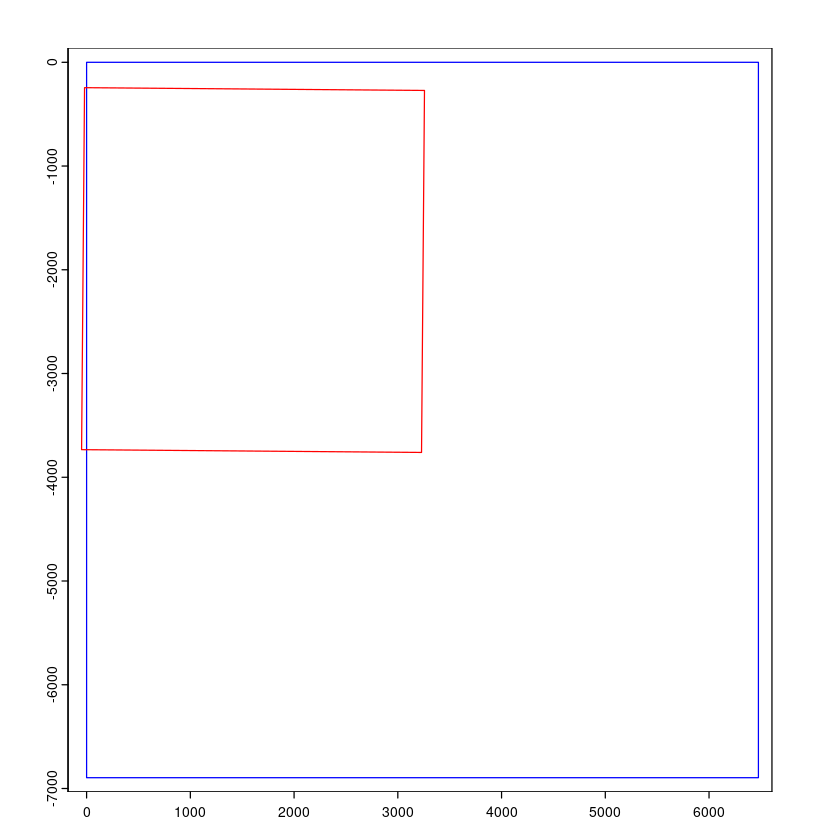

In [130]:
pheno1@affine
plot(pheno1@affine) # blue is the starting position and red is the end

In [131]:
pheno1@affine@anchor
pheno1@affine@affine

[1]     0  6476 -6896     0

-0.506011739,0.004127787,3228.584
-0.004127787,-0.506011739,-3760.645
0.000000000,0.000000000,1.000


In [132]:
p1_dapi <- pheno1[[1]]
p1_data <- pheno1[[2:46]]

objName(p1_dapi) <- "pheno_dapi"
objName(p1_data) <- "phenocycler"

In [133]:
xen1 <- setGiotto(xen1, list(p1_dapi, p1_data))
xen1

Warning message in FUN(X[[i]], ...):
“spat_unit: ucs feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”
Warning message in FUN(X[[i]], ...):
“spat_unit: hex_niche feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”


An object of class giotto 
>Active spat_unit:  ucs 
>Active feat_type:  rna 
dimensions    : 288, 12447 (features, cells)
[SUBCELLULAR INFO]
polygons      : cell nucleus ucs hex_niche selections 
features      : rna NegControlProbe UnassignedCodeword NegControlCodeword DeprecatedCodeword 
[AGGREGATE INFO]
expression -----------------------
  [cell][rna] raw normalized scaled
  [ucs][rna] raw normalized scaled
spatial locations ----------------
  [cell] raw
  [nucleus] raw
  [ucs] raw
  [hex_niche] raw
spatial networks -----------------
  [cell] Delaunay_network
  [ucs] Delaunay_network
spatial enrichments --------------
  [cell][rna] cluster_metagene
  [ucs][rna] celltypes_niche
  [hex_niche][rna] celltypes_niche
dim reduction --------------------
  [cell][rna] pca umap
  [ucs][rna] pca umap
nearest neighbor networks --------
  [cell][rna] sNN.pca
  [ucs][rna] sNN.pca
attached images ------------------
images      : image pheno_dapi phenocycler 


Use objHistory() to see steps and para

# giottoAffineImage-specific aggregation workflow
It is not yet possible to use `calculateOverlap()` and `overlapToMatrix()` on affine images from the `giotto` object.

Instead, we have to use the data-level method

In [134]:
ovlp <- calculateOverlap( # takes ~1min
    x = getPolygonInfo(xen1, polygon_name = "ucs", return_giottoPolygon = TRUE),
    y = getGiottoImage(xen1, name = "phenocycler"),
    name_overlap = "protein"
)

Start image extract

Cannot preload entire working area of 1649204145 cells with max_cells_in_memory = 3e+07. Raster values will be read for each feature individually.



  |======================================================================| 100%


End image extract



In [135]:
m <- overlapToMatrix(ovlp, type = "intensity", feat_info = "protein")
m[1:3, 1:10] # preview

3 x 10 Matrix of class "dgeMatrix"
                cell_1 cell_10 cell_100 cell_1000 cell_10000 cell_10001
Ki67              4208   11036     1995      3037        183       1008
Pan-Cytokeratin 299270  417437    49444      1287        597       1254
CD68              6319    5366     2422     44217        490       1095
                cell_10002 cell_10003 cell_10004 cell_10005
Ki67                   892       1454       1404        856
Pan-Cytokeratin       1146       2143       2095       1348
CD68                  1251       2036       1866       1511

In [136]:
# package as exprObj subobject
ex <- createExprObj(expression_data = m,
    name = "raw",
    spat_unit = "ucs",
    feat_type = "protein",
    provenance = "ucs"
)
# attach to giotto object
xen1 <- setGiotto(xen1, ex)

# set active feature type
activeFeatType(xen1) <- "protein"

Setting expression [ucs][protein] raw

Warning message in FUN(X[[i]], ...):
“spat_unit: ucs feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”
Warning message in FUN(X[[i]], ...):
“spat_unit: hex_niche feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”
Warning message in FUN(X[[i]], ...):
“spat_unit: ucs feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”
Warning message in FUN(X[[i]], ...):
“spat_unit: hex_niche feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”


Selecting attribute "id" as poly_ID

Selecting attribute "poly_ID" as poly_ID



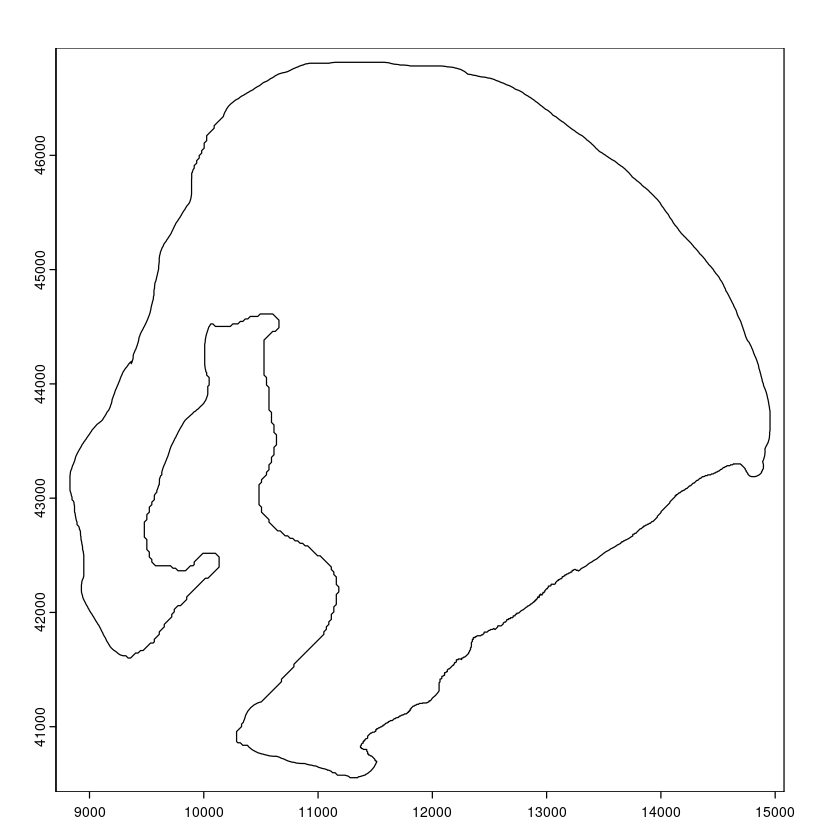

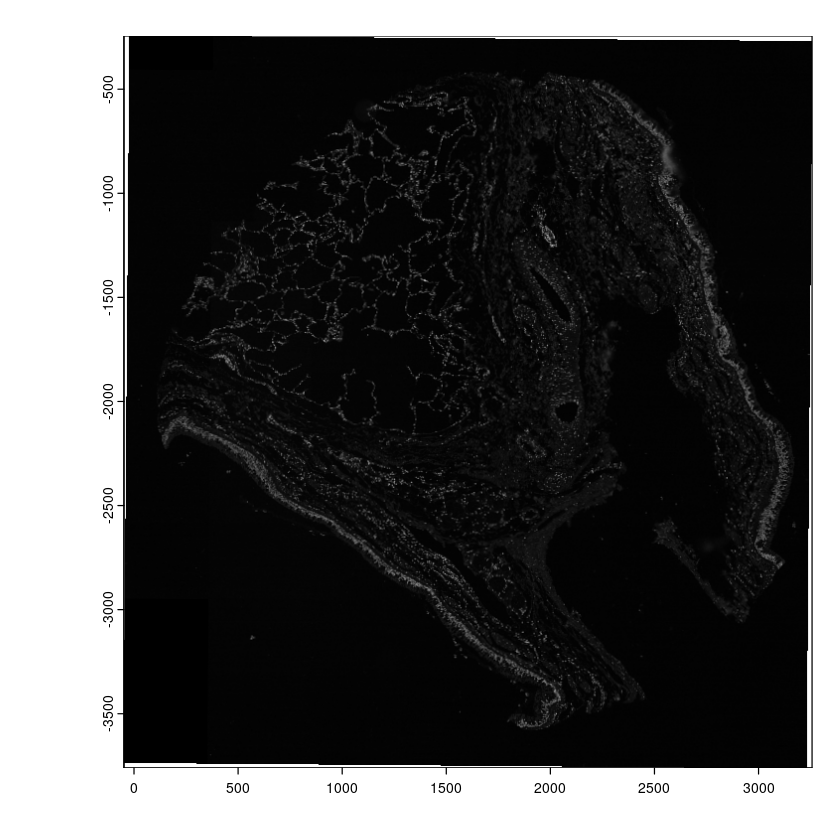

In [137]:
# add the polygon for selection
mask1 <- createGiottoPolygon(file.path(pheno_dir, "D231-RLL-14C2-HM-TMA-2-1-2.geojson"), remove_background_polygon = FALSE)
plot(mask1)
plot(dapi1)

In [138]:
e <- ext(mask1)
terra::xmin(e)


[1] 8829

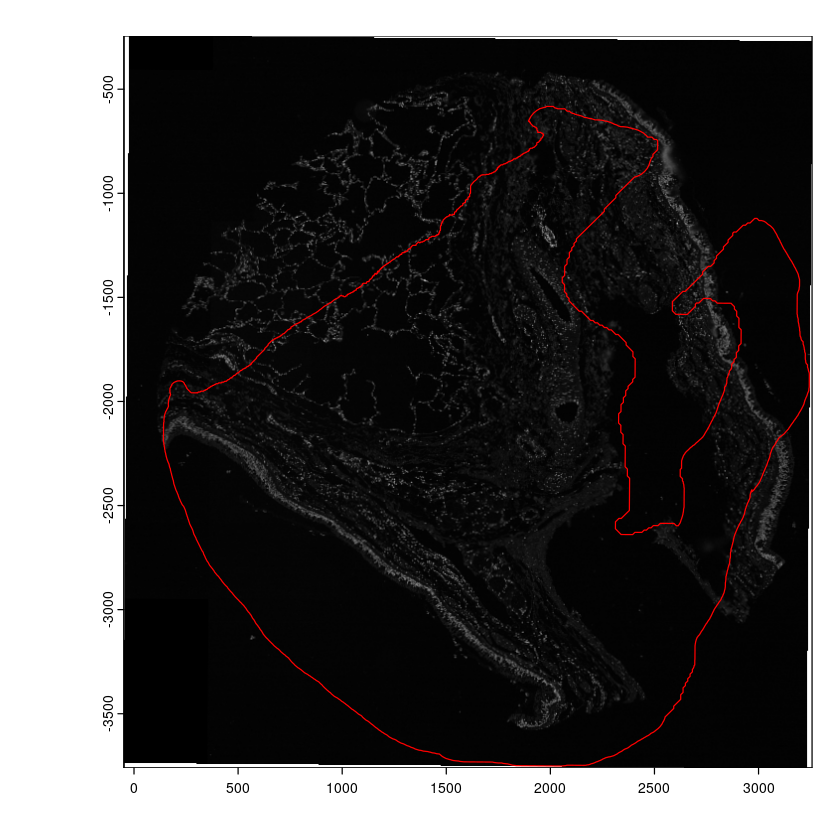

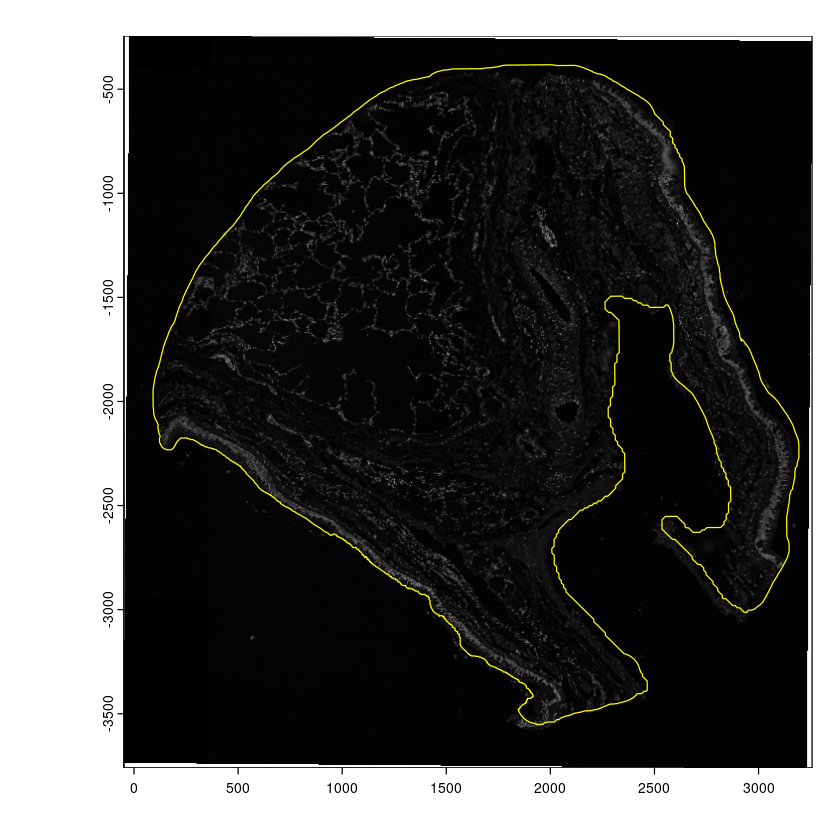

In [139]:
plot(dapi1)
mask1 |>
    spatShift(dx = -terra::xmin(mask1[]), dy = -terra::ymax(mask1[])) |>
    affine(dapi1@affine) |>
    plot(add = T, border = "red")

mask1_aff <- mask1 |>
    spatShift(dx = -terra::xmin(mask1[]), dy = -terra::ymax(mask1[])) |>
    affine(dapi1@affine)

plot(dapi1)
flip(mask1_aff, y0 = mean(c(terra::ymin(mask1_aff[]), terra::ymax(mask1_aff[])))) |>
    spatShift(dx = -50, dy = 200) |>
    plot(add = TRUE, border = "yellow")

In [140]:
# finalize mask poly
mask1 <- flip(mask1_aff, y0 = mean(c(terra::ymin(mask1_aff[]), terra::ymax(mask1_aff[])))) |>
    spatShift(dx = -50, dy = 200)

In [141]:
# drop cells not in the selection
rels <- relate(mask1, getPolygonInfo(xen1, polygon_name = "ucs", return_giottoPolygon = TRUE), relation = "intersects")

In [142]:
# selected cells can be found under $y
head(rels)

x,y
<chr>,<chr>
266e530d-db24-4e7c-a017-350b48117d39,cell_8957
266e530d-db24-4e7c-a017-350b48117d39,cell_8826
266e530d-db24-4e7c-a017-350b48117d39,cell_8837
266e530d-db24-4e7c-a017-350b48117d39,cell_8854
266e530d-db24-4e7c-a017-350b48117d39,cell_8952
266e530d-db24-4e7c-a017-350b48117d39,cell_8849


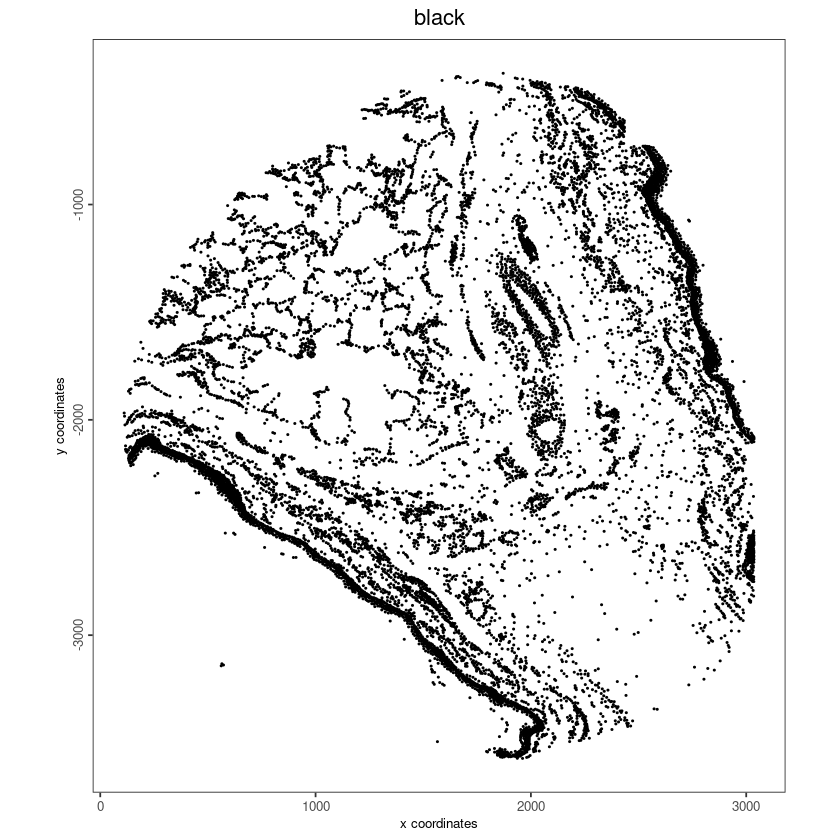

In [143]:
spatPlot2D(xen1, point_size = 0.2, point_shape = "no_border", cell_color = "black")

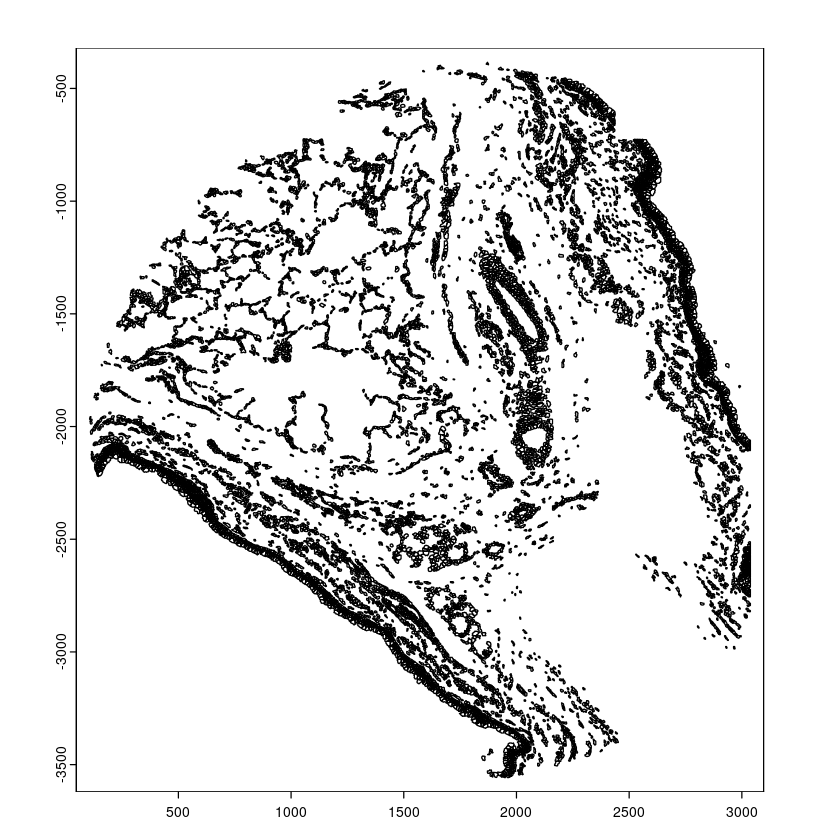

In [144]:
# check that the selection makes sense
ucs <- xen1@spatial_info$ucs
plot(ucs[rels$y])
rm(ucs)

In [145]:
xen1 <- subsetGiotto(xen1, cell_ids = rels$y, spat_unit = "ucs", feat_type = ":all:")

Warning message in FUN(X[[i]], ...):
“spat_unit: ucs feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”
Warning message in FUN(X[[i]], ...):
“spat_unit: hex_niche feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”


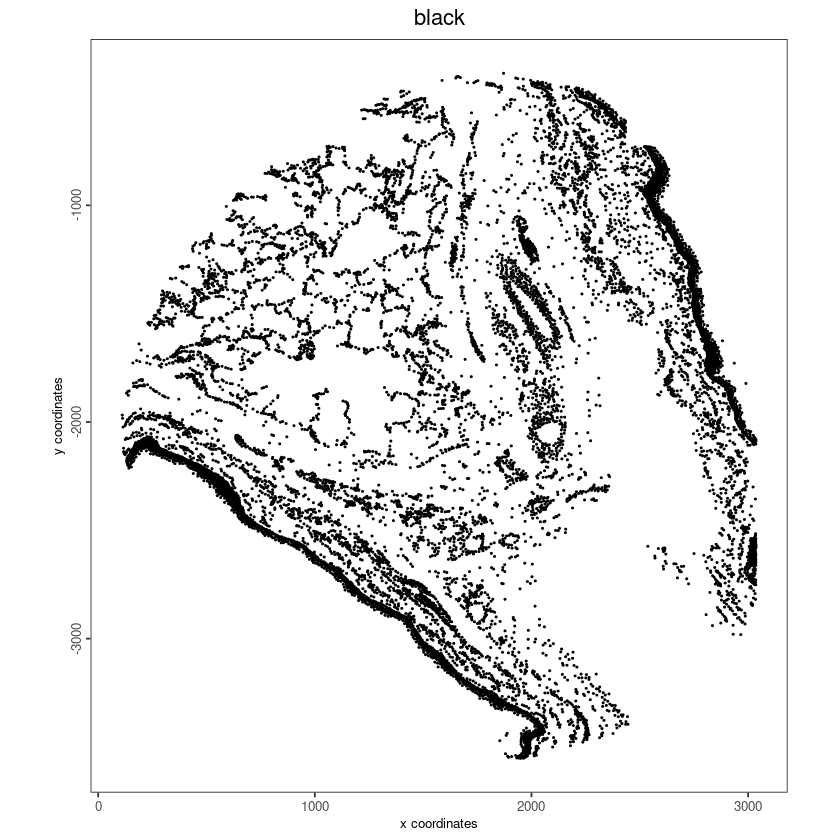

In [146]:
spatPlot2D(xen1, point_size = 0.2, point_shape = "no_border", cell_color = "black")

In [147]:
# data processing
?normParam

process_param {Giotto},R Documentation
method,character. Name of method to use. See details.
...,(optional) Additional named parameters relevant to the param class.


In [148]:
?norm_arcsinh

norm_arcsinh {Giotto},R Documentation
c,numeric (default = 5). Expressed as c in the above formula.


In [149]:
# arcsinh normalization (inverse hyperbolic sine)
aparam <- normParam(method = "arcsinh")

In [150]:
aparam$c <- 5

In [151]:
xen1 <- processExpression(xen1, param = aparam, expression_values = "raw", name = "normalized")

Setting expression [ucs][protein] normalized

Warning message in FUN(X[[i]], ...):
“spat_unit: ucs feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”
Warning message in FUN(X[[i]], ...):
“spat_unit: hex_niche feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”


In [152]:
xen1 <- addStatistics(xen1)

calculating statistics for "normalized" expression



plot polygon layer done



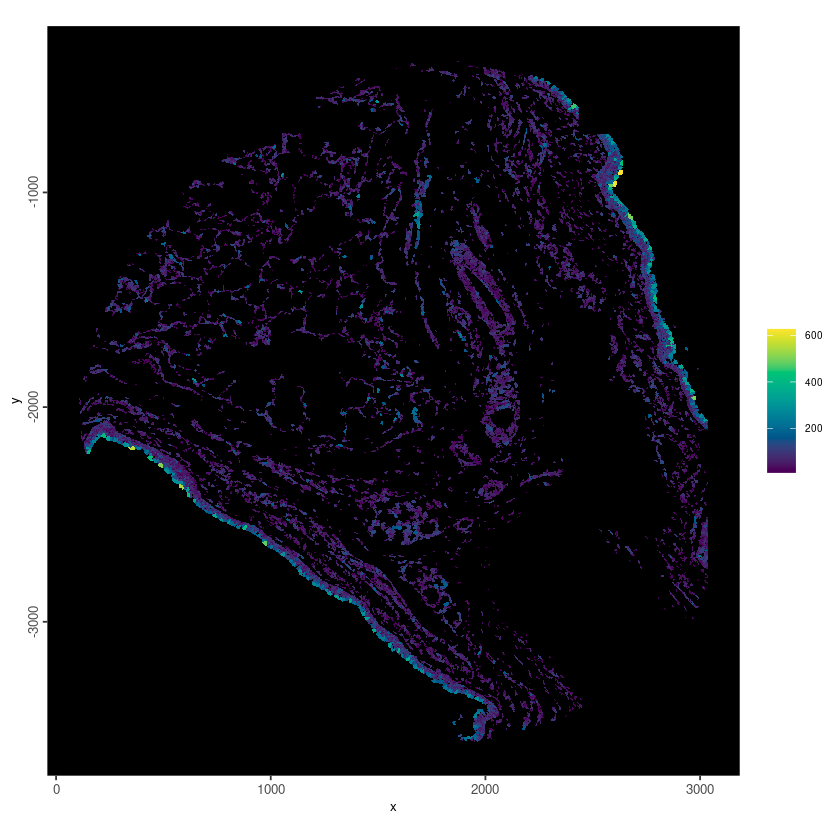

In [153]:
spatInSituPlotPoints(xen1,
    polygon_feat_type = "ucs",
    polygon_fill = "total_expr",
    polygon_fill_as_factor = FALSE,
    polygon_fill_gradient_style = "sequential",
    polygon_line_size = 0,
    expression_values = "normalized"
)

In [154]:
# standard processing
xen1 <- runPCA(xen1, feats_to_use = NULL) # no hvf selection

Warning message in .run_pca_biocsingular(x = t_flex(expr_values), center = center, :
“ncp >= minimum dimension of x, will be set to
                minimum dimension of x - 1”
Warning message in (function (A, nv = 5, nu = nv, maxit = 1000, work = nv + 7, reorth = TRUE, :
“You're computing too large a percentage of total singular values, use a standard svd instead.”
Setting dimension reduction [ucs][protein] protein.pca

Warning message in FUN(X[[i]], ...):
“spat_unit: ucs feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”
Warning message in FUN(X[[i]], ...):
“spat_unit: hex_niche feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”


PCA with name: protein.pca already exists and will be used for the screeplot



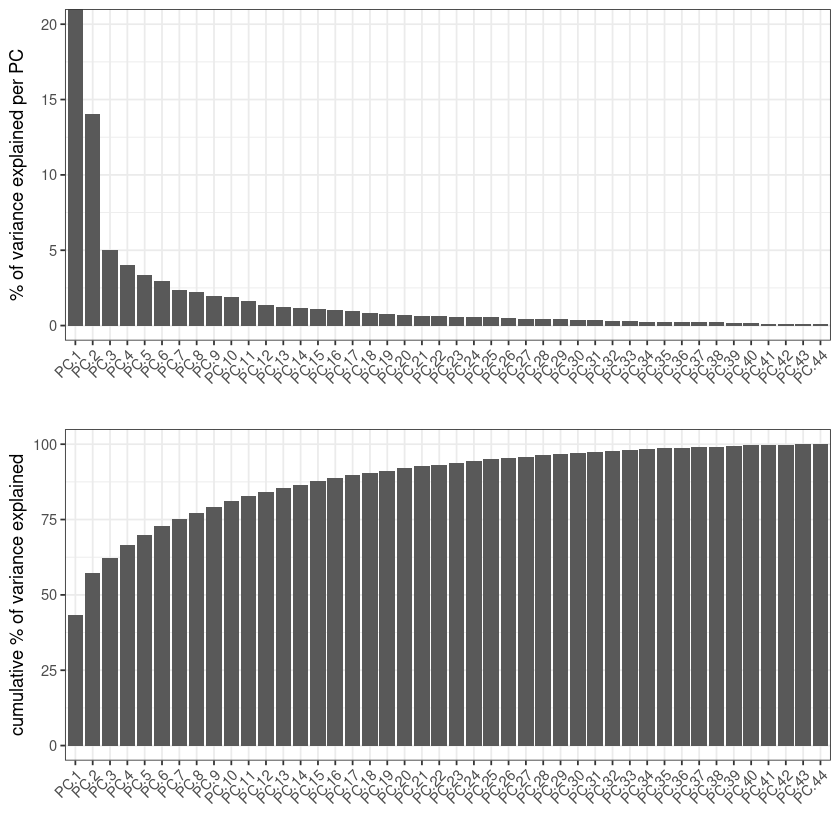

In [155]:
screePlot(xen1, spat_unit = "ucs", feat_type = "protein")

In [156]:
pc_use <- 1:15
xen1 <- runUMAP(xen1, dimensions_to_use = pc_use) |>
    createNearestNetwork(dimensions_to_use = pc_use)

Setting dimension reduction [ucs][protein] protein.umap

Warning message in FUN(X[[i]], ...):
“spat_unit: ucs feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”
Warning message in FUN(X[[i]], ...):
“spat_unit: hex_niche feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”


In [157]:
xen1 <- doLeidenCluster(xen1, res = 0.4, n_iterations = 100) # reduced number of iterations

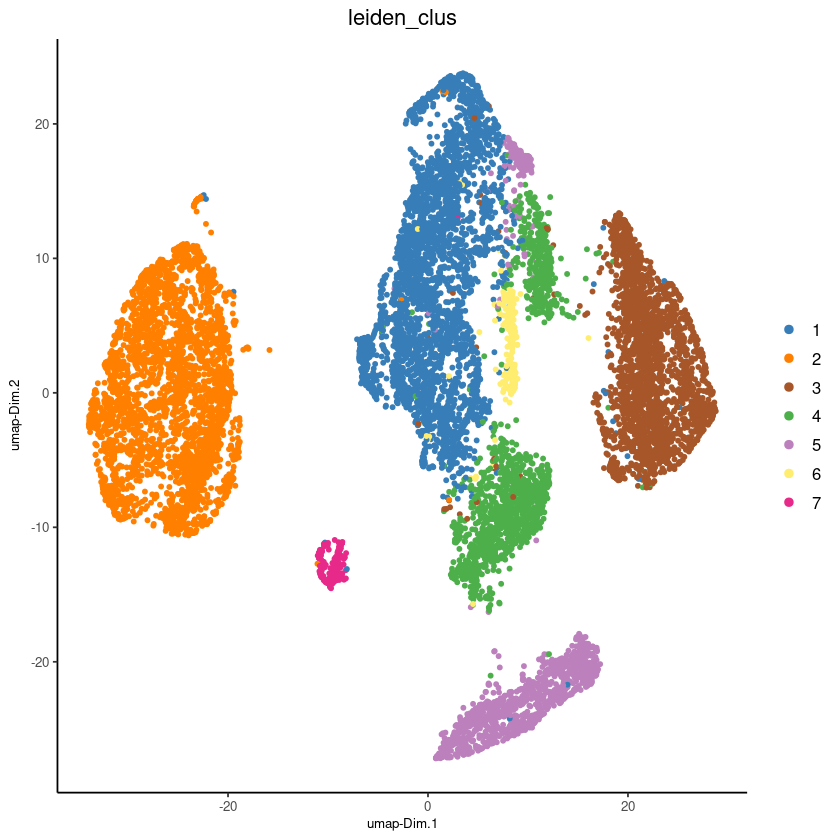

In [158]:
plotUMAP(xen1,
    cell_color = "leiden_clus",
    point_shape = "no_border",
    show_center_label = FALSE
)

In [159]:
pDataDT(xen1)[, table(leiden_clus)]

leiden_clus
   1    2    3    4    5    6    7 
3291 3029 2267 1466 1292  258  214 

plot polygon layer done



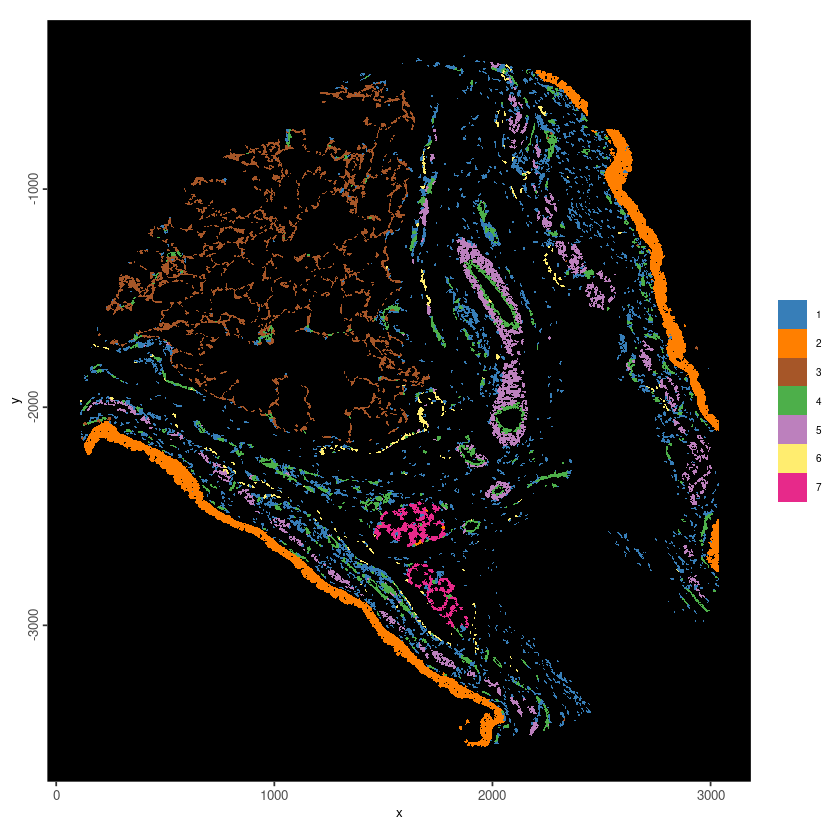

In [160]:
spatInSituPlotPoints(xen1,
    polygon_feat_type = "ucs",
    feat_type = "protein",
    polygon_fill = "leiden_clus",
    polygon_fill_as_factor = TRUE,
    polygon_line_size = 0
)

In [161]:
prot_scran <- findMarkers_one_vs_all(xen1, cluster_column = "leiden_clus")

using 'Scran' to detect marker feats. If used in published
        research, please cite: Lun ATL, McCarthy DJ, Marioni JC (2016).
        'A step-by-step workflow for low-level analysis of single-cell RNA-seq
        data with Bioconductor.'
        F1000Res., 5, 2122. doi: 10.12688/f1000research.9501.2. 



start with cluster  1start with cluster  2start with cluster  3start with cluster  4start with cluster  5start with cluster  6start with cluster  7

In [162]:
data.table::setorder(prot_scran, "ranking")
prot_scran |> head()

Top,p.value,FDR,logFC,feats,cluster,ranking
<int>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
1,1.644992e-03,4.684412e-02,0.1446967,MUC5AC,1,1
2,3.942520e-49,8.870670e-48,0.5822510,Caveolin,2,1
4,2.759360e-38,3.104280e-37,0.9337141,Keratin 5,3,1
4,2.290009e-04,2.576261e-03,0.2823901,Pan-Cytokeratin,4,1
3,5.547807e-04,8.321710e-03,0.1882144,Caveolin,5,1
5,1.899328e-01,9.929166e-01,0.1642097,ATP1A1,6,1


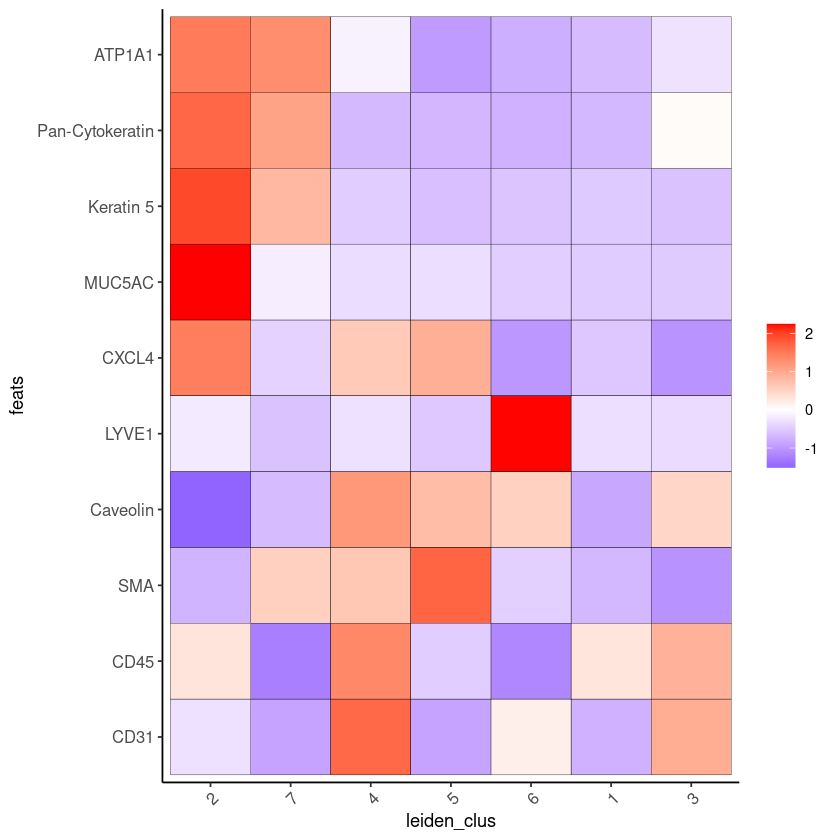

In [163]:
# select the 10 highest ranked markers by leiden cluster
top_prot_markers <- prot_scran[, head(.SD, 2), by = "cluster"]

# Plot marker genes' expression
plotMetaDataHeatmap(xen1,
    selected_feats = top_prot_markers$feats,
    metadata_cols = "leiden_clus"
)

# Multimodal Integration

In [164]:
# create NN networks with k = 10 for each modality
xen1 <- createNearestNetwork(xen1,
    spat_unit = "ucs",
    feat_type = "rna",
    type = "kNN",
    dimensions_to_use = pc_use,
    k = 10
)
xen1 <- createNearestNetwork(xen1,
    spat_unit = "ucs",
    feat_type = "protein",
    type = "kNN",
    dimensions_to_use = pc_use,
    k = 10
)

In [165]:
xen1

An object of class giotto 
>Active spat_unit:  ucs 
>Active feat_type:  protein 
dimensions    : 45, 11817 (features, cells)
[SUBCELLULAR INFO]
polygons      : cell nucleus ucs hex_niche selections 
features      : rna NegControlProbe UnassignedCodeword NegControlCodeword DeprecatedCodeword 
[AGGREGATE INFO]
expression -----------------------
  [cell][rna] raw normalized scaled
  [ucs][rna] raw normalized scaled
  [ucs][protein] raw normalized
spatial locations ----------------
  [cell] raw
  [nucleus] raw
  [ucs] raw
  [hex_niche] raw
spatial networks -----------------
  [cell] Delaunay_network
  [ucs] Delaunay_network
spatial enrichments --------------
  [cell][rna] cluster_metagene
  [ucs][rna] celltypes_niche
  [hex_niche][rna] celltypes_niche
dim reduction --------------------
  [cell][rna] pca umap
  [ucs][rna] pca umap
  [ucs][protein] protein.pca protein.umap
nearest neighbor networks --------
  [cell][rna] sNN.pca
  [ucs][rna] sNN.pca kNN.pca
  [ucs][protein] sNN.pca kNN.pca
a

In [166]:
# extract networks to manipulate directly
knn_rna <- getNearestNetwork(xen1,
    feat_type = "rna",
    nn_type = "kNN",
    name = "kNN.pca"
)
knn_prot <- getNearestNetwork(xen1,
    feat_type = "protein",
    nn_type = "kNN",
    name = "kNN.pca"
)

In [167]:
igraph::as_data_frame(knn_rna[]) |> head()

,from,to,weight,distance
,<chr>,<chr>,<dbl>,<dbl>
1,cell_1,cell_7149,0.3686608,1.712521
2,cell_2,cell_7151,0.3353048,1.982362
3,cell_3,cell_1710,0.3135113,2.189678
4,cell_4,cell_2029,0.3509180,1.849668
5,cell_5,cell_13879,0.3025038,2.305744
6,cell_6,cell_3386,0.4451849,1.246258


In [168]:
# a simple 1:1 addition
merge_nn_networks <- function(g1, g2, sum_weights = TRUE) {
    # Extract edge lists with weights from both graphs
    edges1 <- data.table::setDT(igraph::as_data_frame(g1, what = "edges"))
    edges2 <- data.table::setDT(igraph::as_data_frame(g2, what = "edges"))

    # Make sure weight column exists
    if (!"weight" %in% colnames(edges1)) edges1[, weight := 1]
    if (!"weight" %in% colnames(edges2)) edges2[, weight := 1]

    # Combine all edges
    all_edges <- data.table::rbindlist(list(edges1, edges2))

    # Either sum weights of duplicate edges or keep all edges with their weights
    if (sum_weights) {
        # Aggregate weights for identical edges - directly in data.table
        final_edges <- all_edges[, .(weight = sum(weight)), by = .(from, to)]
    } else {
        # Keep all edges, including duplicates
        final_edges <- all_edges
    }

    # Extract all unique nodes to ensure they're all included
    all_nodes <- unique(c(
        igraph::V(g1)$name,
        igraph::V(g2)$name
    ))

    vertices_dt <- data.table::data.table(name = all_nodes)

    # Create the merged network, treating it as undirected for Leiden
    merged_graph <- igraph::graph_from_data_frame(final_edges,
        directed = FALSE,
        vertices = vertices_dt
    )

    return(merged_graph)
}

merge_weighted_nn <- function(g1, g2, alpha = 0.5, scale_before_merge = TRUE) {

    # Extract edge lists with weights from both graphs
    edges1 <- data.table::setDT(igraph::as_data_frame(g1, what = "edges"))
    edges2 <- data.table::setDT(igraph::as_data_frame(g2, what = "edges"))

    # Make sure weight column exists
    if (!"weight" %in% colnames(edges1)) edges1[, weight := 1]
    if (!"weight" %in% colnames(edges2)) edges2[, weight := 1]

    # Normalize weights against all the weights for that modality
    if (scale_before_merge) {
        if (nrow(edges1) > 0) edges1[, weight := weight/max(weight)]
        if (nrow(edges2) > 0) edges2[, weight := weight/max(weight)]
    }

    # Create keyed tables for efficient joins
    data.table::setkey(edges1, from, to)
    data.table::setkey(edges2, from, to)

    # Get all unique edges
    all_pairs <- unique(rbind(
        edges1[, .(from, to)],
        edges2[, .(from, to)]
    ))
    data.table::setkey(all_pairs, from, to)

    # Left join to get weights, filling NAs with 0
    merged1 <- edges1[all_pairs][is.na(weight), weight := 0]
    merged2 <- edges2[all_pairs][is.na(weight), weight := 0]

    # Combine with weighted average
    final_edges <- data.table::data.table(
        from = all_pairs$from,
        to = all_pairs$to,
        weight = alpha * merged1$weight + (1-alpha) * merged2$weight
    )

    # Create the network
    all_nodes <- unique(c(
        igraph::V(g1)$name,
        igraph::V(g2)$name
    ))

    merged_graph <- igraph::graph_from_data_frame(
        as.data.frame(final_edges),
        directed = FALSE,
        vertices = data.frame(name = all_nodes)
    )

    return(merged_graph)
}

In [169]:
comb_knn_adj <- merge_nn_networks(knn_rna[], knn_prot[])

In [170]:
d_comb_adj <- knn_rna
d_comb_adj[] <- comb_knn_adj
objName(d_comb_adj) <- "rna_prot_knn.pca"
d_comb_adj

An object of class nnNetObj : "rna_prot_knn.pca"
--| Contains nearest neighbor network generated with: kNN 
----| for feat_type: rna 
----|     spat_unit: ucs 
----|     provenance: ucs 

IGRAPH 022eb14 UNW- 11817 233496 -- 
+ attr: name (v/c), weight (e/n)
+ edges from 022eb14 (vertex names):
 [1] cell_1 --cell_7149  cell_2 --cell_7151  cell_3 --cell_1710 
 [4] cell_4 --cell_2029  cell_5 --cell_13879 cell_6 --cell_3386 
 [7] cell_7 --cell_3831  cell_8 --cell_9805  cell_9 --cell_836  
[10] cell_10--cell_9610  cell_11--cell_9121  cell_12--cell_3004 
[13] cell_13--cell_1452  cell_14--cell_4688  cell_15--cell_13241
[16] cell_16--cell_11169 cell_17--cell_8005  cell_18--cell_10021
[19] cell_19--cell_402   cell_21--cell_6369  cell_22--cell_3391 
[22] cell_23--cell_1399  cell_24--cell_1246  cell_25--cell_9810 
+ ... omitted several edges



In [171]:
xen1 <- setGiotto(xen1, d_comb_adj)

Setting nearest neighbor network [ucs][rna] rna_prot_knn.pca

Warning message in FUN(X[[i]], ...):
“spat_unit: ucs feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”
Warning message in FUN(X[[i]], ...):
“spat_unit: hex_niche feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”


In [172]:
xen1 <- doLeidenCluster(xen1,
    feat_type = "rna",
    resolution = 1.6,
    n_iterations = 100,
    nn_network_to_use = "kNN",
    network_name = "rna_prot_knn.pca",
    name = "rna_prot_adj_leiden"
)

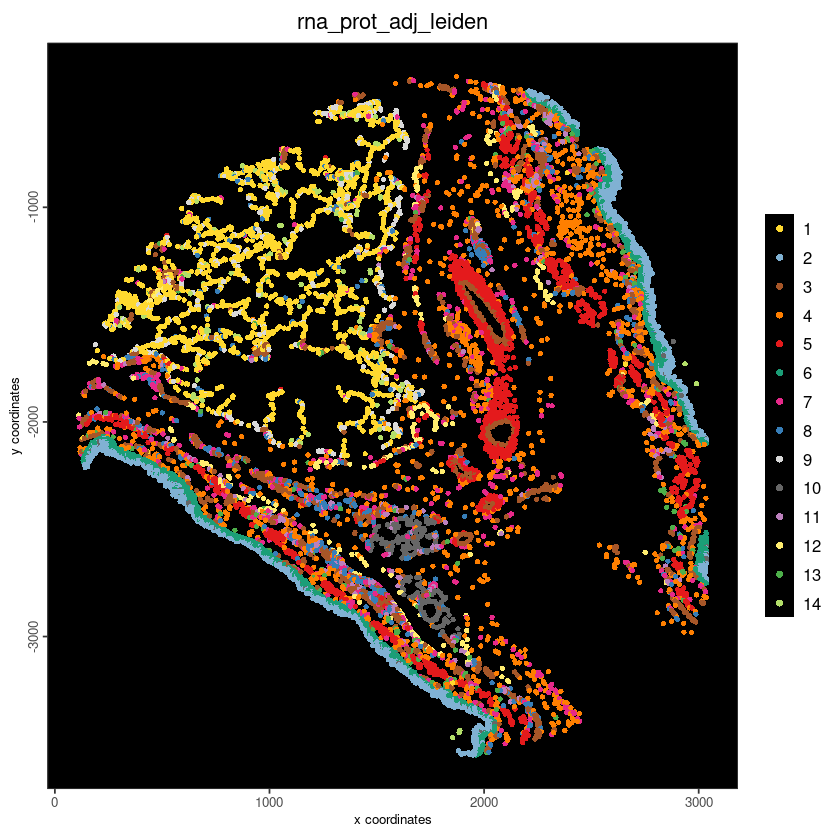

In [173]:
spatPlot2D(xen1,
    feat_type = "rna",
    cell_color = "rna_prot_adj_leiden",
    point_size = 1.5,
    point_border_stroke = 0,
    background_color = "black"
)

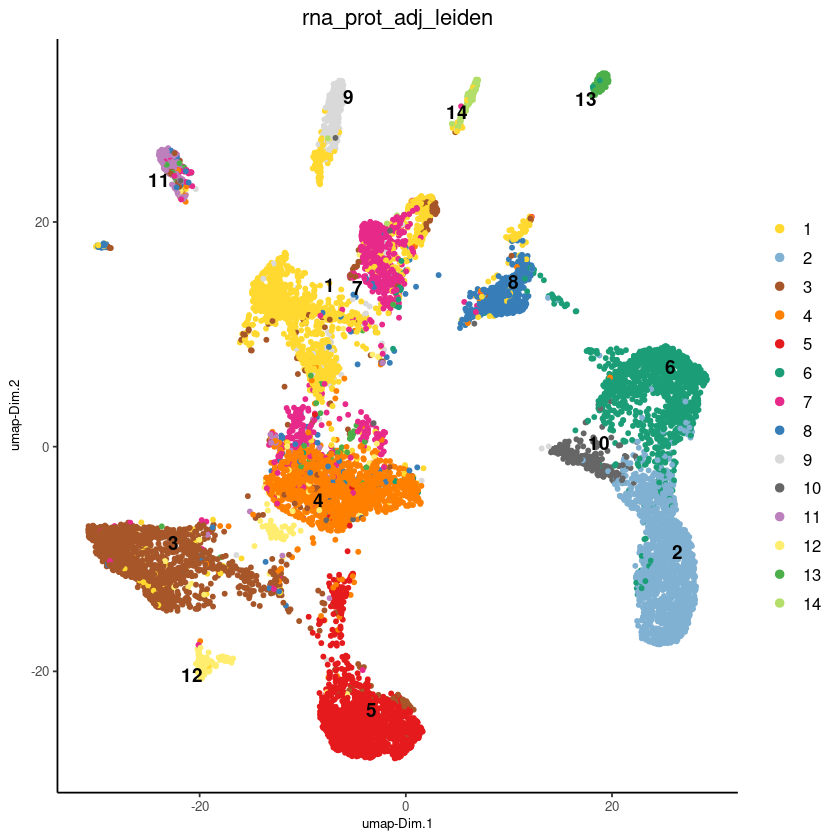

In [174]:
plotUMAP(xen1,
    feat_type = "rna",
    cell_color = "rna_prot_adj_leiden",
    point_shape = "no_border"
)

Getting values from [ucs][rna] cell metadata



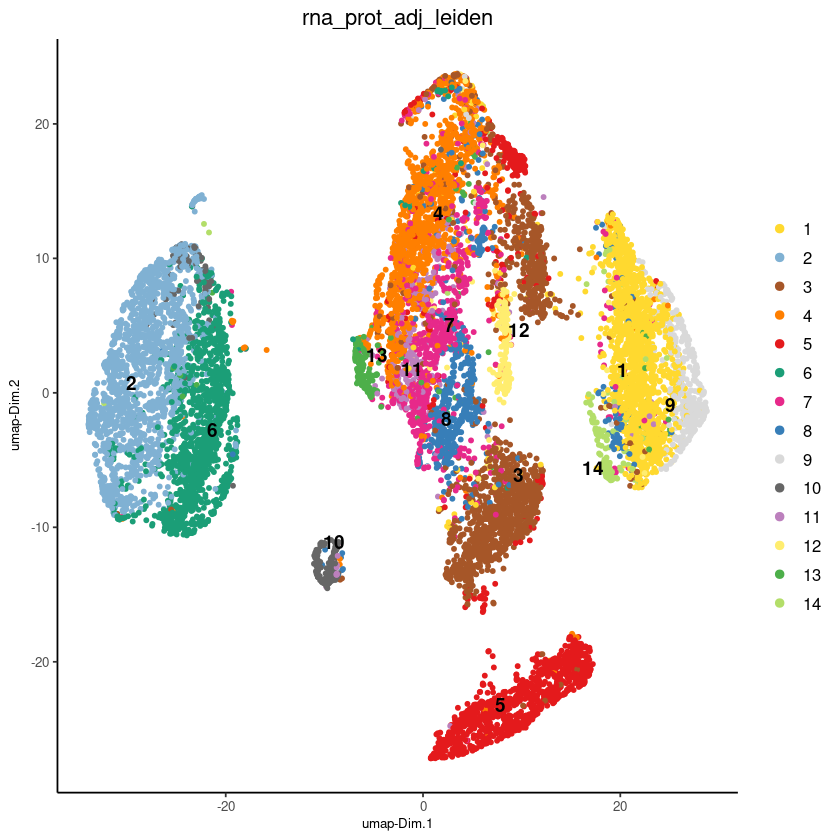

In [175]:
# transfer annotations to "protein" feat_type for visualization
cx <- spatValues(xen1, feats = c("rna_prot_adj_leiden"), feat_type = "rna")
xen1 <- addCellMetadata(xen1,
    spat_unit = "ucs",
    feat_type = "protein",
    new_metadata = cx,
    by_column = TRUE,
    column_cell_ID = "cell_ID"
)

plotUMAP(xen1,
    feat_type = "protein",
    cell_color = "rna_prot_adj_leiden",
    point_shape = "no_border"
)

An object of class nnNetObj : "rna_prot_knn_a0.8"
--| Contains nearest neighbor network generated with: kNN 
----| for feat_type: rna 
----|     spat_unit: ucs 
----|     provenance: ucs 

IGRAPH 68707f3 UNW- 11817 233496 -- 
+ attr: name (v/c), weight (e/n)
+ edges from 68707f3 (vertex names):
 [1] cell_1 --cell_13335 cell_1 --cell_1495  cell_1 --cell_1506 
 [4] cell_1 --cell_1507  cell_1 --cell_1508  cell_1 --cell_1728 
 [7] cell_1 --cell_466   cell_1 --cell_4980  cell_1 --cell_4996 
[10] cell_1 --cell_4997  cell_1 --cell_5001  cell_1 --cell_5269 
[13] cell_1 --cell_5275  cell_1 --cell_5279  cell_1 --cell_5284 
[16] cell_1 --cell_7149  cell_1 --cell_94    cell_1 --cell_95   
[19] cell_10--cell_10055 cell_10--cell_10780 cell_10--cell_10838
[22] cell_10--cell_11246 cell_10--cell_11276 cell_10--cell_11395
+ ... omitted several edges



Setting nearest neighbor network [ucs][rna] rna_prot_knn_a0.8

Warning message in FUN(X[[i]], ...):
“spat_unit: ucs feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”
Warning message in FUN(X[[i]], ...):
“spat_unit: hex_niche feat_type: rna name: celltypes_niche
 Spatial enrichment IDs are not all found in gobject
 IDs”


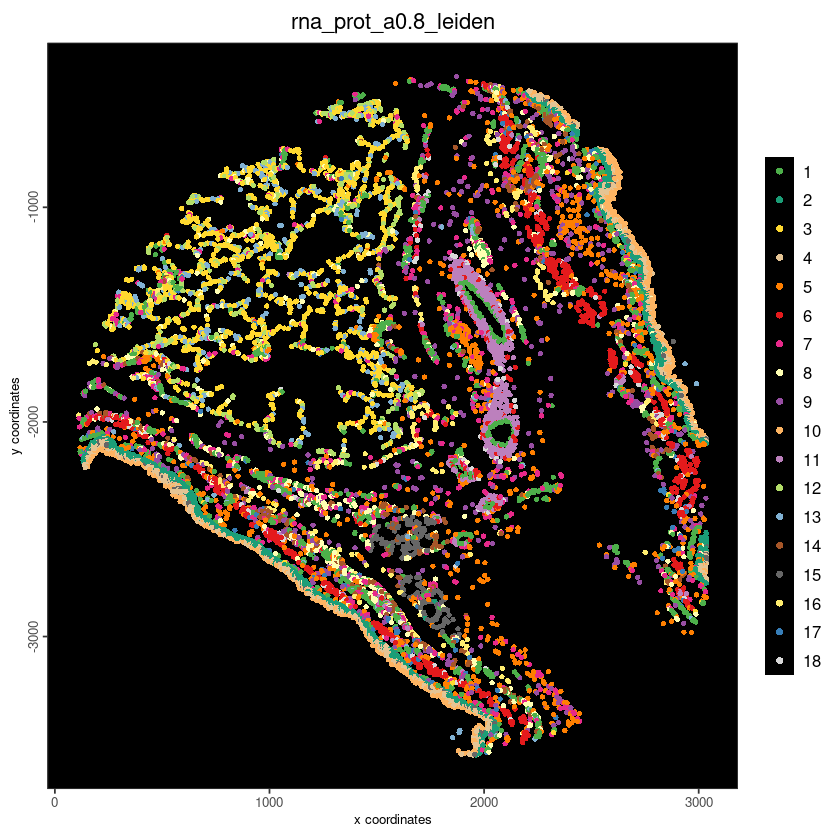

In [176]:
comb_knn_a0.8 <- merge_weighted_nn(knn_rna[], knn_prot[], alpha = 0.8)

d_comb_a0.8 <- knn_rna
d_comb_a0.8[] <- comb_knn_a0.8
objName(d_comb_a0.8) <- "rna_prot_knn_a0.8"
d_comb_a0.8

xen1 <- setGiotto(xen1, d_comb_a0.8)

xen1 <- doLeidenCluster(xen1,
    feat_type = "rna",
    resolution = 1.6,
    n_iterations = 100,
    nn_network_to_use = "kNN",
    network_name = "rna_prot_knn_a0.8",
    name = "rna_prot_a0.8_leiden"
)

spatPlot2D(xen1,
    feat_type = "rna",
    cell_color = "rna_prot_a0.8_leiden",
    point_size = 1.5,
    point_border_stroke = 0,
    background_color = "black"
)

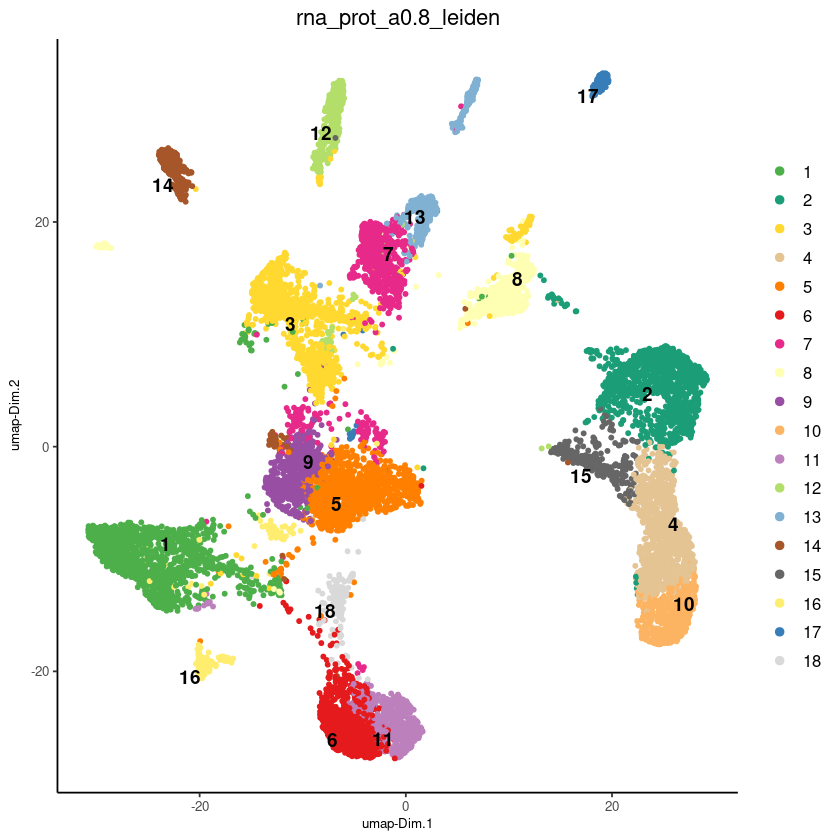

In [177]:
plotUMAP(xen1,
    feat_type = "rna",
    cell_color = "rna_prot_a0.8_leiden",
    point_shape = "no_border"
)

Getting values from [ucs][rna] cell metadata



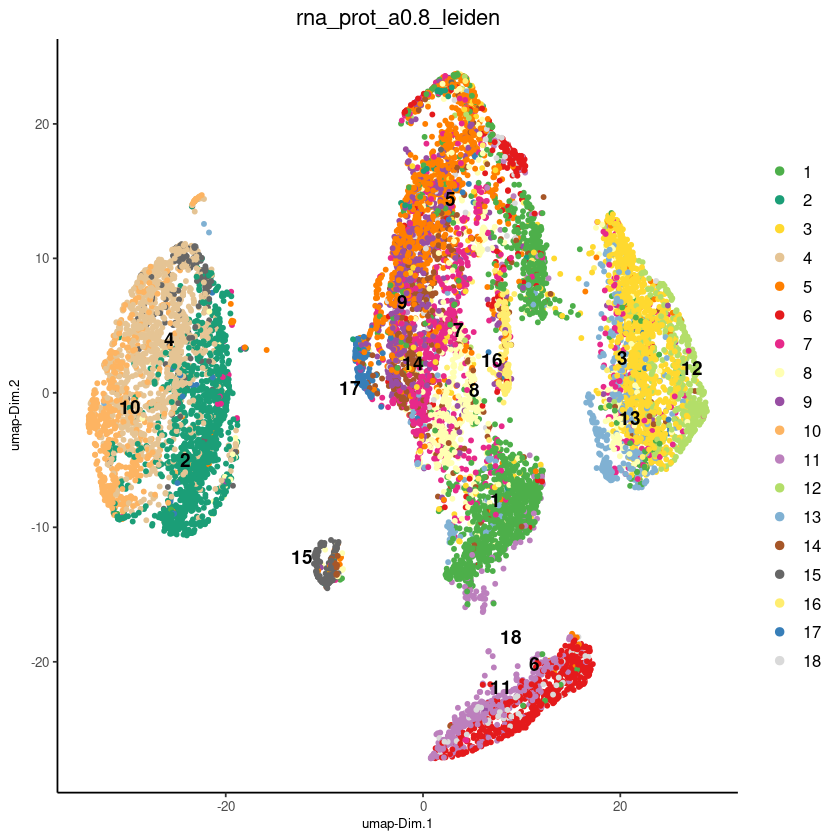

In [178]:
# transfer annotations to "protein" feat_type for visualization
cx <- spatValues(xen1, feats = c("rna_prot_a0.8_leiden"), feat_type = "rna")
xen1 <- addCellMetadata(xen1,
    spat_unit = "ucs",
    feat_type = "protein",
    new_metadata = cx,
    by_column = TRUE,
    column_cell_ID = "cell_ID"
)

plotUMAP(xen1,
    feat_type = "protein",
    cell_color = "rna_prot_a0.8_leiden",
    point_shape = "no_border"
)

## Saving

In [179]:
xen1 <- addSpatialCentroidLocationsLayer(xen1,
    poly_info = "ucs",
    feat_type = NULL,
    provenance = "ucs",
    spat_loc_name = "raw",
    return_gobject = TRUE
)

> spatial locations for polygon information layer " ucs " and name " raw "
 already exists and will be replaced



In [182]:
saveGiotto(xen1,
    dir = output_dir,
    foldername = "region1_gobject",
    export_image = FALSE, 
    image_filetype = "COG", 
    include_feat_coord = TRUE
)

1. Start writing feature information

For feature: rna

For feature: NegControlProbe

For feature: UnassignedCodeword

For feature: NegControlCodeword

For feature: DeprecatedCodeword

2. Start writing spatial information

For spatial information: cell

For spatial information: nucleus

For spatial information: ucs

For spatial information: hex_niche

For spatial information: selections

3. Start writing image information



In [183]:
vect("session3_outputs/region1_gobject/SpatialInfo/nucleus_spatInfo_spatVector.shp")

 class       : SpatVector 
 geometry    : polygons 
 dimensions  : 14168, 2  (geometries, attributes)
 extent      : 110.7125, 3037.05, -3577.65, -117.9375  (xmin, xmax, ymin, ymax)
 source      : nucleus_spatInfo_spatVector.shp
 coord. ref. :  
 names       :   poly_ID cell_poly_
 type        :     <chr>      <chr>
 values      : nucleus_1 aaaaicnd-1
               nucleus_2 aaaiciie-1
               nucleus_3 aaaodfkf-1

# Processing multiple samples

Most convenient to start the analysis with a fresh object since there are many more pieces of data already present in xen1 without a counterpart

In [184]:
r1 <- createGiottoXeniumObject(xen1_path,
    feat_type = c(
        "rna",
        "NegControlProbe",
        "UnassignedCodeword",
        "NegControlCodeword",
        "DeprecatedCodeword"
    ),
    split_keyword = list(
        "NegControlProbe",
        "UnassignedCodeword",
        "NegControlCodeword",
        "DeprecatedCodeword"
    ),
    load_images = NULL,
    instructions = instrs
)

r7 <- createGiottoXeniumObject(xen7_path,
    feat_type = c(
        "rna",
        "NegControlProbe",
        "UnassignedCodeword",
        "NegControlCodeword",
        "DeprecatedCodeword"
    ),
    split_keyword = list(
        "NegControlProbe",
        "UnassignedCodeword",
        "NegControlCodeword",
        "DeprecatedCodeword"
    ),
    load_images = NULL,
    instructions = instrs
)

ucs7_path <- file.path(data_path, "giotto_premade", "segmentation_mask_7.tif")
ucs7 <- createGiottoPolygon(ucs7_path,
    shift_vertical_step = -1, # shift into the negatives like the Xenium dataset
    name = "ucs" # name to assign the spat_unit that this will define
)

r1 <- setGiotto(r1, ucs1)
r7 <- setGiotto(r7, ucs7)

r1 <- calculateOverlapRaster(r1,
    spatial_info = "nucleus",
    feat_info = "rna")
r1 <- overlapToMatrix(r1,
    poly_info = "nucleus",
    feat_info = "rna",
    name = "raw")

r7 <- calculateOverlapRaster(r7,
    spatial_info = "nucleus",
    feat_info = "rna")
r7 <- overlapToMatrix(r7,
    poly_info = "nucleus",
    feat_info = "rna",
    name = "raw")


Loading transcript level info...

QV cutoff: 20.000000
 Feature points removed: 141742, out of 1044541

Loading boundary info 'cell'

Warning message in `[.data.table`(spatial_info, , `:=`((part_col), NULL)):
“Tried to assign NULL to column 'label_id', but this column does not exist to remove”
Loading boundary info 'nucleus'

Warning message in `[.data.table`(spatial_info, , `:=`((part_col), NULL)):
“Tried to assign NULL to column 'label_id', but this column does not exist to remove”
Loading feature metadata...

calculating centroids

done

Loading transcript level info...

QV cutoff: 20.000000
 Feature points removed: 284838, out of 1885633

Loading boundary info 'cell'

Warning message in `[.data.table`(spatial_info, , `:=`((part_col), NULL)):
“Tried to assign NULL to column 'label_id', but this column does not exist to remove”
Loading boundary info 'nucleus'

Warning message in `[.data.table`(spatial_info, , `:=`((part_col), NULL)):
“Tried to assign NULL to column 'label_id', but th

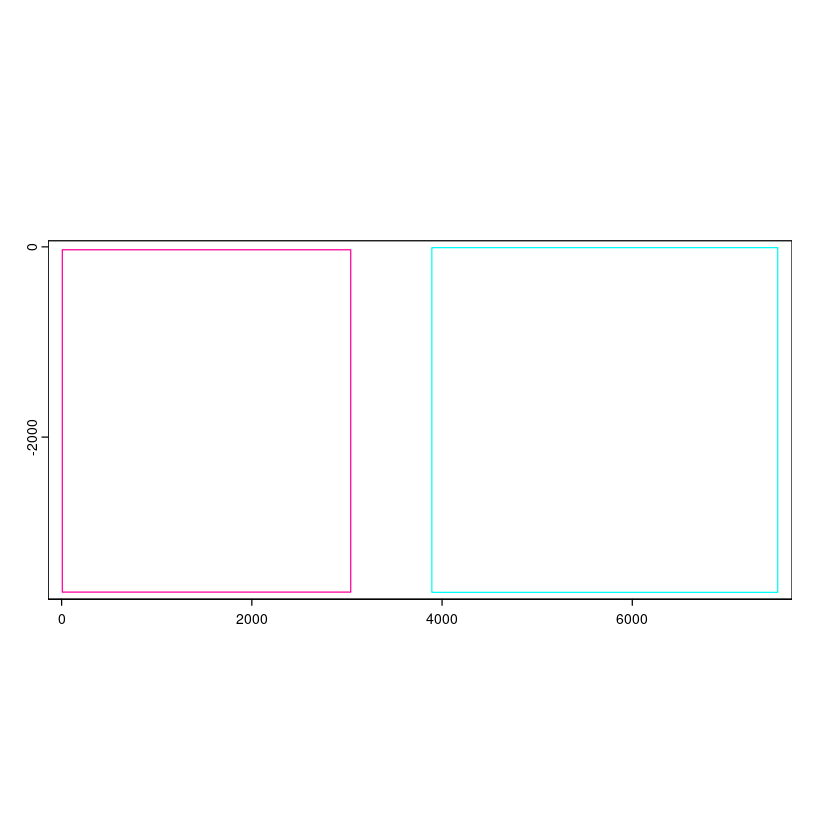

In [185]:
joinGiottoObjects(gobject_list = list(r1, r7),
    gobject_names = c("r1", "r7"),
    join_method = "shift",
    x_padding = 250, 
    dry_run = TRUE
)

In [186]:
combined_regions <- joinGiottoObjects(gobject_list = list(r1, r7),
    gobject_names = c("r1", "r7"),
    join_method = "shift",
    x_padding = 250, 
    dry_run = FALSE
)

Warning message in FUN(X[[i]], ...):
“spat_unit: nucleus spatloc name: raw
 cell IDs in spatial locations are missing from spatial
 polygon info”


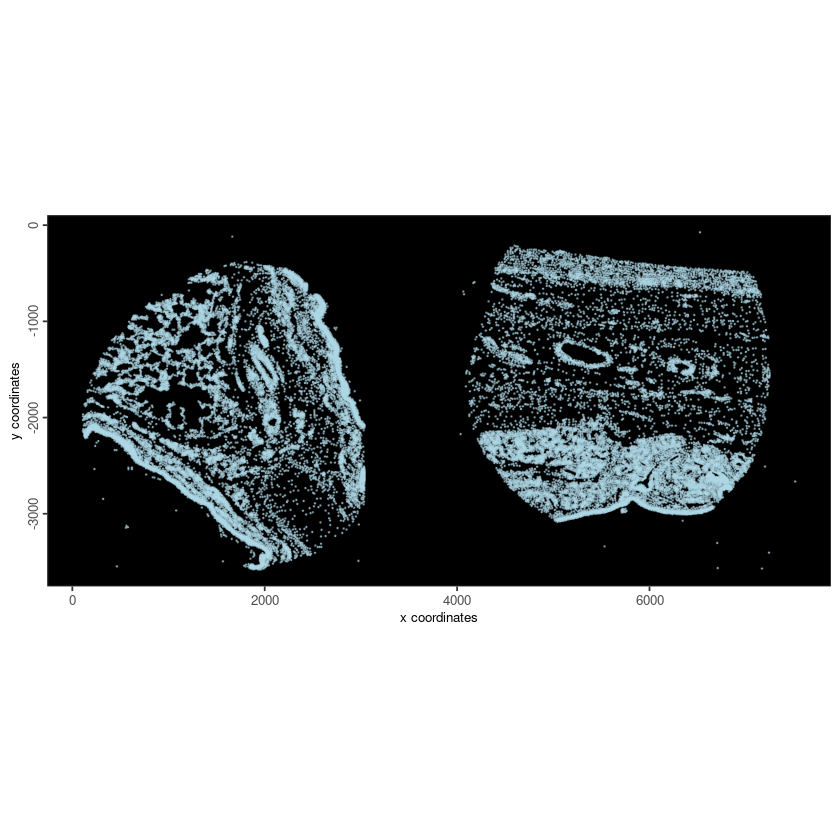

In [187]:
spatPlot2D(gobject = combined_regions,
    point_size = 0.1,
    point_alpha = 0.5,
    point_shape = "no_border",
    background_color = "black"
)

In [188]:
# processing ####
g <- combined_regions # simplify naming
activeSpatUnit(g)

[1] "cell"

In [189]:
# feature aggregation
g <- calculateOverlap(g)
g <- overlapToMatrix(g)

1. convert polygon to raster

2. overlap raster and points

3. add polygon information

4. add points information

5. create overlap polygon
 information

Warning message in FUN(X[[i]], ...):
“spat_unit: nucleus spatloc name: raw
 cell IDs in spatial locations are missing from spatial
 polygon info”
Warning message in FUN(X[[i]], ...):
“spat_unit: nucleus spatloc name: raw
 cell IDs in spatial locations are missing from spatial
 polygon info”


In [190]:
#      data processing ####
g <- filterGiotto(g, #filters > 1000 cells
    expression_threshold = 1,
    feat_det_in_min_cells = 10,
    min_det_feats_per_cell = 10
)

# Feature type:  rna 
# Number of cells removed:  1099  out of  14168 
# Number of feats removed:  1  out of  289 

g <- normalizeGiotto(g, 
    norm_methods = "standard", # default 
    library_size_norm = TRUE, # default 
    scalefactor = 6000, # default 
    log_norm = TRUE) # default 

g <- addStatistics(g)

completed 1: preparation

completed 2: subset expression data

completed 3: subset spatial locations

completed 4: subset cell metadata

completed 5: subset feature metadata

completed 6: subset spatial network(s)

completed 7: subsetted dimension reductions

completed 8: subsetted nearest network(s)

completed 9: subsetted spatial enrichment results

for cell

--> cell found back in polygon layer: cell

for nucleus

for ucs

completed 10: subsetted spatial information data

subset feature info: rna

completed 11: subsetted spatial feature data

Warning message in FUN(X[[i]], ...):
“spat_unit: nucleus spatloc name: raw
 cell IDs in spatial locations are missing from spatial
 polygon info”



Feature type:  rna 
Number of cells removed:  2329  out of  27474 
Number of feats removed:  0  out of  289 


first scale feats and then cells

Setting expression [cell][rna] normalized

Setting expression [cell][rna] scaled

Warning message in FUN(X[[i]], ...):
“spat_unit: nucleus spatloc name: raw
 cell IDs in spatial locations are missing from spatial
 polygon info”
calculating statistics for "normalized" expression



plot polygon layer done



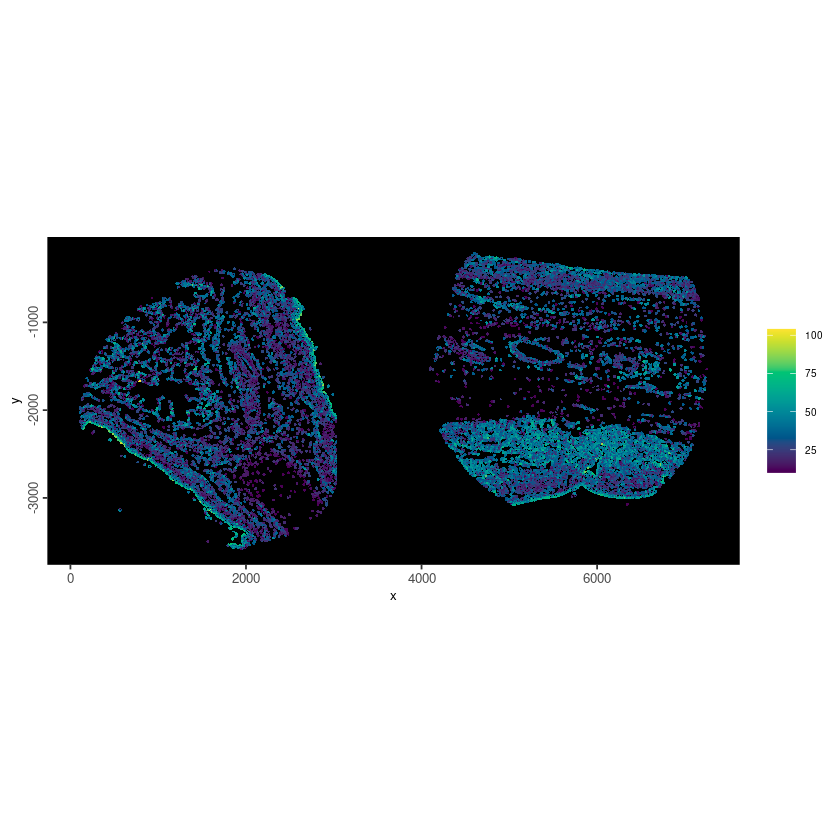

In [191]:
spatInSituPlotPoints(g,
    polygon_fill = "nr_feats",
    polygon_fill_gradient_style = "sequential",
    polygon_fill_as_factor = FALSE, 
    polygon_color = "grey",
    polygon_line_size = 0
) #nr_feats: number of different gene species detected per cell

plot polygon layer done



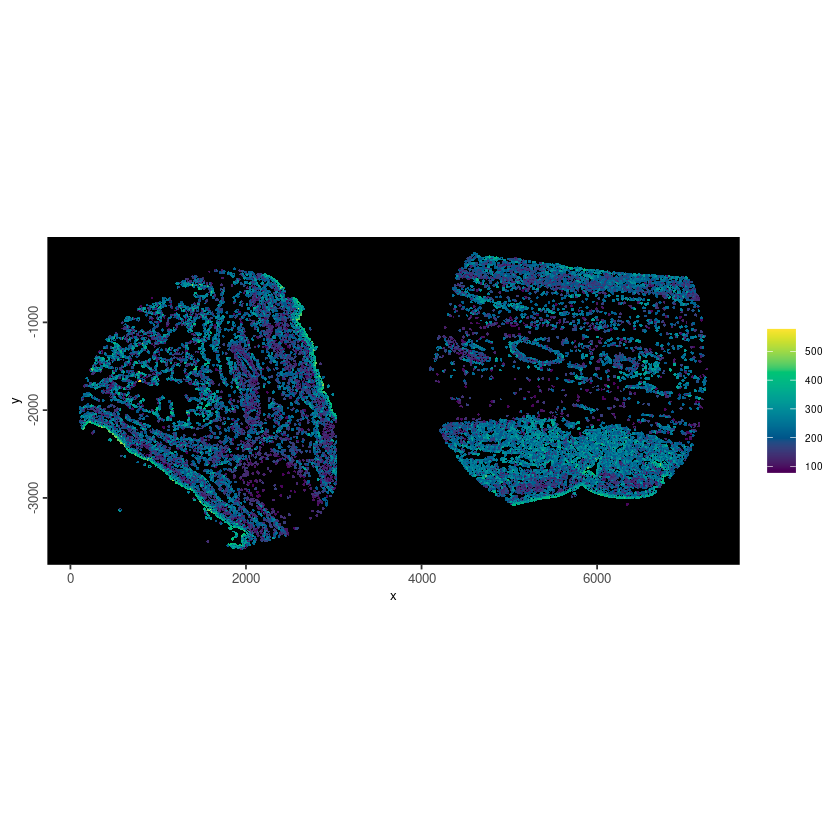

In [192]:
spatInSituPlotPoints(g,
    polygon_fill = "total_expr",
    polygon_fill_gradient_style = "sequential",
    polygon_fill_as_factor = FALSE, 
    polygon_color = "grey",
    polygon_line_size = 0
) #total_expr: total detections per cell

Setting dimension reduction [cell][rna] pca

Warning message in FUN(X[[i]], ...):
“spat_unit: nucleus spatloc name: raw
 cell IDs in spatial locations are missing from spatial
 polygon info”
PCA with name: pca already exists and will be used for the screeplot



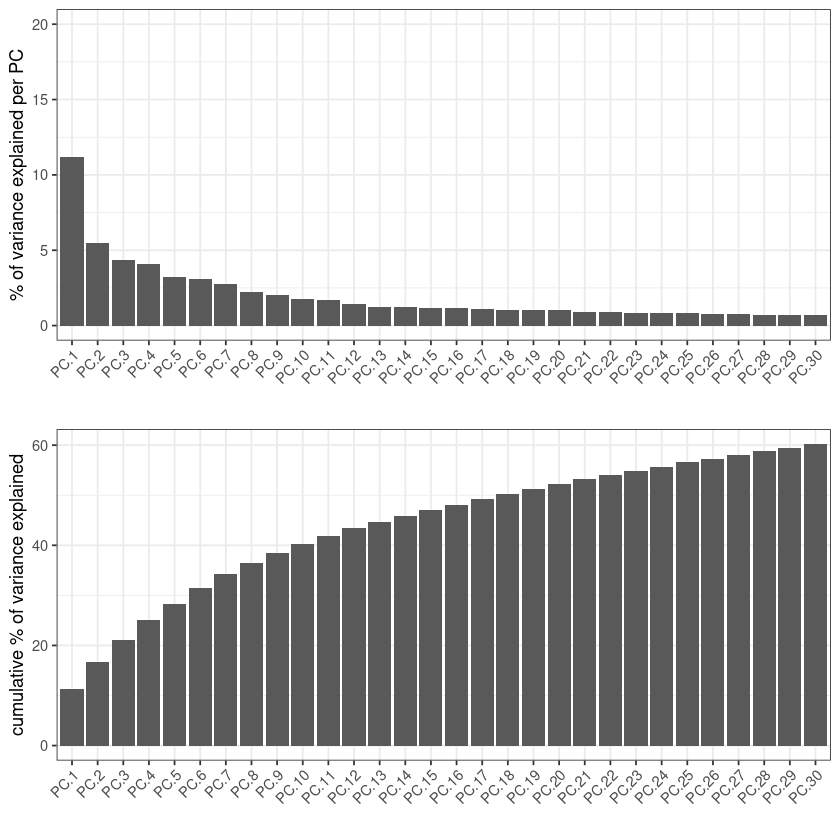

In [193]:
#      dimension reduction ####
g <- runPCA(g, 
    expression_values = "normalized", # default
    feats_to_use = NULL
)

screePlot(g, ncp = 30)
# feats_to_use = NULL since there are no HVFs calculated. Use all genes.

In [194]:
g <- runUMAP(g, 
    dimensions_to_use = seq(15), 
    n_neighbors = 40, # default
    min_dist = 0.01, # default
    spread = 5 # default
)

Setting dimension reduction [cell][rna] umap

Warning message in FUN(X[[i]], ...):
“spat_unit: nucleus spatloc name: raw
 cell IDs in spatial locations are missing from spatial
 polygon info”


In [195]:
#      clustering ####
g <- createNearestNetwork(g,
    type = "sNN", # default 
    dim_reduction_to_use = "pca", # default 
    dimensions_to_use = seq(15), 
    k = 30, 
    minimum_shared = 5, # default 
    top_shared = 3 # default 
)

g <- doLeidenCluster(g, 
    nn_network_to_use = "sNN", # default 
    resolution = 0.6,
    n_iterations = 100
) 

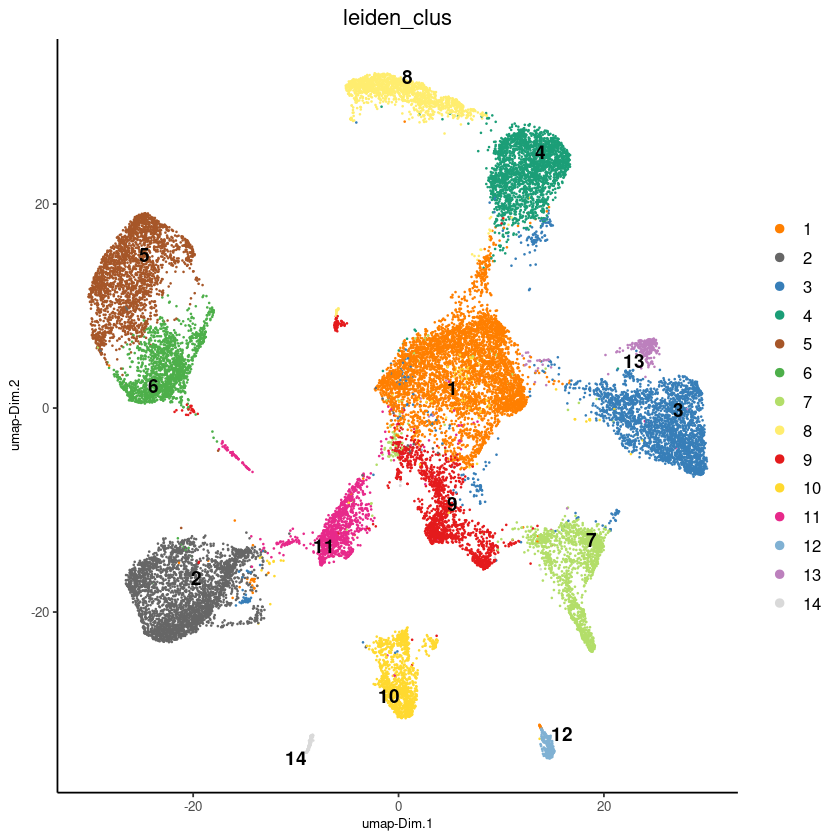

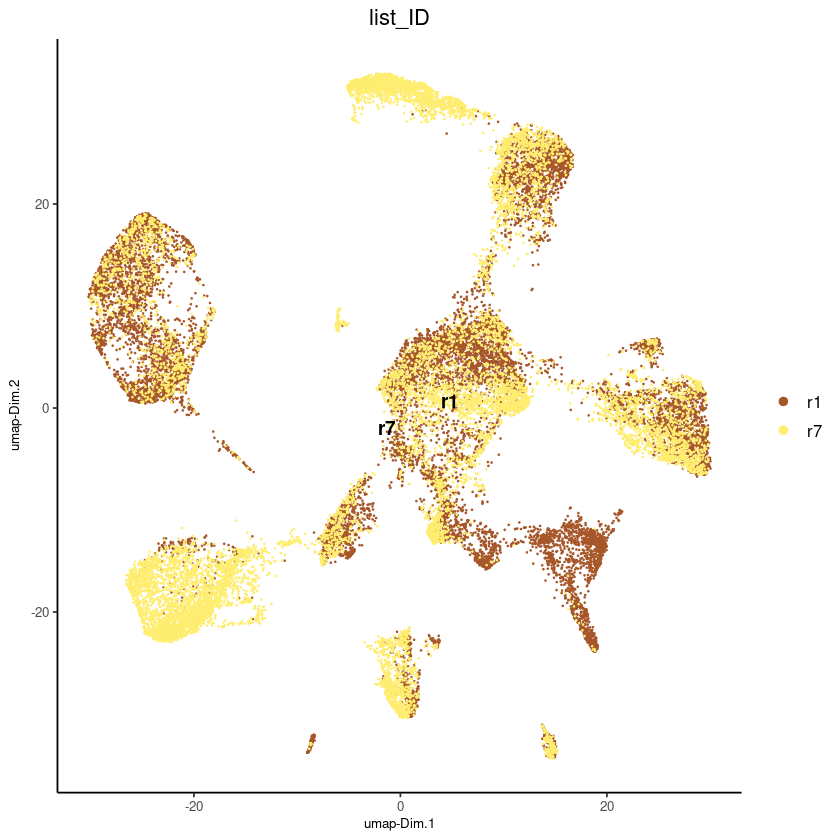

In [196]:
# leiden clustering results
plotUMAP(g, 
    cell_color = "leiden_clus", 
    point_size = 0.1, 
    point_shape = "no_border"
)

# check for batch effect between cores
plotUMAP(g, 
    cell_color = "list_ID", 
    point_size = 0.1, 
    point_shape = "no_border"
)

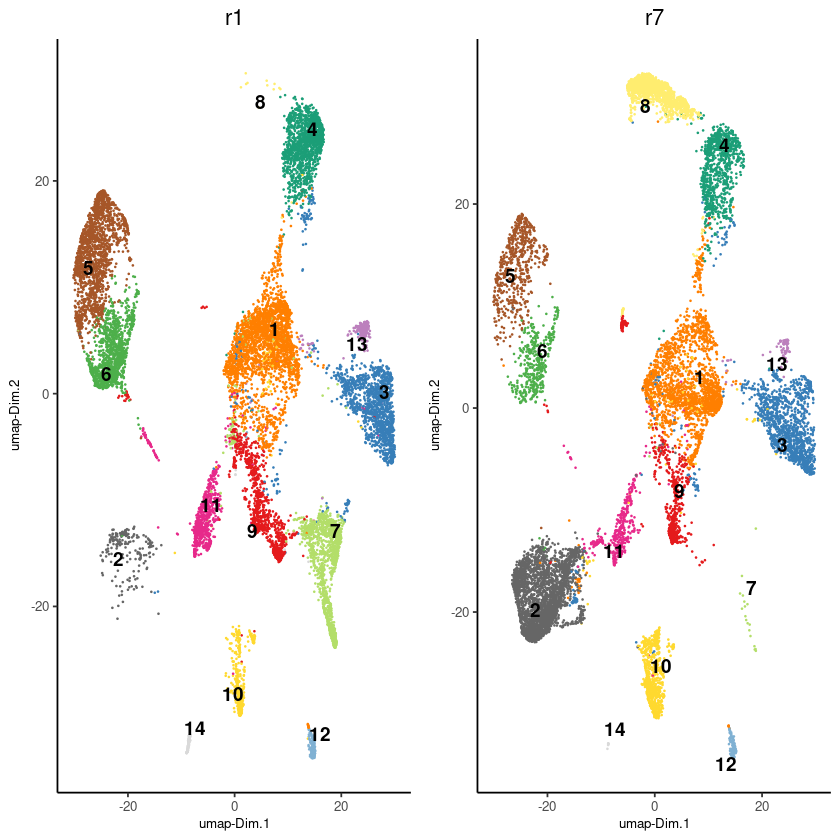

In [197]:
# side by side plotting with group_by
plotUMAP(g, 
    cell_color = "leiden_clus", 
    group_by = "list_ID", 
    point_size = 0.1, 
    point_shape = "no_border",
    show_legend = FALSE
)

plot polygon layer done



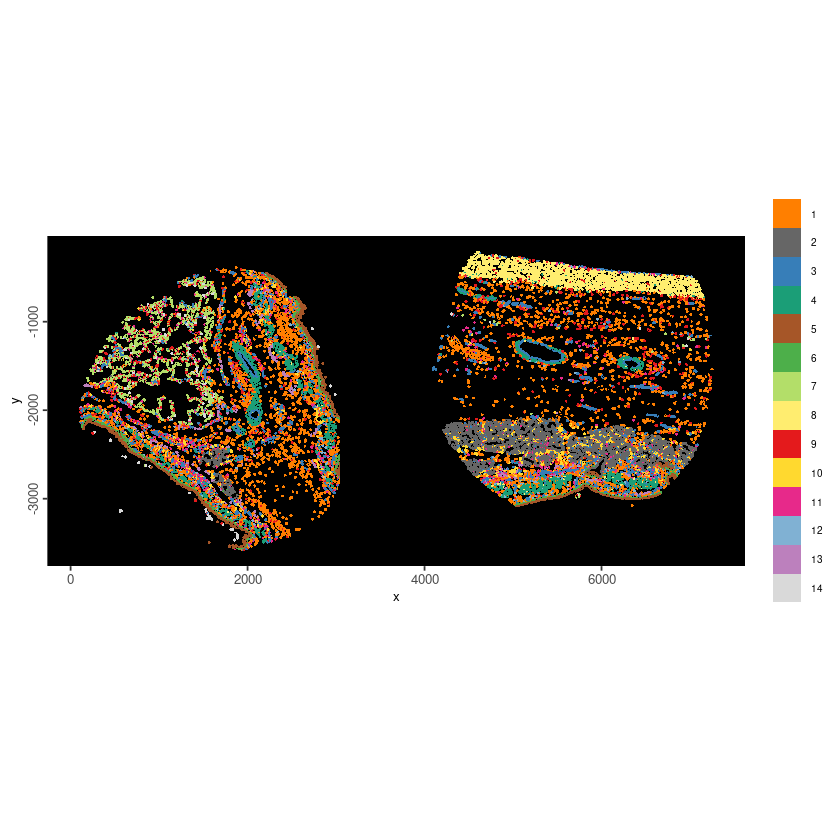

In [198]:
spatInSituPlotPoints(g,
    polygon_fill = "leiden_clus",
    polygon_fill_as_factor = TRUE,
    polygon_alpha = 1,
    polygon_color = "grey",
    polygon_line_size = 0, 
    show_image = FALSE
)